# ACTIVSg grid buildout Part2

#### grid buildouts for stochastic dispatch
* conda env: buildouts
* tamu 200 buildout entire pipeline
* functionality of adding of new generators
* start with all_cf_df.csv (created in part1) in run_dir. e.g.,
* /projects/exasgd/isatkaus/buildout/wind/wind_gen_tamu5/


#### other helpful notebooks:

* precursor to this notebook:
* /user/isatkaus/notebooks/projects/ecp/powerscenarios/notebooks/eagle_dev/tamu200_buildout_part2.ipynb
* generator/load analysis:
* /user/isatkaus/notebooks/projects/ecp/powerscenarios/notebooks/eagle_dev/tamu200_generator_connections.ipynb
* to generate scenarios using buildout grid use:
* buildout_scenarios_v2.ipynb

In [1]:
import os
from reV import TESTDATADIR
from reV.config.project_points import ProjectPoints
from reV.generation.generation import Gen

import numpy as np
import matplotlib.pyplot as plt
import json


import rex
from rex import Resource

import h5py
import glob

In [2]:
import pandas as pd
import numpy as np
import time
import os
import random

# # set PYWTK_CACHE_DIR to locate WIND Toolkit data
# # will download from AWS as needed
# os.environ["PYWTK_CACHE_DIR"] = os.path.join(os.environ["HOME"], "pywtk-data")

from powerscenarios.parser import Parser
from powerscenarios.grid import Grid

# show multiple cell outputs
from IPython.core.interactiveshell import InteractiveShell

InteractiveShell.ast_node_interactivity = "all"

pd.set_option("display.max_rows", 8)
pd.set_option("display.max_columns", 30)

# plotting (optional)
import cufflinks as cl

cl.go_offline()

In [3]:
# voronoi
from shapely.ops import cascaded_union, unary_union
from geovoronoi.plotting import subplot_for_map, plot_voronoi_polys_with_points_in_area
from geovoronoi import voronoi_regions_from_coords, points_to_coords

In [4]:
### packages for viz

import geopandas as gpd
import contextily as ctx
import matplotlib.pyplot as plt
import shapely

# same as above but using shapely.Point
from shapely.geometry import Point, LineString, Polygon

#### below 3 cells are optional
* autoreload: re-imports packages if package was changed (no need to restart kernel)
* nb_black/jupyter_black: autoformats code 

In [5]:
%load_ext autoreload

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [9]:
import black
import jupyter_black

# jupyter_black.load()

jupyter_black.load(
    lab=False,
    line_length=79,
    verbosity="DEBUG",
    # target_version=black.TargetVersion.PY310,
)

In [113]:
320 * 0.05

16.0

In [10]:
# %load_ext nb_black
# %load_ext jupyter_black


* Select grid
<a id='select_grid'></a>

[Capacity factors](#capacity_factors)

# load TAMU grid data

* choose TAMU grid
* grid files can be downloaded from:
* https://electricgrids.engr.tamu.edu/electric-grid-test-cases/

In [11]:
grid_name = "ACTIVSg200"  # TAMU 200 bus case
# grid_name = "ACTIVSg2000"  # TAMU 2000 bus case
# grid_name = 'ACTIVSg10k' # TAMU 10000 bus case

# path to .aux file (TAMU grids) obtained from e.g.
# https://electricgrids.engr.tamu.edu/electric-grid-test-cases/activsg200/
# data_dir = "../../data/grid-data/"
data_dir = "/projects/hpcapps/isatkaus/grid-buildouts-data/grid-data/"
# aux_file_name = data_dir + grid_name + "/" + grid_name + ".aux"
aux_file_name = os.path.join(data_dir, grid_name, grid_name + ".aux")

# parse original .aux file and return dataframes for buses, generators, and wind generators
# here, we need .aux files because those are the only ones with Latitute/Longitude information
parser = Parser()
bus_df, gen_df, wind_gen_df = parser.parse_tamu_aux(aux_file_name)

# see what you got
print("bus_df:")
bus_df
print("gen_df:")
gen_df
print("wind_gen_df:")
wind_gen_df

grid = Grid(grid_name, bus_df, gen_df, wind_gen_df)
grid
print(grid.info())


# branches
# m_filename = data_dir + "/grid-data/" + grid_name + "/case_" + grid_name + ".m"
m_filename = os.path.join(data_dir + grid_name + "/case_" + grid_name + ".m")

# read branch table from scenarios_m_file
table_name = "mpc.branch"
column_names = [
    "fbus",
    "tbus",
    "r",
    "x",
    "b",
    "rateA",
    "rateB",
    "rateC",
    "ratio",
    "angle",
    "status",
    "angmin",
    "angmax",
    "Pf",
    "Qf",
    "Pt",
    "Qt",
    "mu_Sf",
    "mu_St",
    "mu_angmin",
    "mu_angmax",
]

# this table is entirely numeric
numeric_columns = column_names

branch_df = parser.read_m_table(
    m_filename,
    table_name=table_name,
    column_names=column_names,
    numeric_columns=numeric_columns,
)


# rename a few columns to match branch drawing script
branch_df.index.rename("UID", inplace=True)
branch_df.rename(columns={"fbus": "FromBus", "tbus": "ToBus"}, inplace=True)
print("\nbranch_df")
branch_df


# ############usts data
# usts_data_dir = "/Users/isatkaus/projects/ecp/powerscenarios/data/grid-data/USATestSystem/formatted/"

# filename = os.path.join(usts_data_dir, "branch.csv")
# branch_df = pd.read_csv(filename, index_col=0)
# print("\nbranch_df")
# branch_df

bus_df:


,BusNum,BusName,Latitude,Longitude,Zone
0,1,CREVECOEUR0,40.642116,-89.599560,2
1,2,CREVECOEUR1,40.642116,-89.599560,2
2,3,ILLIOPOLIS0,39.866030,-89.251291,4
3,4,ILLIOPOLIS1,39.866030,-89.251291,4
...,...,...,...,...,...
196,197,GIBSONCITY12,40.470500,-88.398700,6
197,198,MAPLETON0,40.556403,-89.762073,2
198,199,GIFFORD0,40.306027,-87.958606,6
199,200,PETERSBURG0,40.169931,-89.986537,4


gen_df:


,BusNum,GenID,GenMWMax,GenMWMin,GenWindPowerFactor,GenFuelType,GenUID,BusName,Latitude,Longitude,Zone
0,49,1,4.530000,1.360000,1.0,Coal,49_Coal_1,RANTOUL21,40.312222,-88.159444,6
1,50,1,4.530000,1.360000,1.0,Coal,50_Coal_1,RANTOUL22,40.312222,-88.159444,6
2,51,1,4.530000,1.360000,1.0,Coal,51_Coal_1,RANTOUL23,40.312222,-88.159444,6
3,52,1,4.530000,1.360000,1.0,Coal,52_Coal_1,RANTOUL24,40.312222,-88.159444,6
...,...,...,...,...,...,...,...,...,...,...,...
45,183,1,26.600000,7.980000,1.0,Coal,183_Coal_1,SPRINGFIELD22,39.806868,-89.641653,4
46,189,1,569.150019,170.749998,1.0,Nuclear,189_Nuclear_1,CLINTON12,40.171900,-88.833900,7
47,196,1,67.500001,20.250000,1.0,NaturalGas,196_NaturalGas_1,GIBSONCITY11,40.470500,-88.398700,6
48,197,1,67.500001,20.250000,1.0,NaturalGas,197_NaturalGas_1,GIBSONCITY12,40.470500,-88.398700,6


wind_gen_df:


,BusNum,GenID,GenMWMax,GenMWMin,GenWindPowerFactor,GenFuelType,GenUID,BusName,Latitude,Longitude,Zone
0,65,1,150.399995,45.120001,1.0,Wind,65_Wind_1,PAXTON11,40.46405,-88.021517,6
1,104,1,99.000001,29.699999,1.0,Wind,104_Wind_1,ELLSWORTH12,40.47920,-88.798900,7
2,105,1,198.000002,59.400004,1.0,Wind,105_Wind_1,ELLSWORTH13,40.47920,-88.798900,7
3,114,1,1.700000,0.510000,1.0,Wind,114_Wind_1,NORMAL22,40.53700,-89.019000,7
4,115,1,150.000000,44.999999,1.0,Wind,115_Wind_1,NORMAL23,40.53700,-89.019000,7
5,147,1,100.500000,30.149999,1.0,Wind,147_Wind_1,HOPEDALE21,40.36920,-89.402200,7


Grid(name=ACTIVSg200, buses=200, generators=49, wind_generators=6, wind_sites=0)


ACTIVSg200 grid info: 

 number of buses: 200
 number of generators: 49
 number of wind generators: 6
 number of solar generators: 0
 total generator capacity: 3602.84 MW
 wind capacity/penetration: 699.60 MW / 19.42%
 solar capacity/penetration: 0.00 MW / 0.00%

branch_df


,FromBus,ToBus,r,x,b,rateA,rateB,rateC,ratio,angle,status,angmin,angmax,Pf,Qf,Pt,Qt,mu_Sf,mu_St,mu_angmin,mu_angmax
UID,,,,,,,,,,,,,,,,,,,,,
0,2,1,0.000673,0.003339,0.00000,100.0,0,0,0,0,1,0,0,-7.39,-2.10,7.39,2.11,0.0,0.0,0.0,0.0
1,1,119,0.018542,0.119758,0.02285,221.1,0,0,0,0,1,0,0,12.25,-0.57,-12.22,-1.63,0.0,0.0,0.0,0.0
2,124,1,0.005615,0.036268,0.00692,221.1,0,0,0,0,1,0,0,40.13,7.94,-40.04,-8.08,0.0,0.0,0.0,0.0
3,193,1,0.004258,0.027501,0.00525,221.1,0,0,0,0,1,0,0,-20.39,-6.96,20.41,6.54,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
241,188,187,0.001394,0.044762,0.00000,400.0,0,0,1,0,1,0,0,-113.10,8.78,113.27,-3.48,0.0,0.0,0.0,0.0
242,189,187,0.000300,0.007815,0.00000,740.0,0,0,1,0,1,0,0,384.37,-24.15,-383.96,34.87,0.0,0.0,0.0,0.0
243,196,195,0.002850,0.060038,0.00000,87.7,0,0,1,0,1,0,0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0
244,197,195,0.002850,0.191484,0.00000,87.7,0,0,1,0,1,0,0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0


# remove old wind gens from original grid data
* save original data for later comparison
* remove existing wind gens from original grid - start from scratch
* will modify bus_df, gen_df, branch_df: add new buses, gens, branches
* will create new wind_gen_df

In [12]:
old_bus_df = bus_df.copy()
old_gen_df = gen_df.copy()
old_wind_gen_df = wind_gen_df.copy()
old_branch_df = branch_df.copy()

In [13]:
#################################################
#### remove old wind gen buses
#### re-number

old_bus_df
df = old_bus_df.copy()
df = df.set_index("BusNum", drop=True)

wind_gen_buses = old_gen_df.loc[gen_df["GenFuelType"] == "Wind"]["BusNum"]
wind_gen_buses.values

df.drop(wind_gen_buses.values, inplace=True)

### add new numbering starting with 1
df["NewBusNum"] = range(1, len(df) + 1)

### create map: old to new bus numbers (index=old, values=new)
bus_map_s = df["NewBusNum"]
print("\n bus number map series(old to new), bus_map")
bus_map_s

### set new index
df.set_index("NewBusNum", inplace=True)

bus_df = df.reset_index()
bus_df.rename(columns={"NewBusNum": "BusNum"}, inplace=True)
print("\n new bus_df:")
# df
bus_df

#################################################
#### remove old wind gen bus branches
#### map old BusNum in FromBus/ToBus columns to new bus numbers
old_branch_df
df = old_branch_df.copy()
### branches to remove
remove_idxs = df.loc[
    (df["FromBus"].isin(wind_gen_buses)) | (df["ToBus"].isin(wind_gen_buses))
].index
df.drop(remove_idxs, inplace=True)
print("\n removed branches: empty df?")
df.loc[df["FromBus"].isin(wind_gen_buses)]

### remap BusNum
df["FromBus"] = df["FromBus"].map(bus_map_s)
df["ToBus"] = df["ToBus"].map(bus_map_s)

### reset UID index
df.reset_index(inplace=True, drop=True)
df.index.name = "UID"

print("\n new branch_df:")
branch_df = df
branch_df

#################################################
#### remove old wind gen fron gen df
#### map old BusNum in FromBus/ToBus columns to new bus numbers
old_gen_df
df = old_gen_df.copy()
### gens to remove

remove_idxs = df.loc[df["BusNum"].isin(wind_gen_buses)].index
remove_idxs

df.drop(remove_idxs, inplace=True)
print("\n removed branches: empty df?")
df.loc[df["BusNum"].isin(wind_gen_buses)]

### remap BusNum
df["BusNum"] = df["BusNum"].map(bus_map_s)

### reset UID index
df.reset_index(inplace=True, drop=True)
# df.index.name = "UID"

print("\n new gen_df:")
gen_df = df
gen_df

,BusNum,BusName,Latitude,Longitude,Zone
0,1,CREVECOEUR0,40.642116,-89.599560,2
1,2,CREVECOEUR1,40.642116,-89.599560,2
2,3,ILLIOPOLIS0,39.866030,-89.251291,4
3,4,ILLIOPOLIS1,39.866030,-89.251291,4
...,...,...,...,...,...
196,197,GIBSONCITY12,40.470500,-88.398700,6
197,198,MAPLETON0,40.556403,-89.762073,2
198,199,GIFFORD0,40.306027,-87.958606,6
199,200,PETERSBURG0,40.169931,-89.986537,4


array([ 65, 104, 105, 114, 115, 147])


 bus number map series(old to new), bus_map


BusNum
1        1
2        2
3        3
4        4
      ... 
197    191
198    192
199    193
200    194
Name: NewBusNum, Length: 194, dtype: int64


 new bus_df:


,BusNum,BusName,Latitude,Longitude,Zone
0,1,CREVECOEUR0,40.642116,-89.599560,2
1,2,CREVECOEUR1,40.642116,-89.599560,2
2,3,ILLIOPOLIS0,39.866030,-89.251291,4
3,4,ILLIOPOLIS1,39.866030,-89.251291,4
...,...,...,...,...,...
190,191,GIBSONCITY12,40.470500,-88.398700,6
191,192,MAPLETON0,40.556403,-89.762073,2
192,193,GIFFORD0,40.306027,-87.958606,6
193,194,PETERSBURG0,40.169931,-89.986537,4


,FromBus,ToBus,r,x,b,rateA,rateB,rateC,ratio,angle,status,angmin,angmax,Pf,Qf,Pt,Qt,mu_Sf,mu_St,mu_angmin,mu_angmax
UID,,,,,,,,,,,,,,,,,,,,,
0,2,1,0.000673,0.003339,0.00000,100.0,0,0,0,0,1,0,0,-7.39,-2.10,7.39,2.11,0.0,0.0,0.0,0.0
1,1,119,0.018542,0.119758,0.02285,221.1,0,0,0,0,1,0,0,12.25,-0.57,-12.22,-1.63,0.0,0.0,0.0,0.0
2,124,1,0.005615,0.036268,0.00692,221.1,0,0,0,0,1,0,0,40.13,7.94,-40.04,-8.08,0.0,0.0,0.0,0.0
3,193,1,0.004258,0.027501,0.00525,221.1,0,0,0,0,1,0,0,-20.39,-6.96,20.41,6.54,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
241,188,187,0.001394,0.044762,0.00000,400.0,0,0,1,0,1,0,0,-113.10,8.78,113.27,-3.48,0.0,0.0,0.0,0.0
242,189,187,0.000300,0.007815,0.00000,740.0,0,0,1,0,1,0,0,384.37,-24.15,-383.96,34.87,0.0,0.0,0.0,0.0
243,196,195,0.002850,0.060038,0.00000,87.7,0,0,1,0,1,0,0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0
244,197,195,0.002850,0.191484,0.00000,87.7,0,0,1,0,1,0,0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0



 removed branches: empty df?


,FromBus,ToBus,r,x,b,rateA,rateB,rateC,ratio,angle,status,angmin,angmax,Pf,Qf,Pt,Qt,mu_Sf,mu_St,mu_angmin,mu_angmax
UID,,,,,,,,,,,,,,,,,,,,,



 new branch_df:


,FromBus,ToBus,r,x,b,rateA,rateB,rateC,ratio,angle,status,angmin,angmax,Pf,Qf,Pt,Qt,mu_Sf,mu_St,mu_angmin,mu_angmax
UID,,,,,,,,,,,,,,,,,,,,,
0,2,1,0.000673,0.003339,0.00000,100.0,0,0,0,0,1,0,0,-7.39,-2.10,7.39,2.11,0.0,0.0,0.0,0.0
1,1,114,0.018542,0.119758,0.02285,221.1,0,0,0,0,1,0,0,12.25,-0.57,-12.22,-1.63,0.0,0.0,0.0,0.0
2,119,1,0.005615,0.036268,0.00692,221.1,0,0,0,0,1,0,0,40.13,7.94,-40.04,-8.08,0.0,0.0,0.0,0.0
3,187,1,0.004258,0.027501,0.00525,221.1,0,0,0,0,1,0,0,-20.39,-6.96,20.41,6.54,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
235,182,181,0.001394,0.044762,0.00000,400.0,0,0,1,0,1,0,0,-113.10,8.78,113.27,-3.48,0.0,0.0,0.0,0.0
236,183,181,0.000300,0.007815,0.00000,740.0,0,0,1,0,1,0,0,384.37,-24.15,-383.96,34.87,0.0,0.0,0.0,0.0
237,190,189,0.002850,0.060038,0.00000,87.7,0,0,1,0,1,0,0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0
238,191,189,0.002850,0.191484,0.00000,87.7,0,0,1,0,1,0,0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0


,BusNum,GenID,GenMWMax,GenMWMin,GenWindPowerFactor,GenFuelType,GenUID,BusName,Latitude,Longitude,Zone
0,49,1,4.530000,1.360000,1.0,Coal,49_Coal_1,RANTOUL21,40.312222,-88.159444,6
1,50,1,4.530000,1.360000,1.0,Coal,50_Coal_1,RANTOUL22,40.312222,-88.159444,6
2,51,1,4.530000,1.360000,1.0,Coal,51_Coal_1,RANTOUL23,40.312222,-88.159444,6
3,52,1,4.530000,1.360000,1.0,Coal,52_Coal_1,RANTOUL24,40.312222,-88.159444,6
...,...,...,...,...,...,...,...,...,...,...,...
45,183,1,26.600000,7.980000,1.0,Coal,183_Coal_1,SPRINGFIELD22,39.806868,-89.641653,4
46,189,1,569.150019,170.749998,1.0,Nuclear,189_Nuclear_1,CLINTON12,40.171900,-88.833900,7
47,196,1,67.500001,20.250000,1.0,NaturalGas,196_NaturalGas_1,GIBSONCITY11,40.470500,-88.398700,6
48,197,1,67.500001,20.250000,1.0,NaturalGas,197_NaturalGas_1,GIBSONCITY12,40.470500,-88.398700,6


Int64Index([5, 21, 22, 23, 24, 30], dtype='int64')


 removed branches: empty df?


,BusNum,GenID,GenMWMax,GenMWMin,GenWindPowerFactor,GenFuelType,GenUID,BusName,Latitude,Longitude,Zone



 new gen_df:


,BusNum,GenID,GenMWMax,GenMWMin,GenWindPowerFactor,GenFuelType,GenUID,BusName,Latitude,Longitude,Zone
0,49,1,4.530000,1.360000,1.0,Coal,49_Coal_1,RANTOUL21,40.312222,-88.159444,6
1,50,1,4.530000,1.360000,1.0,Coal,50_Coal_1,RANTOUL22,40.312222,-88.159444,6
2,51,1,4.530000,1.360000,1.0,Coal,51_Coal_1,RANTOUL23,40.312222,-88.159444,6
3,52,1,4.530000,1.360000,1.0,Coal,52_Coal_1,RANTOUL24,40.312222,-88.159444,6
...,...,...,...,...,...,...,...,...,...,...,...
39,177,1,26.600000,7.980000,1.0,Coal,183_Coal_1,SPRINGFIELD22,39.806868,-89.641653,4
40,183,1,569.150019,170.749998,1.0,Nuclear,189_Nuclear_1,CLINTON12,40.171900,-88.833900,7
41,190,1,67.500001,20.250000,1.0,NaturalGas,196_NaturalGas_1,GIBSONCITY11,40.470500,-88.398700,6
42,191,1,67.500001,20.250000,1.0,NaturalGas,197_NaturalGas_1,GIBSONCITY12,40.470500,-88.398700,6


In [14]:
# distance between lat,lon points (optional, but nice to have)
import math


def distance(lat1, lon1, lat2, lon2):
    lat1 = math.radians(abs(lat1))
    lon1 = math.radians(abs(lon1))
    lat2 = math.radians(abs(lat2))
    lon2 = math.radians(abs(lon2))

    R = 6373.0
    # radius of the Earth
    # change in coordinates
    dlon = lon2 - lon1
    dlat = lat2 - lat1

    # Haversine formula
    a = (
        math.sin(dlat / 2) ** 2
        + math.cos(lat1) * math.cos(lat2) * math.sin(dlon / 2) ** 2
    )
    c = 2 * math.atan2(math.sqrt(a), math.sqrt(1 - a))
    distance = R * c

    return distance


# calculate line distances
# add to/from lat/lon to the branch df
# def distance(lat1, lon1, lat2, lon2):

for line_uid in branch_df.index:
    from_latitude = bus_df.set_index("BusNum").loc[
        branch_df.loc[line_uid, "FromBus"], "Latitude"
    ]
    from_longitude = bus_df.set_index("BusNum").loc[
        branch_df.loc[line_uid, "FromBus"], "Longitude"
    ]
    to_latitude = bus_df.set_index("BusNum").loc[
        branch_df.loc[line_uid, "ToBus"], "Latitude"
    ]
    to_longitude = bus_df.set_index("BusNum").loc[
        branch_df.loc[line_uid, "ToBus"], "Longitude"
    ]

    branch_df.loc[line_uid, "distance"] = distance(
        from_latitude, from_longitude, to_latitude, to_longitude
    )

    branch_df.loc[line_uid, "from_latitude"] = from_latitude
    branch_df.loc[line_uid, "from_longitude"] = from_longitude
    branch_df.loc[line_uid, "to_latitude"] = to_latitude
    branch_df.loc[line_uid, "to_longitude"] = to_longitude

### add columns denoting transformer or not (i.e. distance=0)
branch_df["trafo"] = branch_df["distance"] == 0

##  gdfs for plotting

,Latitude,Longitude,geometry
BusNum,,,
1,40.642116,-89.599560,POINT (-89.59956 40.64212)
2,40.642116,-89.599560,POINT (-89.59956 40.64212)
3,39.866030,-89.251291,POINT (-89.25129 39.86603)
4,39.866030,-89.251291,POINT (-89.25129 39.86603)
...,...,...,...
191,40.470500,-88.398700,POINT (-88.39870 40.47050)
192,40.556403,-89.762073,POINT (-89.76207 40.55640)
193,40.306027,-87.958606,POINT (-87.95861 40.30603)
194,40.169931,-89.986537,POINT (-89.98654 40.16993)


,subgraph
BusNum,
1,2
2,2
3,2
4,2
...,...
191,3
192,1
193,1
194,1


,Latitude,Longitude,geometry,size
BusNum,,,,
1,40.642116,-89.599560,POINT (-89.59956 40.64212),20
2,40.642116,-89.599560,POINT (-89.59956 40.64212),20
3,39.866030,-89.251291,POINT (-89.25129 39.86603),20
4,39.866030,-89.251291,POINT (-89.25129 39.86603),20
...,...,...,...,...
191,40.470500,-88.398700,POINT (-88.39870 40.47050),30
192,40.556403,-89.762073,POINT (-89.76207 40.55640),10
193,40.306027,-87.958606,POINT (-87.95861 40.30603),10
194,40.169931,-89.986537,POINT (-89.98654 40.16993),10



number of unique latlons: 111 out of 2000


,Latitude,Longitude,geometry,size
BusNum,,,,
1,40.642116,-89.599560,POINT (-89.59956 40.64212),20
3,39.866030,-89.251291,POINT (-89.25129 39.86603),20
5,40.378337,-88.105151,POINT (-88.10515 40.37834),20
7,40.712882,-89.576722,POINT (-89.57672 40.71288),20
...,...,...,...,...
189,40.470500,-88.398700,POINT (-88.39870 40.47050),30
192,40.556403,-89.762073,POINT (-89.76207 40.55640),10
193,40.306027,-87.958606,POINT (-87.95861 40.30603),10
194,40.169931,-89.986537,POINT (-89.98654 40.16993),10


<AxesSubplot: >

,FromBus,ToBus,from_latitude,from_longitude,to_latitude,to_longitude,FromPoint,ToPoint,geometry
UID,,,,,,,,,
0,2,1,40.642116,-89.599560,40.642116,-89.599560,POINT (-89.59956 40.642116),POINT (-89.59956 40.642116),"LINESTRING (-89.59956 40.64212, -89.59956 40.6..."
1,1,114,40.642116,-89.599560,40.870710,-89.353494,POINT (-89.59956 40.642116),POINT (-89.353494 40.87071),"LINESTRING (-89.59956 40.64212, -89.35349 40.8..."
2,119,1,40.595800,-89.663100,40.642116,-89.599560,POINT (-89.6631 40.5958),POINT (-89.59956 40.642116),"LINESTRING (-89.66310 40.59580, -89.59956 40.6..."
3,187,1,40.676541,-89.633346,40.642116,-89.599560,POINT (-89.633346 40.676541),POINT (-89.59956 40.642116),"LINESTRING (-89.63335 40.67654, -89.59956 40.6..."
...,...,...,...,...,...,...,...,...,...
235,182,181,40.171900,-88.833900,40.171900,-88.833900,POINT (-88.8339 40.1719),POINT (-88.8339 40.1719),"LINESTRING (-88.83390 40.17190, -88.83390 40.1..."
236,183,181,40.171900,-88.833900,40.171900,-88.833900,POINT (-88.8339 40.1719),POINT (-88.8339 40.1719),"LINESTRING (-88.83390 40.17190, -88.83390 40.1..."
237,190,189,40.470500,-88.398700,40.470500,-88.398700,POINT (-88.3987 40.4705),POINT (-88.3987 40.4705),"LINESTRING (-88.39870 40.47050, -88.39870 40.4..."
238,191,189,40.470500,-88.398700,40.470500,-88.398700,POINT (-88.3987 40.4705),POINT (-88.3987 40.4705),"LINESTRING (-88.39870 40.47050, -88.39870 40.4..."


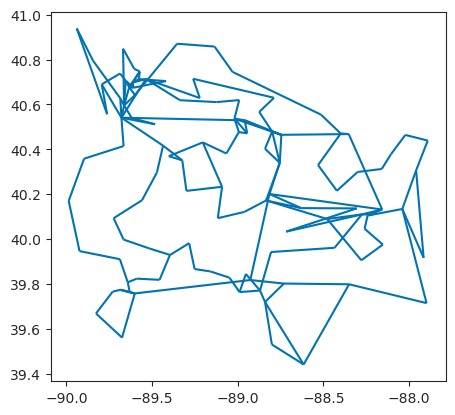

In [15]:
#####################################
##########bus_df
####################################

b_df = bus_df[["BusNum", "Latitude", "Longitude"]].set_index("BusNum").copy()
# “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
bus_gdf = gpd.GeoDataFrame(
    b_df,
    geometry=gpd.points_from_xy(b_df["Longitude"], b_df["Latitude"]),
    crs="epsg:4326",
)
bus_gdf
# bus_gdf = bus_gdf.to_crs(epsg=3857)


###### OPTIONAL: make bus "sizes" reflect the number of buses at the same latlon
df = bus_gdf.copy()
df["subgraph"] = 1


df = (
    df[["Latitude", "Longitude", "subgraph"]]
    .groupby(["Latitude", "Longitude"])
    .transform("count")
)
df

bus_gdf["size"] = df["subgraph"] * 10
bus_gdf

####  unique latlons
bus_unique_gdf = bus_gdf.drop_duplicates(["Latitude", "Longitude"])
print("\nnumber of unique latlons: {} out of 2000".format(len(bus_unique_gdf)))
bus_unique_gdf


####

###########################################
############ branch_df
##############################################

br_df = branch_df[
    [
        "FromBus",
        "ToBus",
        "from_latitude",
        "from_longitude",
        "to_latitude",
        "to_longitude",
    ]
].copy()

############## make from/to Points

br_df["FromPoint"] = [
    Point(x, y) for x, y in zip(br_df["from_longitude"], br_df["from_latitude"])
]
br_df["ToPoint"] = [
    Point(x, y) for x, y in zip(br_df["to_longitude"], br_df["to_latitude"])
]


############ lines
br_df["geometry"] = [
    LineString([x1, x2]) for x1, x2 in zip(br_df["FromPoint"], br_df["ToPoint"])
]


# “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
br_gdf = gpd.GeoDataFrame(br_df, geometry="geometry", crs="epsg:4326")

br_gdf.plot()

br_df


bus_gdf = bus_gdf.to_crs(epsg=3857)
br_gdf = br_gdf.to_crs(epsg=3857)

## existing wind penetration 
* using TE WTK

In [16]:
### for the true wind penetration we should get the actuals
# ##retrieve wind sites matching current wind penetration

# # retrieve wind sites (wind_sites are initially set to empty df )
# grid
# grid.retrieve_wind_sites(method="simple proximity")
# grid
# grid.wind_sites.head()


# grid.make_tables(
#     actuals_start=pd.Timestamp("2007-01-01 00:00:00", tz="utc"),
#     actuals_end=pd.Timestamp("2007-12-31 23:55:00", tz="utc"),
#     scenarios_start=pd.Timestamp("2008-01-01 00:00:00", tz="utc"),
#     scenarios_end=pd.Timestamp("2013-12-31 23:55:00", tz="utc"),
# )


tables_dir = "/projects/hpcapps/isatkaus/grid-buildouts-data/tables-data/"

# read instead of retrieve_wind_sites
filename = "{}_wind_sites_df.h5".format(grid_name)
grid.wind_sites = pd.read_hdf(os.path.join(tables_dir, filename))
print("\n wind sites")
grid.wind_sites.head()

# read instead of make_tables
filename = "{}_actuals_df.h5".format(grid_name)
grid.actuals = pd.read_hdf(os.path.join(tables_dir, filename))
filename = "{}_scenarios_df.h5".format(grid_name)
grid.scenarios = pd.read_hdf(os.path.join(tables_dir, filename))


# for actuals, make year you want
grid.actuals.index = grid.actuals.index.map(lambda t: t.replace(year=2020))
# see what you got
print("\nactuals_df:")
grid.actuals.head()
print("\nscenarios_df:")
grid.scenarios.head()

print(grid.info())


 wind sites


,SiteID,Capacity,Point,Latitude,Longitude,BusNum,GenUID
0,54007,16.0,POINT (-88.02514600000001 40.458515),40.458515,-88.025146,65,65_Wind_1
1,54196,16.0,POINT (-88.02273599999999 40.476978),40.476978,-88.022736,65,65_Wind_1
2,54008,16.0,POINT (-88.000885 40.456665),40.456665,-88.000885,65,65_Wind_1
3,53833,16.0,POINT (-88.02758799999999 40.440052),40.440052,-88.027588,65,65_Wind_1
4,54197,16.0,POINT (-87.998474 40.475128),40.475128,-87.998474,65,65_Wind_1



actuals_df:


,65_Wind_1,104_Wind_1,105_Wind_1,114_Wind_1,115_Wind_1,147_Wind_1,TotalPower
IssueTime,,,,,,,
2020-01-01 00:00:00+00:00,142.094736,99.000001,198.000002,1.7,150.0,100.5,691.294739
2020-01-01 00:05:00+00:00,140.804726,99.000001,198.000002,1.7,150.0,100.5,690.004728
2020-01-01 00:10:00+00:00,142.361249,99.000001,198.000002,1.7,150.0,100.5,691.561251
2020-01-01 00:15:00+00:00,145.972502,99.000001,198.000002,1.7,150.0,100.5,695.172504
2020-01-01 00:20:00+00:00,150.399995,99.000001,198.000002,1.7,150.0,100.5,699.599997



scenarios_df:


,65_Wind_1,104_Wind_1,105_Wind_1,114_Wind_1,115_Wind_1,147_Wind_1,TotalPower,Deviation
IssueTime,,,,,,,,
2008-01-01 00:00:00+00:00,1.459344,0.668133,0.583035,-0.024500,0.877288,1.845110,96.746560,5.408411
2008-01-01 00:05:00+00:00,1.601367,-0.445220,1.269019,0.091567,1.525665,3.528319,102.154971,7.570718
2008-01-01 00:10:00+00:00,1.097983,-0.016742,1.678258,0.294259,3.257260,5.579959,109.725689,11.890977
2008-01-01 00:15:00+00:00,1.172363,2.034480,3.025435,0.001593,4.814818,3.355411,121.616666,14.404100
2008-01-01 00:20:00+00:00,1.237113,2.234493,2.933309,0.000000,5.278723,6.783124,136.020766,18.466761



ACTIVSg200 grid info: 

 number of buses: 200
 number of generators: 49
 number of wind generators: 6
 number of solar generators: 0
 total generator capacity: 3602.84 MW
 wind capacity/penetration: 699.60 MW / 19.42%
 solar capacity/penetration: 0.00 MW / 0.00%


In [17]:
### total available wind energy (2007) when using TE
TE_wind_energy = grid.actuals["TotalPower"].sum() / 12
TE_wind_energy

2682398.2395944702

# run dir
* slect run_dir that you used in part1
* run_dir = wind_gen_tamu5
* run_dir for tamu200 has all years (2007-2013), entire box of tamu200 of wind
* part1 notebook created data in run_dir:
* tamu200_buildout_part1.ipynb
* only need to rerun part1 if changing grid or renewable technology (another wind turbine, solar panel, etc)
* current run: two ATB-mid30 turbines per WTK cell

In [18]:
run_dir = "/projects/exasgd/isatkaus/buildout/wind/wind_gen_tamu5"

In [19]:
!cat /projects/exasgd/isatkaus/buildout/wind/wind_gen_tamu5/readme.txt


experiment date: 2023-08-24 11:51:44
tamu200 grid, all years 
two ATB-mid30 turbines per WTK cell 
nrel-pysam version 4.1.0
nrel-reV verion: 0.7.0
using 5-min resource files (all files with * for the height)


In [20]:
!ls /projects/exasgd/isatkaus/buildout/wind/wind_gen_tamu5

all_cf_df.csv
buildouts
config_gen.json
jobstatus_wind_gen_tamu5_ModuleName.GENERATION_2007_00.json
jobstatus_wind_gen_tamu5_ModuleName.GENERATION_2007_01.json
jobstatus_wind_gen_tamu5_ModuleName.GENERATION_2007_02.json
jobstatus_wind_gen_tamu5_ModuleName.GENERATION_2007_03.json
jobstatus_wind_gen_tamu5_ModuleName.GENERATION_2007_04.json
jobstatus_wind_gen_tamu5_ModuleName.GENERATION_2007_05.json
jobstatus_wind_gen_tamu5_ModuleName.GENERATION_2007_06.json
jobstatus_wind_gen_tamu5_ModuleName.GENERATION_2007_07.json
jobstatus_wind_gen_tamu5_ModuleName.GENERATION_2007_08.json
jobstatus_wind_gen_tamu5_ModuleName.GENERATION_2007_09.json
jobstatus_wind_gen_tamu5_ModuleName.GENERATION_2007_10.json
jobstatus_wind_gen_tamu5_ModuleName.GENERATION_2007_11.json
jobstatus_wind_gen_tamu5_ModuleName.GENERATION_2007_12.json
jobstatus_wind_gen_tamu5_ModuleName.GENERATION_2007_13.json
jobstatus_wind_gen_tamu5_ModuleName.GENERATION_2007_14.json
jobstatus_wind_gen_tamu5_ModuleName.GENERATION_2007_15.json


##  work dir
####  change to where you want to write buildout results
* custon buildouts will be saved in work-dir/"some-buildout-configuration"
* work_dir will have common for all buildouts files. e.g., 
* "some-buildout-configuration" subdir we'll make later

In [21]:
work_dir = "/projects/exasgd/isatkaus/buildout/wind/wind_gen_tamu5/buildouts/work-dir"
# work_dir = "/projects/hpcapps/isatkaus/tmp"

if not os.path.exists(work_dir):
    os.makedirs(work_dir)

## start with all_cf_df.csv
* have all capacity factors
* have all inclusion % recorded already (not originally applied to generation_mwh, so will do it here)

In [22]:
### all capacity coefs that have all inclusion % recorded already
filename = "all_cf_df.csv"
cf_df = pd.read_csv(os.path.join(run_dir, filename), index_col=0)

#### all project points
filename = "pps_df.csv"
pps_df = pd.read_csv(os.path.join(run_dir, filename), index_col=0)
print("\n pps_df:")
pps_df

print("\n min capacity factor:")
cf_df["cf_mean"].min()
print("\n min min inclusion factor:")
cf_df["inclusion"].min()

#### apply inclusion factor to generation_mwh
cf_df["incl_generation_mwh"] = cf_df["generation_mwh"] * cf_df["inclusion"]


print("\n cf_df:")
cf_df


 pps_df:


,latitude,longitude
gid,,
1578401,41.145520,-90.285706
1578402,41.164040,-90.283936
1578403,41.182556,-90.282166
1578404,41.201090,-90.280426
...,...,...
1723329,39.306717,-87.596405
1723330,39.325130,-87.593900
1723331,39.343555,-87.591400
1724517,39.157475,-87.592680



 min capacity factor:


0.3351274


 min min inclusion factor:


0.0


 cf_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh
gid,,,,,,,
1623681,0.439715,39.983020,-89.496216,42370.930,POINT (-9962673.173042102 4863475.212568313),0.520661,22060.897438
1623682,0.442927,40.001484,-89.494260,42680.420,POINT (-9962455.752161646 4866157.920655073),0.332645,14197.412438
1623683,0.444570,40.019974,-89.492310,42838.800,POINT (-9962238.33128119 4868845.2357898485),0.083004,3555.789723
1623684,0.443698,40.038456,-89.490360,42754.734,POINT (-9962020.910400735 4871532.169914384),0.561983,24027.453818
...,...,...,...,...,...,...,...
1623677,0.434558,39.909100,-89.504090,41874.030,POINT (-9963549.65096644 4852741.657154222),0.444215,18601.067045
1623678,0.438975,39.927578,-89.502106,42299.630,POINT (-9963328.832884725 4855423.682178249),0.535124,22635.545806
1623679,0.439120,39.946056,-89.500150,42313.613,POINT (-9963111.412004272 4858106.431240479),0.472332,19986.074125
1623680,0.439343,39.964530,-89.498200,42335.113,POINT (-9962893.991123814 4860789.350957404),0.648760,27465.341905


In [23]:
###############
#### for gdp viz

# make gdf with project points
cf_df["geometry"] = [Point(x, y) for x, y in zip(cf_df["longitude"], cf_df["latitude"])]
# cf_df
# “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
cf_gdf = gpd.GeoDataFrame(cf_df, geometry="geometry", crs="epsg:4326")
cf_gdf = cf_gdf.to_crs("epsg:3857")

## cf cutoff
* histogram of capacity factors based on one year

In [24]:
cf_df["cf_mean"].iplot(kind="hist", title="histogram of capacity factors", bins=100)

<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

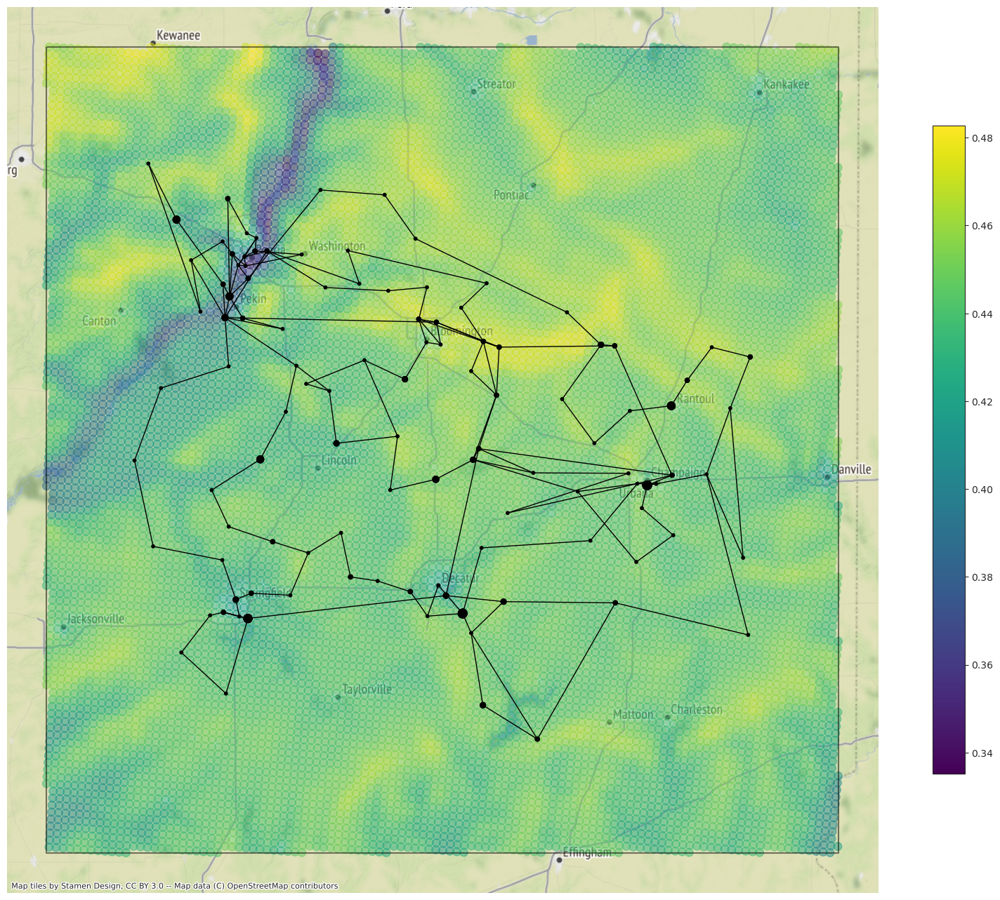

In [25]:
# # make gdf with project points
# cf_df["geometry"] = [Point(x, y) for x, y in zip(cf_df["longitude"], cf_df["latitude"])]
# # cf_df
# # “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
# cf_gdf = gpd.GeoDataFrame(cf_df, geometry="geometry", crs="epsg:4326")

cf_gdf = cf_gdf.to_crs("epsg:3857")
# plt.figure(figsize=(20, 20))
ax = cf_gdf.plot(
    figsize=(20, 20),
    markersize=70,
    column="cf_mean",
    legend=True,
    legend_kwds={
        "shrink": 0.6,
    },
    alpha=0.5,
    cmap="viridis",
)


# Web Mercator
# rts_box_gdf = rts_box_gdf.to_crs(epsg=3857)
bus_gdf = bus_gdf.to_crs(epsg=3857)
br_gdf = br_gdf.to_crs(epsg=3857)
# bus_gdf.plot(ax=ax, color="black",  markersize = 5)
bus_gdf.plot(ax=ax, color="black", markersize="size")

br_gdf.plot(ax=ax, color="black", linewidth=1)


####### based on project points, draw a box (OPTIONAL)
top = pps_df["latitude"].max()
bottom = pps_df["latitude"].min()
left = pps_df["longitude"].min()
right = pps_df["longitude"].max()

lat_point_list = [top, top, bottom, bottom]
lon_point_list = [left, right, right, left]

polygon_geom = Polygon(zip(lon_point_list, lat_point_list))
# “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
tamu_box_gdf = gpd.GeoDataFrame(index=[0], crs="epsg:4326", geometry=[polygon_geom])
# print(polygon.geometry)

tamu_box_gdf = tamu_box_gdf.to_crs("epsg:3857")
tamu_box_gdf.boundary.plot(ax=ax, alpha=0.5, edgecolor="k")


####### add map tile
ctx.add_basemap(ax)

# ### save figure
# save_dir = os.path.join(run_dir, "figures")
# filename = "cf_all_{}.png".format(year)
# plt.savefig(
#     os.path.join(save_dir, filename),
#     bbox_inches="tight",
# )

### save figure in work dir (since this is the same for all buildout options)
ax.set_axis_off()
filename = os.path.join(work_dir, "cfs_all.png")
plt.savefig(filename, bbox_inches="tight", pad_inches=0)

## high df
* select your capacity factor cutoff: i.e., drom low-capacity-factor sites


In [26]:
# select all sites in the box, selection by distance will be done later
selected_df = cf_df.copy()

# # capacity factor cutoff (old)
# cf_cutoff = 400
# capacity factor cutoff (new)
cf_cutoff = 0.40

high_df = selected_df.loc[selected_df["cf_mean"] >= cf_cutoff]
low_df = selected_df.loc[selected_df["cf_mean"] < cf_cutoff]

# color_map = ["blue" if x < cf_cutoff else "red" for x in selected_df["cf_mean"]]
# len(color_map)


# print('RTS total load (MWh):{:,}'.format(36581383.0))
total_generation = high_df["incl_generation_mwh"].sum()
print(
    "total included generation of selected high capacity sites (MWh):{:,}".format(
        round(total_generation)
    )
)

# total_generation /36581383.0
print("\nhigh_df:")
high_df
print("\nlow_df:")
low_df

###############
#### for gdp viz

# make gdf with project points
high_df["geometry"] = [
    Point(x, y) for x, y in zip(high_df["longitude"], high_df["latitude"])
]
# cf_df
# “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
high_gdf = gpd.GeoDataFrame(high_df, geometry="geometry", crs="epsg:4326")
high_gdf = high_gdf.to_crs("epsg:3857")

total included generation of selected high capacity sites (MWh):196,730,791

high_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh
gid,,,,,,,
1623681,0.439715,39.983020,-89.496216,42370.930,POINT (-89.49622 39.98302),0.520661,22060.897438
1623682,0.442927,40.001484,-89.494260,42680.420,POINT (-89.49426 40.00148),0.332645,14197.412438
1623683,0.444570,40.019974,-89.492310,42838.800,POINT (-89.49231 40.01997),0.083004,3555.789723
1623684,0.443698,40.038456,-89.490360,42754.734,POINT (-89.49036 40.03846),0.561983,24027.453818
...,...,...,...,...,...,...,...
1623677,0.434558,39.909100,-89.504090,41874.030,POINT (-89.50409 39.90910),0.444215,18601.067045
1623678,0.438975,39.927578,-89.502106,42299.630,POINT (-89.50211 39.92758),0.535124,22635.545806
1623679,0.439120,39.946056,-89.500150,42313.613,POINT (-89.50015 39.94606),0.472332,19986.074125
1623680,0.439343,39.964530,-89.498200,42335.113,POINT (-89.49820 39.96453),0.648760,27465.341905



low_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh
gid,,,,,,,
1623737,0.399054,41.018590,-89.384400,38452.848,POINT (-89.38440 41.01859),0.136364,5243.570182
1623738,0.393236,41.037110,-89.382385,37892.227,POINT (-89.38238 41.03711),0.330579,12526.356033
1623739,0.383189,41.055603,-89.380340,36924.110,POINT (-89.38034 41.05560),0.194215,7171.211446
1623740,0.371593,41.074120,-89.378296,35806.660,POINT (-89.37830 41.07412),0.002066,73.980702
...,...,...,...,...,...,...,...
1622509,0.396375,41.131172,-89.396790,38194.723,POINT (-89.39679 41.13117),0.268595,10258.913202
1622512,0.383010,41.186707,-89.390686,36906.848,POINT (-89.39069 41.18671),0.361570,13344.418182
1622513,0.363944,41.205210,-89.388640,35069.650,POINT (-89.38864 41.20521),0.092885,3257.457609
1622514,0.355947,41.223713,-89.386600,34299.023,POINT (-89.38660 41.22371),0.000000,0.000000


<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

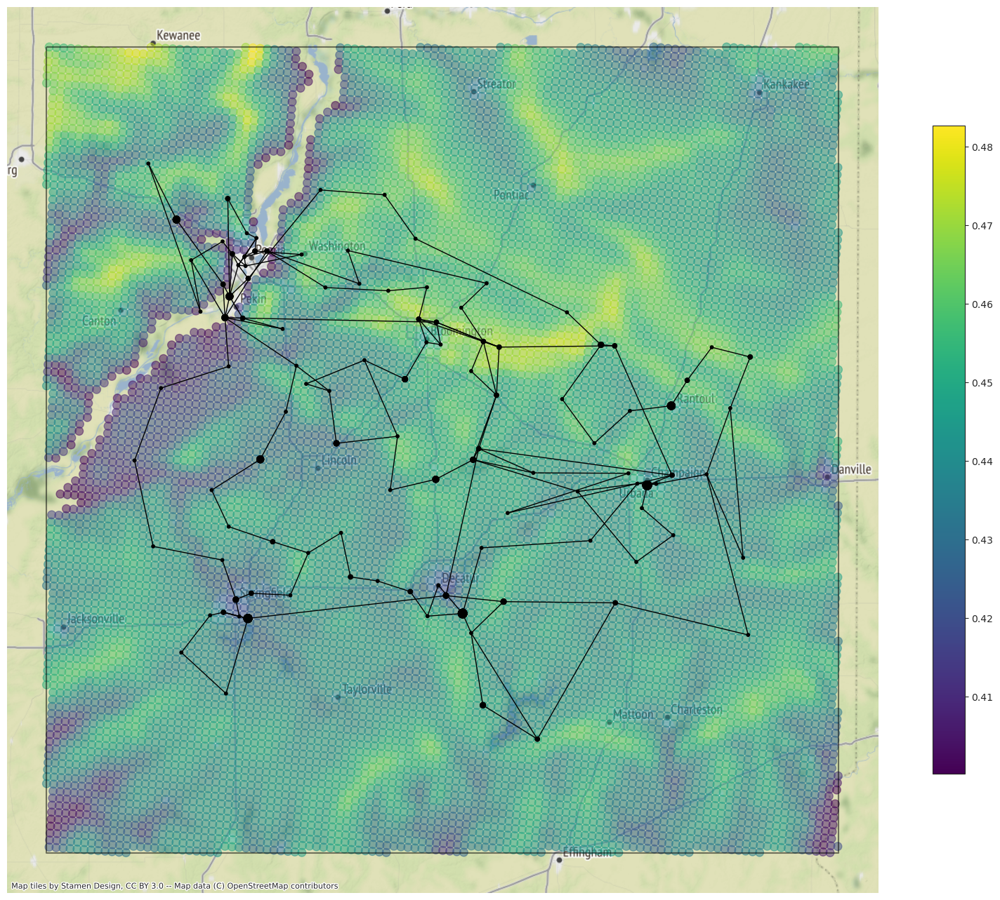

In [27]:
# # make gdf with project points
# cf_df["geometry"] = [Point(x, y) for x, y in zip(cf_df["longitude"], cf_df["latitude"])]
# # cf_df
# # “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
# cf_gdf = gpd.GeoDataFrame(cf_df, geometry="geometry", crs="epsg:4326")

high_gdf = high_gdf.to_crs("epsg:3857")
# plt.figure(figsize=(20, 20))
ax = high_gdf.plot(
    figsize=(20, 20),
    markersize=70,
    column="cf_mean",
    legend=True,
    legend_kwds={
        "shrink": 0.6,
    },
    alpha=0.5,
    cmap="viridis",
)


# Web Mercator
# rts_box_gdf = rts_box_gdf.to_crs(epsg=3857)
bus_gdf = bus_gdf.to_crs(epsg=3857)
br_gdf = br_gdf.to_crs(epsg=3857)
# bus_gdf.plot(ax=ax, color="black",  markersize = 5)
bus_gdf.plot(ax=ax, color="black", markersize="size")

br_gdf.plot(ax=ax, color="black", linewidth=1)


####### based on project points, draw a box (OPTIONAL)
top = pps_df["latitude"].max()
bottom = pps_df["latitude"].min()
left = pps_df["longitude"].min()
right = pps_df["longitude"].max()

lat_point_list = [top, top, bottom, bottom]
lon_point_list = [left, right, right, left]

polygon_geom = Polygon(zip(lon_point_list, lat_point_list))
# “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
tamu_box_gdf = gpd.GeoDataFrame(index=[0], crs="epsg:4326", geometry=[polygon_geom])
# print(polygon.geometry)

tamu_box_gdf = tamu_box_gdf.to_crs("epsg:3857")
tamu_box_gdf.boundary.plot(ax=ax, alpha=0.5, edgecolor="k")


####### add map tile
ctx.add_basemap(ax)

# ### save figure
# save_dir = os.path.join(run_dir, "figures")
# filename = "cf_all_{}.png".format(year)
# plt.savefig(
#     os.path.join(save_dir, filename),
#     bbox_inches="tight",
# )

### save figure in work dir (since this is the same for all buildout options)
ax.set_axis_off()
filename = os.path.join(work_dir, "cfs_after_cutoff.png")
plt.savefig(filename, bbox_inches="tight", pad_inches=0)

[Select grid](#select_grid)

* Capacity factors
<a id='capacity_factors'></a>

[Exclusions](#exclusions)

### save/load

In [28]:
### save high_df and low_df
work_dir
filename = "cf_df.csv"
high_df.to_csv(os.path.join(work_dir, filename))
filename = "high_cf_df.csv"
high_df.to_csv(os.path.join(work_dir, filename))
filename = "low_cf_df.csv"
low_df.to_csv(os.path.join(work_dir, filename))

'/projects/exasgd/isatkaus/buildout/wind/wind_gen_tamu5/buildouts/work-dir'

In [29]:
# ### load files
# filename = "high_cf_df.csv"
# high_df = pd.read_csv(os.path.join(run_dir, filename), index_col=0)


# # make gdf with project points
# high_df["geometry"] = [
#     Point(x, y) for x, y in zip(high_df["longitude"], high_df["latitude"])
# ]
# # cf_df
# # “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
# high_gdf = gpd.GeoDataFrame(high_df, geometry="geometry", crs="epsg:4326")
# high_gdf = high_gdf.to_crs("epsg:3857")

# high_gdf

# inclusion cutoff, capacity adjustement
* select minimum inclusion percentage to decide if site is "buidable" 
* select by inclusion from high_gdf
* recording exclusions was done in part1 notebook, now just need to select 
* 0 = nothing can be build

In [30]:
high_gdf

,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh
gid,,,,,,,
1623681,0.439715,39.983020,-89.496216,42370.930,POINT (-9962673.193 4863475.099),0.520661,22060.897438
1623682,0.442927,40.001484,-89.494260,42680.420,POINT (-9962455.452 4866157.933),0.332645,14197.412438
1623683,0.444570,40.019974,-89.492310,42838.800,POINT (-9962238.379 4868845.271),0.083004,3555.789723
1623684,0.443698,40.038456,-89.490360,42754.734,POINT (-9962021.306 4871532.175),0.561983,24027.453818
...,...,...,...,...,...,...,...
1623677,0.434558,39.909100,-89.504090,41874.030,POINT (-9963549.723 4852741.718),0.444215,18601.067045
1623678,0.438975,39.927578,-89.502106,42299.630,POINT (-9963328.865 4855423.686),0.535124,22635.545806
1623679,0.439120,39.946056,-89.500150,42313.613,POINT (-9963111.124 4858106.378),0.472332,19986.074125
1623680,0.439343,39.964530,-89.498200,42335.113,POINT (-9962894.051 4860789.214),0.648760,27465.341905


In [31]:
### sites with less that 20% buildable area will be dropped
inclusion_cutoff = 0.2
n_before = len(high_gdf)

# #### drop gids with 0.0 inclusion (i.e. 100 % excluded gids)
# high_gdf.drop(high_gdf.loc[high_gdf["inclusion"] = 0.0].index, inplace=True)

##### drop gids with inclusion below a cutoff
high_gdf.drop(
    high_gdf.loc[high_gdf["inclusion"] <= inclusion_cutoff].index, inplace=True
)


### add site capacity (2*5.5MW turbines per gid)
high_gdf["incl_capacity_mw"] = 11 * high_gdf["inclusion"]


n_after = len(high_gdf)
print("\nremoved {} gids out of {}".format(n_before - n_after, n_before))
print("\nhigh capacity factors above {} cell inclusion level:".format(inclusion_cutoff))

high_gdf


removed 1851 gids out of 12296

high capacity factors above 0.2 cell inclusion level:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1623681,0.439715,39.983020,-89.496216,42370.930,POINT (-9962673.193 4863475.099),0.520661,22060.897438,5.727273
1623682,0.442927,40.001484,-89.494260,42680.420,POINT (-9962455.452 4866157.933),0.332645,14197.412438,3.659091
1623684,0.443698,40.038456,-89.490360,42754.734,POINT (-9962021.306 4871532.175),0.561983,24027.453818,6.181818
1623685,0.440612,40.056930,-89.488370,42457.406,POINT (-9961799.780 4874218.644),0.411157,17456.660731,4.522727
...,...,...,...,...,...,...,...,...
1623677,0.434558,39.909100,-89.504090,41874.030,POINT (-9963549.723 4852741.718),0.444215,18601.067045,4.886364
1623678,0.438975,39.927578,-89.502106,42299.630,POINT (-9963328.865 4855423.686),0.535124,22635.545806,5.886364
1623679,0.439120,39.946056,-89.500150,42313.613,POINT (-9963111.124 4858106.378),0.472332,19986.074125,5.195652
1623680,0.439343,39.964530,-89.498200,42335.113,POINT (-9962894.051 4860789.214),0.648760,27465.341905,7.136364


<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

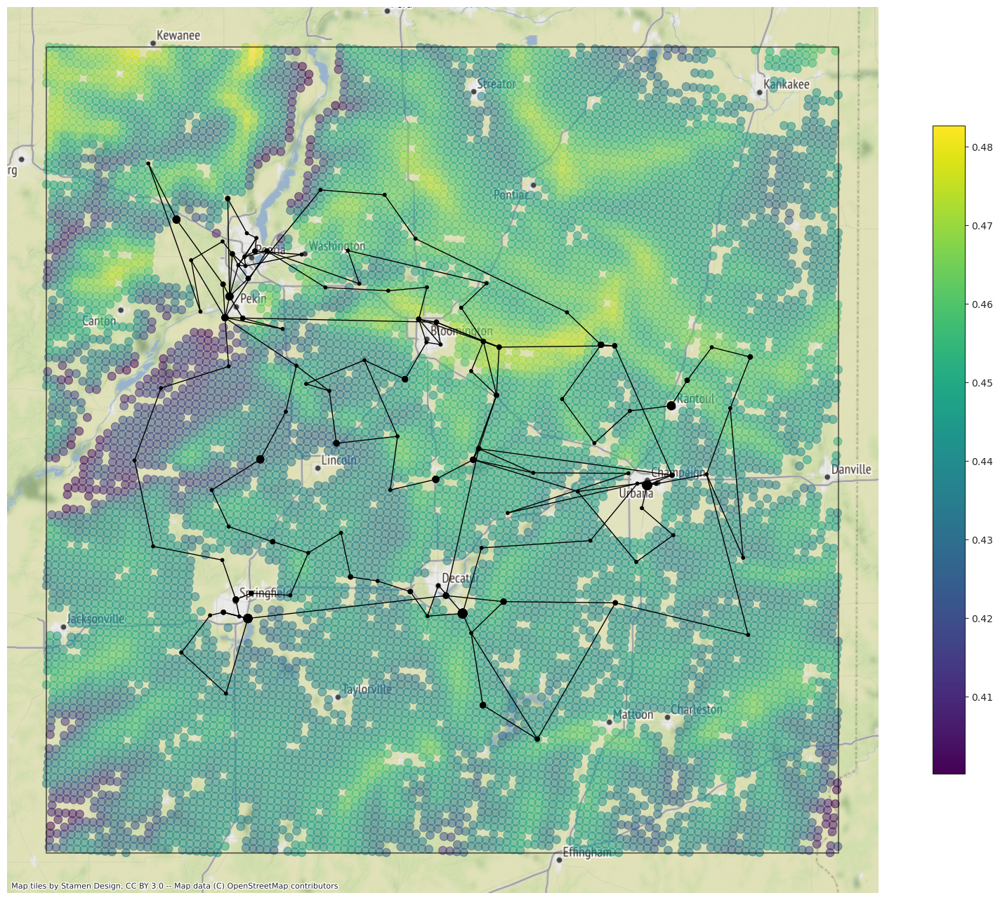

In [32]:
# # make gdf with project points
# cf_df["geometry"] = [Point(x, y) for x, y in zip(cf_df["longitude"], cf_df["latitude"])]
# # cf_df
# # “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
# cf_gdf = gpd.GeoDataFrame(cf_df, geometry="geometry", crs="epsg:4326")

high_gdf = high_gdf.to_crs("epsg:3857")
# plt.figure(figsize=(20, 20))
ax = high_gdf.plot(
    figsize=(20, 20),
    markersize=70,
    column="cf_mean",
    legend=True,
    legend_kwds={
        "shrink": 0.6,
    },
    alpha=0.5,
    cmap="viridis",
)


# Web Mercator
# rts_box_gdf = rts_box_gdf.to_crs(epsg=3857)
bus_gdf = bus_gdf.to_crs(epsg=3857)
br_gdf = br_gdf.to_crs(epsg=3857)
# bus_gdf.plot(ax=ax, color="black",  markersize = 5)
bus_gdf.plot(ax=ax, color="black", markersize="size")

br_gdf.plot(ax=ax, color="black", linewidth=1)


####### based on project points, draw a box (OPTIONAL)
top = pps_df["latitude"].max()
bottom = pps_df["latitude"].min()
left = pps_df["longitude"].min()
right = pps_df["longitude"].max()

lat_point_list = [top, top, bottom, bottom]
lon_point_list = [left, right, right, left]

polygon_geom = Polygon(zip(lon_point_list, lat_point_list))
polygon_geom = Polygon([(left, top), (right, top), (right, bottom), (left, bottom)])

# “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
tamu_box_gdf = gpd.GeoDataFrame(index=[0], crs="epsg:4326", geometry=[polygon_geom])
# print(polygon.geometry)

tamu_box_gdf = tamu_box_gdf.to_crs("epsg:3857")
tamu_box_gdf.boundary.plot(ax=ax, alpha=0.5, edgecolor="k")


####### add map tile
ctx.add_basemap(ax)


### save figure in work dir (since this is the same for all buildout options)
ax.set_axis_off()
filename = os.path.join(work_dir, "cfs_after_cutoff_and_exclusions.png")
plt.savefig(filename, bbox_inches="tight", pad_inches=0)

[Capacity factors](#capacity_factors)

* Exclusions
<a id='exclusions'></a>

[Voronoi](#voronoi)

### save/load

In [33]:
#### save high_df with inclusion col
filename = "high_cf_incl_df.csv"
high_gdf.to_csv(os.path.join(work_dir, filename))

In [34]:
# ### load

# filename = "high_cf_incl_df.csv"
# high_df = pd.read_csv(os.path.join(work_dir, filename), index_col=0)


# # make gdf with project points
# high_df["geometry"] = [
#     Point(x, y) for x, y in zip(high_df["longitude"], high_df["latitude"])
# ]
# # cf_df
# # “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
# high_gdf = gpd.GeoDataFrame(high_df, geometry="geometry", crs="epsg:4326")
# high_gdf = high_gdf.to_crs("epsg:3857")

# high_gdf

# #### all project points
# filename = "pps_df.csv"
# pps_df = pd.read_csv(os.path.join(work_dir, filename), index_col=0)
# pps_df

# load (demand) data
* somewhat optional, needed only if you want to use demand data for making buildouts
* e.g., match total buildout generation with total demand
* e.g., place new wind generators n-hops away from demand buses
* load data is the same for all buildouts, so can skip
* tamu200 load data parsing was done with mac local notebook:

* ~/projects/notebooks/ecp/public-github/powerscenarios/notebooks/dev/load/generate_TAMU200_load.ipynb

* already parsed data files:
* /projects/exasgd/isatkaus/data/load-data/ACTIVSg200
* NOTE: load ends on dec 31, 23:00, i.e., missing one hour, so 
* lets add one hour (11 5-min timesteps) by interpolating to "wrap around"
* being tedious to compute correct annual demand


In [35]:
load_data_dir = "/projects/hpcapps/isatkaus/grid-buildouts-data/load-data/"
####################################################################
###################################################################
filename = "ACTIVSg200_loadP.csv"
loadP_df = pd.read_csv(
    os.path.join(load_data_dir, filename), index_col=0, parse_dates=True
)
loadP_df.columns = loadP_df.columns.astype("int")

# ### add missing hour (repeat 22nd hour)
# df = loadP_df.iloc[-12:-1]
# df.index = df.index.map(lambda t: t.replace(hour=23))
# loadP_df = pd.concat([loadP_df, df])

# ### add missing hour (interpolate to wrap around)
start = loadP_df.iloc[-1:]
end = loadP_df.iloc[0:1]
end.index = end.index.map(lambda t: t.replace(month=12, day=31, hour=23, minute=55))
df = pd.concat([start, end]).resample("5min").interpolate()
df.drop(pd.Timestamp("2017-12-31 23:00:00+00:00"), inplace=True)
loadP_df = pd.concat([loadP_df, df])

### remap buses, since we removed existing wind gens
loadP_df.columns = loadP_df.columns.map(bus_map_s)
loadP_df

####################################################################
###################################################################
filename = "ACTIVSg200_loadQ.csv"
loadQ_df = pd.read_csv(
    os.path.join(load_data_dir, filename), index_col=0, parse_dates=True
)
loadQ_df.columns = loadQ_df.columns.astype("int")

# ### add missing hour (repeat 22nd hour)
# df = loadQ_df.iloc[-12:-1]
# df.index = df.index.map(lambda t: t.replace(hour=23))
# loadQ_df = pd.concat([loadQ_df, df])

# ### add missing hour (interpolate to wrap around)
start = loadQ_df.iloc[-1:]
end = loadQ_df.iloc[0:1]
end.index = end.index.map(lambda t: t.replace(month=12, day=31, hour=23, minute=55))
df = pd.concat([start, end]).resample("5min").interpolate()
df.drop(pd.Timestamp("2017-12-31 23:00:00+00:00"), inplace=True)
loadQ_df = pd.concat([loadQ_df, df])

### remap buses, since we removed existing wind gens
loadQ_df.columns = loadQ_df.columns.map(bus_map_s)
loadQ_df


################### save new files
load_save_dir = os.path.join(work_dir, "load-data")
if not os.path.exists(load_save_dir):
    os.makedirs(load_save_dir)

filename = "ACTIVSg200_loadP.csv"
loadP_df.to_csv(os.path.join(load_save_dir, filename))
print("\n saving loadP_df to:")
os.path.join(load_save_dir, filename)

filename = "ACTIVSg200_loadQ.csv"
loadQ_df.to_csv(os.path.join(load_save_dir, filename))
print("\n saving loadQ_df to:")
os.path.join(load_save_dir, filename)

,2,8,10,30,43,59,60,74,83,85,96,98,100,105,107,...,138,157,166,167,168,169,173,174,178,185,87,140,170,179,188
DateTime,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2017-01-01 00:00:00+00:00,4.544305,14.598349,26.245053,36.335993,1.285196,2.908601,2.336720,2.213735,2.305973,5.073142,4.507410,7.483653,0.319762,5.792605,6.678099,...,14.888107,25.462109,2.990964,4.842248,1.539957,4.063931,13.125773,4.302985,5.943012,4.019455,32.817472,11.666365,12.644105,7.176744,24.988902
2017-01-01 00:05:00+00:00,4.512747,14.496972,26.062796,36.083660,1.276271,2.888403,2.320493,2.198361,2.289960,5.037912,4.476108,7.431683,0.317541,5.752379,6.631724,...,14.782036,25.280703,2.969655,4.807749,1.528986,4.034977,13.032258,4.272328,5.900671,3.990818,32.508339,11.556471,12.525000,7.109140,24.753512
2017-01-01 00:10:00+00:00,4.481190,14.395595,25.880538,35.831326,1.267346,2.868204,2.304265,2.182988,2.273946,5.002681,4.444807,7.379713,0.315321,5.712153,6.585348,...,14.675964,25.099297,2.948345,4.773251,1.518014,4.006023,12.938742,4.241672,5.858329,3.962182,32.199205,11.446576,12.405896,7.041537,24.518122
2017-01-01 00:15:00+00:00,4.449632,14.294217,25.698281,35.578993,1.258421,2.848005,2.288038,2.167615,2.257932,4.967451,4.413505,7.327743,0.313100,5.671926,6.538972,...,14.569893,24.917891,2.927036,4.738752,1.507043,3.977069,12.845227,4.211015,5.815988,3.933545,31.890071,11.336681,12.286791,6.973933,24.282732
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-12-31 23:40:00+00:00,4.636776,14.895409,26.779109,37.075388,1.311348,2.967788,2.384269,2.258781,2.352897,5.176374,4.599130,7.635936,0.326268,5.910478,6.813991,...,14.962216,25.588853,3.005852,4.866352,1.547623,4.084160,13.191110,4.324404,5.972595,4.039463,33.009883,11.734766,12.718238,7.218821,25.135414
2017-12-31 23:45:00+00:00,4.605953,14.796389,26.601090,36.828923,1.302631,2.948059,2.368419,2.243766,2.337256,5.141963,4.568557,7.585175,0.324100,5.871187,6.768694,...,14.937513,25.546605,3.000889,4.858317,1.545068,4.077417,13.169331,4.317265,5.962734,4.032794,32.945746,11.711966,12.693527,7.204795,25.086577
2017-12-31 23:50:00+00:00,4.575129,14.697369,26.423072,36.582458,1.293913,2.928330,2.352570,2.228750,2.321615,5.107553,4.537983,7.534414,0.321931,5.831896,6.723396,...,14.912810,25.504357,2.995927,4.850283,1.542512,4.070674,13.147552,4.310125,5.952873,4.026125,32.881609,11.689166,12.668816,7.190769,25.037739
2017-12-31 23:55:00+00:00,4.544305,14.598349,26.245053,36.335993,1.285196,2.908601,2.336720,2.213735,2.305973,5.073142,4.507410,7.483653,0.319762,5.792605,6.678099,...,14.888107,25.462109,2.990964,4.842248,1.539957,4.063931,13.125773,4.302985,5.943012,4.019455,32.817472,11.666365,12.644105,7.176744,24.988902


,2,8,10,30,43,59,60,74,83,85,96,98,100,105,107,...,138,157,166,167,168,169,173,174,178,185,87,140,170,179,188
DateTime,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2017-01-01 00:00:00+00:00,1.291345,4.163051,7.477503,10.355358,0.362806,0.830150,0.664120,0.633374,0.657971,1.445077,1.285196,2.133794,0.092239,1.648002,1.900122,...,4.241832,7.255033,0.850590,1.378734,0.439194,1.156358,3.741485,1.228630,1.695621,1.145239,9.351716,3.325646,3.605000,2.041946,7.123533
2017-01-01 00:05:00+00:00,1.282377,4.134141,7.425576,10.283446,0.360287,0.824386,0.659508,0.628976,0.653402,1.435041,1.276271,2.118976,0.091598,1.636558,1.886927,...,4.211611,7.203344,0.844530,1.368911,0.436065,1.148119,3.714828,1.219877,1.683540,1.137080,9.263625,3.294319,3.571042,2.022712,7.056431
2017-01-01 00:10:00+00:00,1.273410,4.105231,7.373649,10.211534,0.357768,0.818621,0.654896,0.624577,0.648833,1.425006,1.267346,2.104158,0.090958,1.625113,1.873732,...,4.181389,7.151656,0.838470,1.359089,0.432935,1.139881,3.688172,1.211123,1.671460,1.128920,9.175534,3.262992,3.537083,2.003477,6.989329
2017-01-01 00:15:00+00:00,1.264442,4.076321,7.321722,10.139622,0.355248,0.812856,0.650285,0.620179,0.644263,1.414971,1.258421,2.089340,0.090317,1.613669,1.860536,...,4.151168,7.099967,0.832410,1.349266,0.429806,1.131642,3.661515,1.202370,1.659379,1.120761,9.087442,3.231665,3.503125,1.984242,6.922227
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-12-31 23:40:00+00:00,1.317623,4.247764,7.629662,10.566078,0.370189,0.847043,0.677634,0.646262,0.671360,1.474482,1.311348,2.177214,0.094116,1.681537,1.938787,...,4.262946,7.291147,0.854824,1.385597,0.441380,1.162114,3.760109,1.234746,1.704061,1.150940,9.406546,3.345144,3.626136,2.053919,7.165299
2017-12-31 23:45:00+00:00,1.308863,4.219526,7.578942,10.495838,0.367728,0.841412,0.673130,0.641966,0.666897,1.464680,1.302631,2.162741,0.093490,1.670359,1.925899,...,4.255908,7.279109,0.853413,1.383310,0.440651,1.160195,3.753901,1.232707,1.701248,1.149039,9.388269,3.338645,3.619091,2.049928,7.151377
2017-12-31 23:50:00+00:00,1.300104,4.191289,7.528223,10.425598,0.365267,0.835781,0.668625,0.637670,0.662434,1.454879,1.293913,2.148268,0.092865,1.659181,1.913011,...,4.248870,7.267071,0.852001,1.381022,0.439922,1.158276,3.747693,1.230669,1.698434,1.147139,9.369992,3.332145,3.612045,2.045937,7.137455
2017-12-31 23:55:00+00:00,1.291345,4.163051,7.477503,10.355358,0.362806,0.830150,0.664120,0.633374,0.657971,1.445077,1.285196,2.133794,0.092239,1.648002,1.900122,...,4.241832,7.255033,0.850590,1.378734,0.439194,1.156358,3.741485,1.228630,1.695621,1.145239,9.351716,3.325646,3.605000,2.041946,7.123533



 saving loadP_df to:


'/projects/exasgd/isatkaus/buildout/wind/wind_gen_tamu5/buildouts/work-dir/load-data/ACTIVSg200_loadP.csv'


 saving loadQ_df to:


'/projects/exasgd/isatkaus/buildout/wind/wind_gen_tamu5/buildouts/work-dir/load-data/ACTIVSg200_loadQ.csv'

In [36]:
total_load_mwh = loadP_df.sum().sum() / 12
print(f"\n total {grid_name} loadP: {round(total_load_mwh):,} MWh")

load_buses = loadP_df.columns
print(f"\n total number of load buses is {len(load_buses)} out of {len(bus_df)}")
print("\n load bus numbers:")
load_buses.sort_values()


 total ACTIVSg200 loadP: 8,949,170 MWh

 total number of load buses is 108 out of 194

 load bus numbers:


Int64Index([  2,   4,   6,   8,  10,  12,  13,  16,  18,  19,
            ...
            179, 180, 184, 185, 186, 187, 188, 192, 193, 194],
           dtype='int64', length=108)

In [37]:
# total_consumption = load_df.sum().sum()
# print("total tamu2k consumption (MWh):{:,}".format(round(total_consumption)))

# total_generation = high_gdf["generation_mwh"].sum()

# print(
#     "total generation of selected high capacity sites after exclusions (MWh):{:,}".format(
#         round(total_generation)
#     )
# )
# print(
#     "available to required ratio: {}".format(
#         round(total_generation / total_consumption, 2)
#     )
# )

# ### total available wind energy (2007) when using TE
# TE_wind_energy = grid.actuals["TotalPower"].sum() / 12
# TE_wind_energy

# print(
#     "existing wind penetration using TE data (2007): {}".format(
#         round(TE_wind_energy / total_consumption, 2)
#     )
# )

# Voronoi polygons based on all bus unique locations
* what can we build?

In [38]:
print("\n For Voronoi method unique locations matter:")

### unique buses
s = bus_df.apply(lambda x: (x["Latitude"], x["Longitude"]), axis=1).unique()
print(f"\n unique bus locations: {len(s)} out of {len(bus_df)}:")

### unique gens (thermal only)
s = gen_df.apply(lambda x: (x["Latitude"], x["Longitude"]), axis=1).unique()
print(f"\n unique gen locations {len(s)} out of {len(gen_df)}:")


 For Voronoi method unique locations matter:

 unique bus locations: 111 out of 194:

 unique gen locations 13 out of 43:


In [39]:
#############################################
### create points_gdf - voronoi polygon points

##### we need to limit buses to unique latlons
# bus_gdf = bus_gdf.to_crs(epsg=3857)
bus_unique_gdf = bus_gdf.drop_duplicates(["Latitude", "Longitude"])
bus_unique_gdf = bus_unique_gdf.to_crs(epsg=3857)
bus_unique_gdf.reset_index(inplace=True)
### first_bus is first in the row when dropping duplicates in unique locations
points_gdf = bus_unique_gdf.copy()
points_gdf.rename(columns={"BusNum": "first_bus"}, inplace=True)
points_gdf.index.name = "pt_idx"
print("\n voronoi polygon points (one per polygon), points_gdf:")
points_gdf


 voronoi polygon points (one per polygon), points_gdf:


,first_bus,Latitude,Longitude,geometry,size
pt_idx,,,,,
0,1,40.642116,-89.599560,POINT (-9974177.395 4959696.311),20
1,3,39.866030,-89.251291,POINT (-9935408.267 4846493.180),20
2,5,40.378337,-88.105151,POINT (-9807820.546 4921074.461),20
3,7,40.712882,-89.576722,POINT (-9971635.080 4970083.622),20
...,...,...,...,...,...
107,189,40.470500,-88.398700,POINT (-9840498.271 4934551.478),30
108,192,40.556403,-89.762073,POINT (-9992268.259 4947129.757),10
109,193,40.306027,-87.958606,POINT (-9791507.231 4910513.455),10
110,194,40.169931,-89.986537,POINT (-10017255.477 4890667.004),10


In [40]:
#############################################################
### tighter voronoi boundary box: polygon instead of the box
### to get clockwise polygon points (lon,lat) use gdf map or bokeh map
### bokeh map:
### /Users/isatkaus/projects/intern/clara/grid-viz-bokeh/html-plots/ACTIVSg200_splitpoints.html

#### polygon points
polygon_points = [
    (-1.000e7, 4.79e6),
    (-1.004e7, 4.90e6),
    (-1.004e7, 5.02e6),
    (-9.90e6, 5.02e6),
    (-9.85e6, 4.98e6),
    (-9.80e6, 4.95e6),
    (-9.77e6, 4.94e6),
    (-9.77e6, 4.80e6),
    (-9.80e6, 4.80e6),
    (-9.85e6, 4.77e6),
    (-9.90e6, 4.77e6),
    (-9.95e6, 4.80e6),
]

polygon_geom = Polygon(polygon_points)
## when using Mercantor
tamu_polygon_gdf = gpd.GeoDataFrame(index=[0], crs="epsg:3857", geometry=[polygon_geom])
# print(polygon.geometry)


#### simple square box
lat_point_list = [top, top, bottom, bottom]
lon_point_list = [left, right, right, left]
polygon_points = zip(lon_point_list, lat_point_list)
polygon_geom = Polygon(polygon_points)

###“EPSG:4326” WGS84 Latitude/Longitude, used in GPS
tamu_box_gdf = gpd.GeoDataFrame(index=[0], crs="epsg:4326", geometry=[polygon_geom])
tamu_box_gdf = tamu_box_gdf.to_crs("epsg:3857")

<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

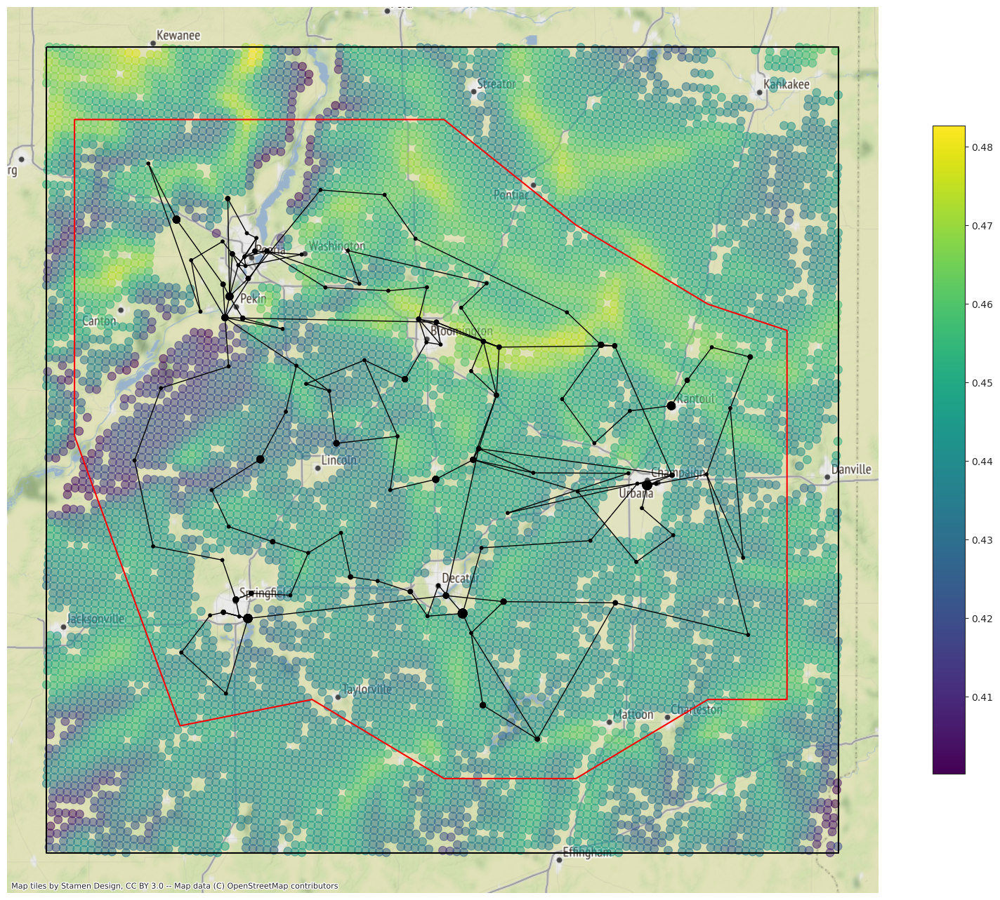

In [41]:
####################################################
#### plot with tighter Voronoi polygon boundary

high_gdf = high_gdf.to_crs("epsg:3857")
# plt.figure(figsize=(20, 20))
ax = high_gdf.plot(
    figsize=(20, 20),
    markersize=70,
    column="cf_mean",
    legend=True,
    legend_kwds={
        "shrink": 0.6,
    },
    alpha=0.5,
    cmap="viridis",
)


# Web Mercator
# rts_box_gdf = rts_box_gdf.to_crs(epsg=3857)
bus_gdf = bus_gdf.to_crs(epsg=3857)
br_gdf = br_gdf.to_crs(epsg=3857)
# bus_gdf.plot(ax=ax, color="black",  markersize = 5)
bus_gdf.plot(ax=ax, color="black", markersize="size")

br_gdf.plot(ax=ax, color="black", linewidth=1)


# ####### based on project points, draw a box (OPTIONAL)
# top = pps_df["latitude"].max()
# bottom = pps_df["latitude"].min()
# left = pps_df["longitude"].min()
# right = pps_df["longitude"].max()

# lat_point_list = [top, top, bottom, bottom]
# lon_point_list = [left, right, right, left]

# polygon_geom = Polygon(zip(lon_point_list, lat_point_list))
# polygon_geom = Polygon([(left, top), (right, top), (right, bottom), (left, bottom)])

# # “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
# tamu_box_gdf = gpd.GeoDataFrame(index=[0], crs="epsg:4326", geometry=[polygon_geom])
# # print(polygon.geometry)

tamu_box_gdf = tamu_box_gdf.to_crs("epsg:3857")
tamu_box_gdf.boundary.plot(ax=ax, alpha=1, edgecolor="k")

tamu_polygon_gdf.boundary.plot(ax=ax, alpha=1, edgecolor="r")

####### add map tile
ctx.add_basemap(ax)

### save figure in work dir (since this is the same for all buildout options)
ax.set_axis_off()
filename = os.path.join(work_dir, "voronoi_boundary.png")
plt.savefig(filename, bbox_inches="tight", pad_inches=0)

In [42]:
############################################
#### create voronoi polygons
#### based on boundary (tamu_polygon_gdf) and points (points_gdf)

### old way
# boundary = tamu_box_gdf
### new way
boundary = tamu_polygon_gdf

# Web Mercator# this works with ctx background
boundary = boundary.to_crs(epsg=3857)


### index 0..111 will then correspond to poly_to_pt_assignments
### i.e., inxex 0 will be pt 0

# Geovoronoi needs certain format
# boundary into a usion of polygons
# boundary_shape = cascaded_union(boundary.geometry)
boundary_shape = unary_union(boundary.geometry)

# geopandas GeoSeries of Point objects to NumPy array of coordinates
# I could do it straight from bus_df, but oh well

coords = points_to_coords(points_gdf.geometry)

# # Calculate Voronoi Regions when geovoronoi.__version__ = 0.2.0
# poly_shapes, pts, poly_to_pt_assignments = voronoi_regions_from_coords(
#     coords, boundary_shape
# )

# Calculate Voronoi Regions when geovoronoi.__version__ = 0.4.0
poly_shapes, pts = voronoi_regions_from_coords(coords, boundary_shape)

In [43]:
# #### use only with geovoronoi version 0.4.0 ####
#####################################################################################
#### create vor_gdf that will contain polygon geometries corresponding to points_gdf
#### gdf is easier to use/plot

# turn voronoi polygons into gdf
vor_gdf = gpd.GeoDataFrame(
    crs="epsg:3857",
    geometry=list(poly_shapes.values()),
)

### polygons in poly_shapes are shuffled
### their corresponding points are in "pts" variable when using version 0.4.0
vor_gdf["vor_idx"] = pd.Series(pts).apply(lambda x: x[0])
vor_gdf.set_index("vor_idx", inplace=True)

vor_gdf["first_bus"] = points_gdf["first_bus"]

vor_gdf["Latitude"] = points_gdf["Latitude"]
vor_gdf["Longitude"] = points_gdf["Longitude"]

vor_gdf.sort_index(inplace=True)


# #### save vor_gdf
# filename = "vor_gdf.csv"
# vor_gdf.to_csv(os.path.join(buildout_dir, filename))

print("\n vor_idx corresponts to pt_idx in points_gdf \n vor_gdf:")

vor_gdf


 vor_idx corresponts to pt_idx in points_gdf 
 vor_gdf:


,geometry,first_bus,Latitude,Longitude
vor_idx,,,,
0,"POLYGON ((-9968402.192 4963402.038, -9961604.3...",1,40.642116,-89.599560
1,"POLYGON ((-9928617.310 4856698.678, -9941824.7...",3,39.866030,-89.251291
2,"POLYGON ((-9816850.173 4937506.501, -9795753.0...",5,40.378337,-88.105151
3,"POLYGON ((-9969296.246 4964677.761, -9969383.7...",7,40.712882,-89.576722
...,...,...,...,...
107,"POLYGON ((-9836619.139 4951507.862, -9856670.9...",189,40.470500,-88.398700
108,"POLYGON ((-9987946.507 4952281.846, -9993611.0...",192,40.556403,-89.762073
109,"POLYGON ((-9795753.077 4921834.887, -9793568.9...",193,40.306027,-87.958606
110,"POLYGON ((-9997300.799 4898942.853, -10006110....",194,40.169931,-89.986537


In [44]:
# #### use only with geovoronoi version 0.2.0 ####
# #####################################################################################
# #### create vor_gdf that will contain polygon geometries corresponding to points_gdf
# #### gdf is easier to use/plot geovoronoi version 0.2.0

# # turn voronoi polygons into gdf
# vor_gdf = gpd.GeoDataFrame(
#     crs="epsg:3857",
#     geometry=poly_shapes,
# )


# ### polygons in poly_shapes are shuffled
# ### their corresponding points are in poly_to_pt_assignments version 0.2.0
# vor_gdf["vor_idx"] = [pt[0] for pt in poly_to_pt_assignments]


# vor_gdf.set_index("vor_idx", inplace=True)

# vor_gdf["first_bus"] = points_gdf["first_bus"]

# vor_gdf["Latitude"] = points_gdf["Latitude"]
# vor_gdf["Longitude"] = points_gdf["Longitude"]

# vor_gdf.sort_index(inplace=True)


# # #### save vor_gdf
# # filename = "vor_gdf.csv"
# # vor_gdf.to_csv(os.path.join(buildout_dir, filename))

# print("\n vor_idx corresponts to pt_idx in points_gdf \n vor_gdf:")

# vor_gdf

In [45]:
######################################################
#### add all bus numbers that belong to same polygon
#### will be used when picking the connection bus

### we need this to insert lists (objects) into dataframe's cells
vor_gdf["bus_num_list"] = np.nan
vor_gdf["bus_num_list"] = vor_gdf["bus_num_list"].astype("object")

### add all bus numbers that belong to same polygon
for vor_idx in vor_gdf.index[:]:
    lat = vor_gdf.loc[vor_idx, "Latitude"]
    lon = vor_gdf.loc[vor_idx, "Longitude"]
    # bus_df.loc[(bus_df["Latitude"] == lat) & (bus_df["Longitude"] == lon)]
    bus_num_list = bus_df.loc[
        (bus_df["Latitude"] == lat) & (bus_df["Longitude"] == lon)
    ]["BusNum"].values.tolist()
    # bus_num_list
    vor_gdf.at[vor_idx, "bus_num_list"] = bus_num_list

vor_gdf


# ##### another way of doing above using fancier groupby + aggregate
# df = bus_df[["BusNum", "Latitude", "Longitude"]]
# # df.set_index("BusNum", inplace=True)

# # df.groupby(["Latitude", "Longitude"]).set()
# vor_df = df.groupby(["Latitude", "Longitude"], as_index=False)["BusNum"].agg(
#     {"BusNumList": (lambda x: list(x))}
# )

,geometry,first_bus,Latitude,Longitude,bus_num_list
vor_idx,,,,,
0,"POLYGON ((-9968402.192 4963402.038, -9961604.3...",1,40.642116,-89.599560,"[1, 2]"
1,"POLYGON ((-9928617.310 4856698.678, -9941824.7...",3,39.866030,-89.251291,"[3, 4]"
2,"POLYGON ((-9816850.173 4937506.501, -9795753.0...",5,40.378337,-88.105151,"[5, 6]"
3,"POLYGON ((-9969296.246 4964677.761, -9969383.7...",7,40.712882,-89.576722,"[7, 8]"
...,...,...,...,...,...
107,"POLYGON ((-9836619.139 4951507.862, -9856670.9...",189,40.470500,-88.398700,"[189, 190, 191]"
108,"POLYGON ((-9987946.507 4952281.846, -9993611.0...",192,40.556403,-89.762073,[192]
109,"POLYGON ((-9795753.077 4921834.887, -9793568.9...",193,40.306027,-87.958606,[193]
110,"POLYGON ((-9997300.799 4898942.853, -10006110....",194,40.169931,-89.986537,[194]


<Figure size 640x480 with 0 Axes>

<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

<Figure size 640x480 with 0 Axes>

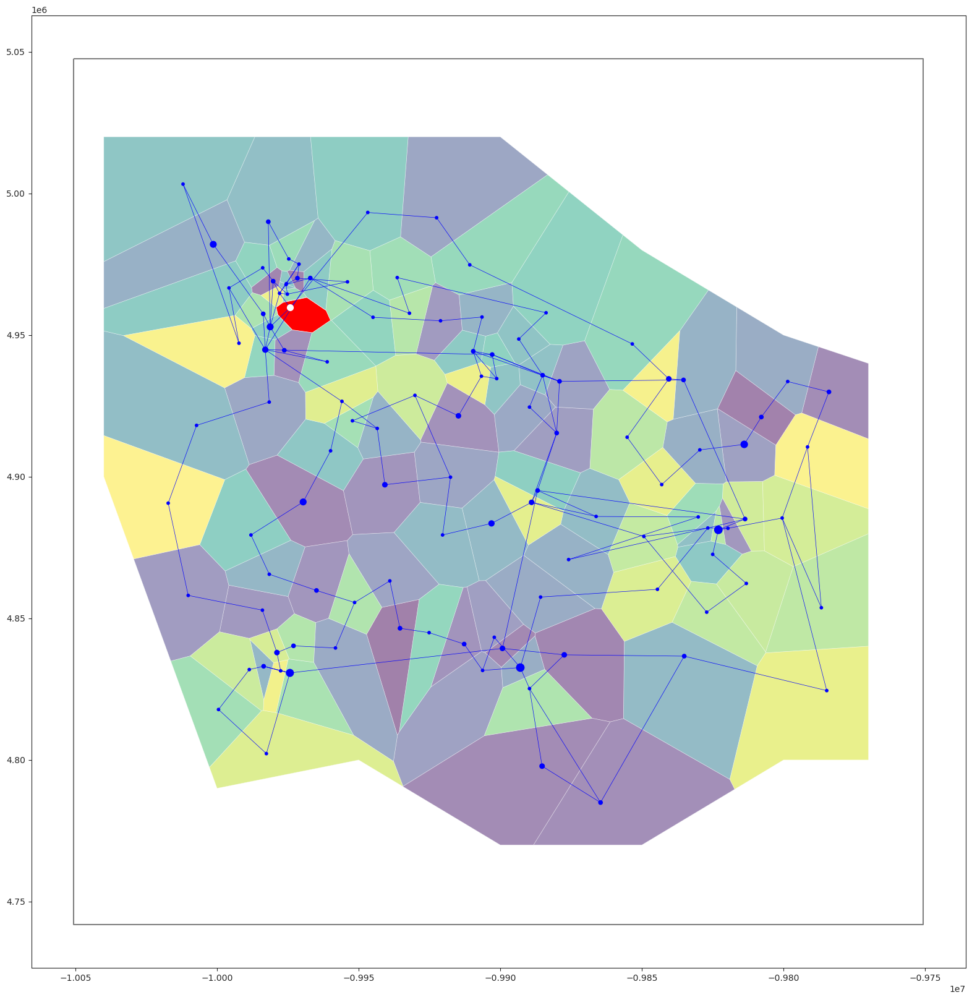

In [46]:
################################
##### plot vor_gdf (new way)
plt.figure()

ax = tamu_box_gdf.boundary.plot(figsize=(20, 20), alpha=0.5, edgecolor="k")

# ##########Voronoi polygons from vor_gdf
vor_gdf.plot(ax=ax, cmap="viridis", linewidth=0.5, alpha=0.5)

# bus_unique_gdf.plot(ax=ax, color="blue", markersize = 1)
bus_unique_gdf.plot(ax=ax, color="blue", markersize="size")
# bus_wind_unique_gdf.plot(ax=ax, color="red", markersize = 5)
br_gdf.plot(ax=ax, color="blue", linewidth=0.5)


################ verify vor_idx coresponds to pt_idx and
################ we match num_bus_list numbrs (also use bokeh plot for that)
### plot one specific polygon
vor_idx = 0
vor_gdf.loc[vor_idx:vor_idx].plot(
    ax=ax,
    color="red",
    linewidth=0.5,
)
### plot one specific point location
points_gdf.loc[vor_idx:vor_idx].plot(ax=ax, color="white", markersize=50, zorder=5)

# ##########Voronoi polygons plotting (old way)
# colors_n = 20
# color_array = plt.get_cmap("tab20")(range(colors_n))
# # crs = {"init": "epsg:3395"}
# # plot Vorponoi shapes
# for k, polygon in enumerate(poly_shapes[:]):

#     piece_gdf = gpd.GeoDataFrame(index=[0], crs="epsg:3857", geometry=[poly_shapes[k]],)
#     color = color_array[k % colors_n]
#     _ = piece_gdf.plot(ax=ax, alpha=0.4, color=color)

# ctx.add_basemap(ax, source=ctx.providers.Stamen.Terrain)


# ax.set_axis_off()
# #plt.savefig('./pics/grid_and_vor.png',  bbox_inches='tight', pad_inches=0  )

In [47]:
s = high_gdf.within(vor_gdf.loc[vor_idx, "geometry"])

s = high_gdf.within(tamu_polygon_gdf.loc[0, "geometry"])
# tamu_polygon_gdf.boundary.plot(ax=ax, alpha=1, edgecolor="r")
s
s[s].index

gid
1623681    True
1623682    True
1623684    True
1623685    True
           ... 
1623677    True
1623678    True
1623679    True
1623680    True
Length: 10445, dtype: bool

Int64Index([1623681, 1623682, 1623684, 1623685, 1623686, 1623687, 1623688,
            1623689, 1623690, 1623691,
            ...
            1623663, 1623664, 1623666, 1623667, 1623669, 1623670, 1623677,
            1623678, 1623679, 1623680],
           dtype='int64', name='gid', length=6139)

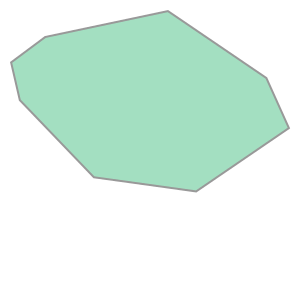

In [48]:
vor_gdf.loc[vor_idx, "geometry"]

<Figure size 640x480 with 0 Axes>

<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

<Figure size 640x480 with 0 Axes>

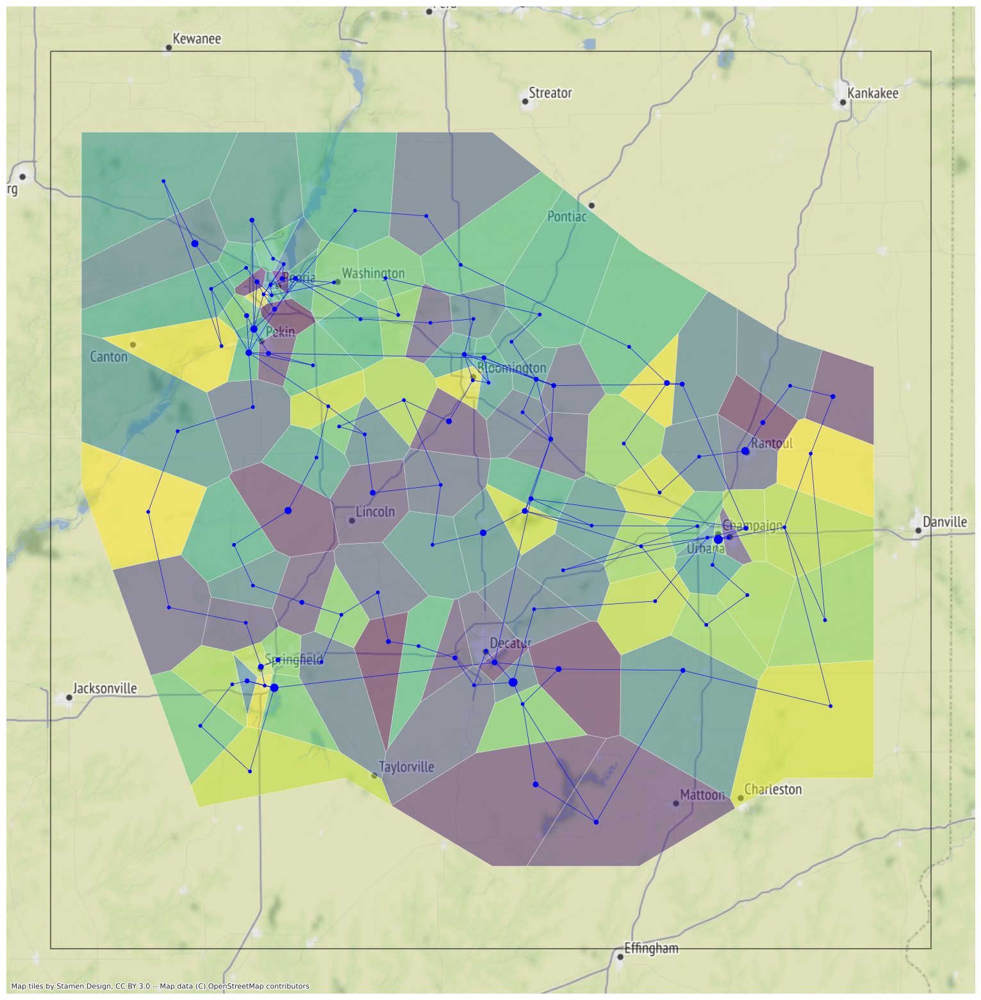

In [49]:
################################
##### plot vor_gdf (new way)
plt.figure()

ax = tamu_box_gdf.boundary.plot(figsize=(20, 20), alpha=0.5, edgecolor="k")

# ##########Voronoi polygons from vor_gdf
vor_gdf.plot(ax=ax, cmap="viridis", linewidth=0.5, alpha=0.5)

# bus_unique_gdf.plot(ax=ax, color="blue", markersize = 1)
bus_unique_gdf.plot(ax=ax, color="blue", markersize="size")
# bus_wind_unique_gdf.plot(ax=ax, color="red", markersize = 5)
br_gdf.plot(ax=ax, color="blue", linewidth=0.5)


# ################ verify vor_idx coresponds to pt_idx and
# ################ we match num_bus_list numbrs (also use bokeh plot for that)
# ### plot one specific polygon
# vor_idx=0
# vor_gdf.loc[vor_idx:vor_idx].plot(ax=ax, color="red", linewidth = 0.5, )
# ### plot one specific point location
# points_gdf.loc[vor_idx:vor_idx].plot(ax=ax, color="white", markersize = 50, zorder=5)


# ### just the sites inside voronoi boundary polygon
# s =high_gdf.within(tamu_polygon_gdf.loc[0,"geometry"])

# high_gdf.loc[s[s].index].plot(ax=ax,
#     #figsize=(20, 20),
#     markersize=10,
#     color="white",
# #     column="cf_mean",
# #     legend=True,
# #     legend_kwds={
# #         "shrink": 0.6,
# #     },
#     alpha=0.5,
# #    cmap="viridis",
# )


# tamu_box_gdf = tamu_box_gdf.to_crs("epsg:3857")
# tamu_box_gdf.boundary.plot(ax=ax, alpha=1, edgecolor="k")

# tamu_polygon_gdf.boundary.plot(ax=ax, alpha=1, edgecolor="r")

####### add map tile
ctx.add_basemap(ax)

### save figure in work dir (since this is the same for all buildout options)
ax.set_axis_off()
# filename = os.path.join(work_dir,"voronoi_polygons_with_sites.png")
filename = os.path.join(work_dir, "voronoi_polygons.png")
plt.savefig(filename, bbox_inches="tight", pad_inches=0)

[Exclusions](#exclusions)

* Voronoi
<a id='voronoi'></a>

[build](#build)

# buildout 
* all possible unique locations
* what is possible max wind buildout in all unique locations? 

## one polygon
* for testing purposes

In [50]:
## take one location
vor_idx = 0
print("\n voronoi polygon: vor_idx = 0")

buses_in_polygon = vor_gdf.loc[vor_idx, "bus_num_list"]
print(f"\n buses in this polygon: bus_num_list = {buses_in_polygon}")

### are there buses in the polygon with a true line connected to it (not trafo)


## sites within the polygon
# high_gdf.within(vor_gdf.loc[bus_num, "geometry"])
# s = high_gdf.within(vor_gdf.loc[vor_gdf["FirstBus"] == first_bus, "geometry"].values[0])
s = high_gdf.within(vor_gdf.loc[vor_idx, "geometry"])

#### check if there are any sites in the polygon at all
if not s.any():
    print("\n!!!!!!!! empty polygon: no sites within it!!!!!!!!!")
    ## in the loop we will simply "continue" onto the next polygon

gids_in_polygon = s[s].index
# print("\ngids of sites that are within the polygon:")
# gids_in_polygon

print(f"\nhigh_df sites within the vor_idx = {vor_idx} polygon:")
sites_in_polygon_df = high_gdf.loc[gids_in_polygon].copy()
sites_in_polygon_df


cap = sites_in_polygon_df["incl_capacity_mw"].sum()
gen = sites_in_polygon_df["incl_generation_mwh"].sum()

print(f"\ntotal included capacity in the polygon: {round(cap,2):,} MW")
print(f"\ntotal included generation in the polygon: {round(gen,2):,} MWh")


 voronoi polygon: vor_idx = 0

 buses in this polygon: bus_num_list = [1, 2]

high_df sites within the vor_idx = 0 polygon:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1616315,0.438704,40.602104,-89.576965,42273.520,POINT (-9971662.131 4953828.067),0.266529,11267.115868,2.931818
1617549,0.451003,40.619118,-89.550630,43458.650,POINT (-9968730.532 4956322.946),0.295455,12840.055682,3.250000
1618781,0.464266,40.599130,-89.528230,44736.695,POINT (-9966236.975 4953392.034),0.246570,11030.737978,2.712273
1618782,0.455097,40.617626,-89.526245,43853.190,POINT (-9966016.006 4956104.139),0.604743,26519.913320,6.652174
1620014,0.457815,40.597622,-89.503876,44115.070,POINT (-9963525.900 4953170.946),0.365613,16129.027569,4.021739
1620015,0.452475,40.616123,-89.501890,43600.523,POINT (-9963304.820 4955883.723),0.526860,22971.349928,5.795455



total included capacity in the polygon: 25.36 MW

total included generation in the polygon: 100,758.2 MWh


In [51]:
###############################################
##### sites in a set of polygons

vor_idxs = [6, 32, 51, 58, 64, 69, 81, 101]
all_df = pd.DataFrame()
for vor_idx in vor_idxs:
    # s = high_gdf.within(vor_gdf.loc[vor_idx, "geometry"])
    s = high_gdf.within(vor_gdf.loc[vor_idx, "geometry"])

    #     #### check if there are any sites in the polygon at all
    #     if not s.any():
    #         print("\n!!!!!!!! empty polygon: no sites within it!!!!!!!!!")
    #         ## in the loop we will simply "continue" onto the next polygon

    gids_in_polygon = s[s].index
    # print("\ngids of sites that are within the polygon:")
    # gids_in_polygon

    # print(f"\nhigh_df sites within the vor_idx = {vor_idx} polygon:")
    sites_in_polygon_df = high_gdf.loc[gids_in_polygon].copy()
    # sites_in_polygon_df
    all_df = pd.concat([all_df, sites_in_polygon_df])

print(f"\n high sites in polygons {vor_idxs}")
all_df


 high sites in polygons [6, 32, 51, 58, 64, 69, 81, 101]


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1651961,0.436410,39.799225,-88.958860,42052.445,POINT (-9902854.997 4836808.954),0.260331,10947.537335,2.863636
1653184,0.441304,39.779133,-88.936950,42524.055,POINT (-9900415.987 4833898.207),0.361570,15375.433110,3.977273
1656858,0.436536,39.848057,-88.856320,42064.625,POINT (-9891440.296 4843886.841),0.272727,11472.170455,3.000000
1658080,0.440403,39.846400,-88.832275,42437.273,POINT (-9888763.619 4843646.587),0.452479,19201.989229,4.977273
...,...,...,...,...,...,...,...,...
1659318,0.446430,40.140182,-88.773410,43017.950,POINT (-9882210.797 4886334.105),0.371901,15998.411157,4.090909
1659319,0.445336,40.158653,-88.771210,42912.586,POINT (-9881965.894 4889024.156),0.277883,11924.669456,3.056711
1660539,0.446516,40.120045,-88.751434,43026.324,POINT (-9879764.440 4883402.257),0.206694,8893.292258,2.273636
1660540,0.447651,40.138508,-88.749240,43135.680,POINT (-9879520.205 4886090.346),0.533597,23017.062451,5.869565


<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

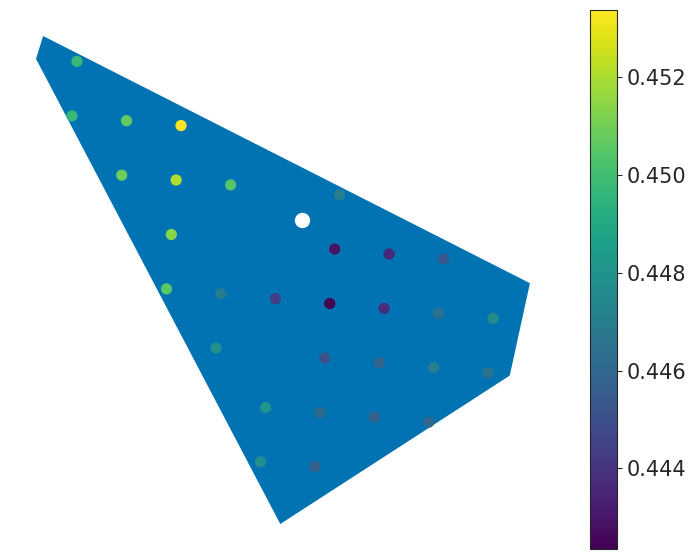

In [52]:
############################################
################# plot one polygon with sites and corresponding bus

fig = plt.figure(figsize=(9, 7))
ax = fig.add_subplot(111)

## polygon
vor_gdf.loc[vor_idx:vor_idx].plot(
    ax=ax,
)

## first_bus or polygon point
# bus_gdf.loc[first_bus:first_bus].plot(ax=ax, color="red", markersize=100, zorder=3)
# wind_gen_location_gdf.loc[wind_gen_location_gdf["FirstBus"]==first_bus].plot(ax=ax, color="red", markersize=100, zorder=3)
points_gdf.loc[vor_idx:vor_idx].plot(ax=ax, markersize=100, color="white")

## sites whithin the polygon
high_gdf.loc[gids_in_polygon].plot(
    ax=ax,
    column="cf_mean",
    cmap="viridis",
    legend=True,
    markersize=50,
    # color="black",
)


ax.set_axis_off()
# change color bar
fig = ax.figure
# # 0'th is for the map, 1st is for colorbar
cb_ax = fig.axes[1]
cb_ax.tick_params(labelsize=15)
# cb_ax.set_ylim((350.0, 500))
# cb_ax.set_ybound((350.0, 500))

# ###
# save_dir = os.path.join(run_dir,"figures")
# filename = "one_polygon_all_sites.png"
# plt.savefig(os.path.join(save_dir,filename),  bbox_inches='tight',   )

In [53]:
#####################################################
### info
### what type of branches bus (e.g., in polygon) has?

bus_num = 163
bus_branch_idxs = branch_df.loc[
    (branch_df["FromBus"] == bus_num) | (branch_df["ToBus"] == bus_num)
].index
bus_branch_idxs
### any of them not a trafo?
print("\n any branches to/from this bus are lines (not trafos)?")
(~branch_df.loc[bus_branch_idxs, "trafo"]).any()
print("\n lines (not trafos) on this bus:")
s = ~branch_df.loc[bus_branch_idxs, "trafo"]
s[s].index

Int64Index([219], dtype='int64', name='UID')


 any branches to/from this bus are lines (not trafos)?


False


 lines (not trafos) on this bus:


Int64Index([], dtype='int64', name='UID')

In [54]:
######################################################################
#### connection dictionary: vor_bus_dict
#### record "connectable" buses in polygons, i.e. buses with lines (not trafos)
#### {vor_idx:[(bus_num, # of lines), (bus_num, # of lines), ..], vor_idx:[(),(),..], ...}
#### based on this dict we will connect wind buses in polygon
#### check if all polygons have connectable bus

vor_bus_dict = {}
for vor_idx in vor_gdf.index[:]:
    #     print("##########################################")
    #     print(f"\n polygon vor_idx = {vor_idx} has buses:")
    #     vor_gdf.loc[vor_idx,"bus_num_list"]

    bus_line_list = []
    for bus_num in vor_gdf.loc[vor_idx, "bus_num_list"]:
        bus_branch_idxs = branch_df.loc[
            (branch_df["FromBus"] == bus_num) | (branch_df["ToBus"] == bus_num)
        ].index
        # bus_branch_idxs
        ### any of them not a trafo?
        # print("\n any branches to/from this bus are lines (not trafos)?")
        s = ~branch_df.loc[bus_branch_idxs, "trafo"]
        if s.any():
            lines_on_bus = s[s].index
            bus_line_list.append((bus_num, len(lines_on_bus)))

    vor_bus_dict[vor_idx] = bus_line_list


print("\n vor_bus_dict:")
print(
    "\n {vor_idx:[(bus_num inside polygon (first), number of lines(not trafos) at that bus),..], ..}"
)
vor_bus_dict


print("\n all polygons have connectable bus?")
len(list(vor_bus_dict.keys())) == len(vor_gdf)


 vor_bus_dict:

 {vor_idx:[(bus_num inside polygon (first), number of lines(not trafos) at that bus),..], ..}


{0: [(1, 3)],
 1: [(3, 2)],
 2: [(5, 2)],
 3: [(7, 3)],
 4: [(9, 4)],
 5: [(11, 3)],
 6: [(14, 2), (15, 1)],
 7: [(17, 2)],
 8: [(22, 2)],
 9: [(25, 2)],
 10: [(27, 3)],
 11: [(29, 2)],
 12: [(31, 2)],
 13: [(34, 2)],
 14: [(36, 2)],
 15: [(39, 2)],
 16: [(41, 3)],
 17: [(42, 2)],
 18: [(43, 2)],
 19: [(44, 2)],
 20: [(45, 3), (46, 2)],
 21: [(47, 2)],
 22: [(48, 2)],
 23: [(54, 3)],
 24: [(55, 5), (56, 1)],
 25: [(57, 2)],
 26: [(58, 3)],
 27: [(59, 2)],
 28: [(60, 2)],
 29: [(61, 2)],
 30: [(62, 2)],
 31: [(63, 2)],
 32: [(64, 2)],
 33: [(65, 4)],
 34: [(73, 2)],
 35: [(74, 2)],
 36: [(79, 2)],
 37: [(80, 2), (81, 1)],
 38: [(82, 3)],
 39: [(83, 2)],
 40: [(84, 2)],
 41: [(85, 4)],
 42: [(86, 1), (87, 3)],
 43: [(88, 2)],
 44: [(92, 3)],
 45: [(94, 2)],
 46: [(95, 3)],
 47: [(96, 2)],
 48: [(97, 1), (98, 1)],
 49: [(99, 5)],
 50: [(100, 5)],
 51: [(101, 3), (102, 3)],
 52: [(103, 2)],
 53: [(104, 3)],
 54: [(105, 2)],
 55: [(106, 2)],
 56: [(107, 2)],
 57: [(108, 2)],
 58: [(109, 2),


 all polygons have connectable bus?


True

In [55]:
####################################################
##### record included capacity and generation of vor polygons
##### how much can we build?

for vor_idx in vor_gdf.index[:]:
    ## take one location
    print("\n voronoi polygon: vor_idx = 0")

    buses_in_polygon = vor_gdf.loc[vor_idx, "bus_num_list"]
    print(f"\n buses in this polygon: bus_num_list = {buses_in_polygon}")

    ### are there buses in the polygon with a true line connected to it (not trafo)

    ## sites within the polygon
    # high_gdf.within(vor_gdf.loc[bus_num, "geometry"])
    # s = high_gdf.within(vor_gdf.loc[vor_gdf["FirstBus"] == first_bus, "geometry"].values[0])
    s = high_gdf.within(vor_gdf.loc[vor_idx, "geometry"])

    #### check if there are any sites in the polygon at all
    if not s.any():
        print("\n !!!!!!!! empty polygon: no sites within it!!!!!!!!!")
        ## in the loop we will simply "continue" onto the next polygon

    gids_in_polygon = s[s].index
    # print("\ngids of sites that are within the polygon:")
    # gids_in_polygon

    print("\n high_df sites within the polygon:")
    sites_in_polygon_df = high_gdf.loc[gids_in_polygon].copy()
    # sites_in_polygon_df

    cap = sites_in_polygon_df["incl_capacity_mw"].sum()
    gen = sites_in_polygon_df["incl_generation_mwh"].sum()

    print(f"\n total included capacity in the polygon: {round(cap,2):,} MW")
    print(f"\n total included generation in the polygon: {round(gen,2):,} MWh")

    ### record polygon capacity and generation
    vor_gdf.loc[vor_idx, "incl_capacity_mw"] = cap
    vor_gdf.loc[vor_idx, "incl_generation_mwh"] = gen


print("\n vor polygons with capacity and generation:")
vor_gdf


 voronoi polygon: vor_idx = 0

 buses in this polygon: bus_num_list = [1, 2]

 high_df sites within the polygon:

 total included capacity in the polygon: 25.36 MW

 total included generation in the polygon: 100,758.2 MWh

 voronoi polygon: vor_idx = 0

 buses in this polygon: bus_num_list = [3, 4]

 high_df sites within the polygon:

 total included capacity in the polygon: 273.35 MW

 total included generation in the polygon: 1,055,695.61 MWh

 voronoi polygon: vor_idx = 0

 buses in this polygon: bus_num_list = [5, 6]

 high_df sites within the polygon:

 total included capacity in the polygon: 189.71 MW

 total included generation in the polygon: 757,559.68 MWh

 voronoi polygon: vor_idx = 0

 buses in this polygon: bus_num_list = [7, 8]

 !!!!!!!! empty polygon: no sites within it!!!!!!!!!

 high_df sites within the polygon:

 total included capacity in the polygon: 0.0 MW

 total included generation in the polygon: 0.0 MWh

 voronoi polygon: vor_idx = 0

 buses in this polygon: 


 high_df sites within the polygon:

 total included capacity in the polygon: 215.3 MW

 total included generation in the polygon: 840,721.9 MWh

 voronoi polygon: vor_idx = 0

 buses in this polygon: bus_num_list = [85]

 !!!!!!!! empty polygon: no sites within it!!!!!!!!!

 high_df sites within the polygon:

 total included capacity in the polygon: 0.0 MW

 total included generation in the polygon: 0.0 MWh

 voronoi polygon: vor_idx = 0

 buses in this polygon: bus_num_list = [86, 87]

 !!!!!!!! empty polygon: no sites within it!!!!!!!!!

 high_df sites within the polygon:

 total included capacity in the polygon: 0.0 MW

 total included generation in the polygon: 0.0 MWh

 voronoi polygon: vor_idx = 0

 buses in this polygon: bus_num_list = [88, 89, 90, 91]

 high_df sites within the polygon:

 total included capacity in the polygon: 246.69 MW

 total included generation in the polygon: 973,404.28 MWh

 voronoi polygon: vor_idx = 0

 buses in this polygon: bus_num_list = [92, 93]

 


 high_df sites within the polygon:

 total included capacity in the polygon: 277.61 MW

 total included generation in the polygon: 1,068,304.61 MWh

 voronoi polygon: vor_idx = 0

 buses in this polygon: bus_num_list = [170]

 high_df sites within the polygon:

 total included capacity in the polygon: 146.22 MW

 total included generation in the polygon: 563,951.7 MWh

 voronoi polygon: vor_idx = 0

 buses in this polygon: bus_num_list = [171]

 high_df sites within the polygon:

 total included capacity in the polygon: 345.77 MW

 total included generation in the polygon: 1,335,488.08 MWh

 voronoi polygon: vor_idx = 0

 buses in this polygon: bus_num_list = [172, 173]

 high_df sites within the polygon:

 total included capacity in the polygon: 129.8 MW

 total included generation in the polygon: 502,422.43 MWh

 voronoi polygon: vor_idx = 0

 buses in this polygon: bus_num_list = [174]

 high_df sites within the polygon:

 total included capacity in the polygon: 332.82 MW

 total i

,geometry,first_bus,Latitude,Longitude,bus_num_list,incl_capacity_mw,incl_generation_mwh
vor_idx,,,,,,,
0,"POLYGON ((-9968402.192 4963402.038, -9961604.3...",1,40.642116,-89.599560,"[1, 2]",25.363458,1.007582e+05
1,"POLYGON ((-9928617.310 4856698.678, -9941824.7...",3,39.866030,-89.251291,"[3, 4]",273.345169,1.055696e+06
2,"POLYGON ((-9816850.173 4937506.501, -9795753.0...",5,40.378337,-88.105151,"[5, 6]",189.714763,7.575597e+05
3,"POLYGON ((-9969296.246 4964677.761, -9969383.7...",7,40.712882,-89.576722,"[7, 8]",0.000000,0.000000e+00
...,...,...,...,...,...,...,...
107,"POLYGON ((-9836619.139 4951507.862, -9856670.9...",189,40.470500,-88.398700,"[189, 190, 191]",180.146889,7.289372e+05
108,"POLYGON ((-9987946.507 4952281.846, -9993611.0...",192,40.556403,-89.762073,[192],140.137352,5.196559e+05
109,"POLYGON ((-9795753.077 4921834.887, -9793568.9...",193,40.306027,-87.958606,[193],454.489589,1.793157e+06
110,"POLYGON ((-9997300.799 4898942.853, -10006110....",194,40.169931,-89.986537,[194],561.304219,2.068735e+06


In [56]:
####################################################
#### info
#### how many polygons meet min build capacity
#### what is total available generation

min_build_cap = 25

df = vor_gdf.loc[vor_gdf["incl_capacity_mw"] > min_build_cap]
print(
    f"\n number of polygons meeting min build capacity of {min_build_cap} MW: {len(df)} out of {len(vor_gdf)} "
)


orig_cap_mw = gen_df["GenMWMax"].sum()
print(f"\n original generation capacity: {round(orig_cap_mw):,} MW")
avail_cap_mw = df["incl_capacity_mw"].sum()
print(
    f"\n available generation capacity: {round(avail_cap_mw):,} MW (~{round(avail_cap_mw/orig_cap_mw)} times total original cap)"
)

print(f"\n total {grid_name} loadP: {round(total_load_mwh):,} MWh")
avail_gen_mwh = df["incl_generation_mwh"].sum()
print(f"\n available generation: {round(avail_gen_mwh):,} MWh")


 number of polygons meeting min build capacity of 25 MW: 89 out of 111 

 original generation capacity: 2,903 MW

 available generation capacity: 28,748 MW (~10 times total original cap)

 total ACTIVSg200 loadP: 8,949,170 MWh

 available generation: 111,978,663 MWh


In [57]:
###########################################
#### decide on connection buses
#### {vor_idx:[(bus_num, # of lines), (bus_num, # of lines), ..], vor_idx:[(),(),..], ...}
#### vor_bus_dict contains all buses inside each polygon and
#### the number of lines (not trafos) connected to them
#### first option: select the connection bus as the bus with most lines connected to it
from operator import itemgetter

vor_gdf["connect_bus"] = 0
# vor_gdf["connect_bus"] = vor_gdf["connect_bus"].astype("int")
for vor_idx in vor_gdf.index[:]:
    print(f"\n vor_idx = {vor_idx}")
    bus_list = vor_bus_dict.get(vor_idx)
    ### gen the bus with max lines
    bus_num, max_n_lines = max(bus_list, key=itemgetter(1))
    print(
        f"\n bus {bus_num} has {max_n_lines} lines(not trafos) connected to it, making it connection bus"
    )
    vor_gdf.loc[vor_idx, "connect_bus"] = bus_num

print(f"\n vor_gdf with connect_bus column:")
vor_gdf


 vor_idx = 0

 bus 1 has 3 lines(not trafos) connected to it, making it connection bus

 vor_idx = 1

 bus 3 has 2 lines(not trafos) connected to it, making it connection bus

 vor_idx = 2

 bus 5 has 2 lines(not trafos) connected to it, making it connection bus

 vor_idx = 3

 bus 7 has 3 lines(not trafos) connected to it, making it connection bus

 vor_idx = 4

 bus 9 has 4 lines(not trafos) connected to it, making it connection bus

 vor_idx = 5

 bus 11 has 3 lines(not trafos) connected to it, making it connection bus

 vor_idx = 6

 bus 14 has 2 lines(not trafos) connected to it, making it connection bus

 vor_idx = 7

 bus 17 has 2 lines(not trafos) connected to it, making it connection bus

 vor_idx = 8

 bus 22 has 2 lines(not trafos) connected to it, making it connection bus

 vor_idx = 9

 bus 25 has 2 lines(not trafos) connected to it, making it connection bus

 vor_idx = 10

 bus 27 has 3 lines(not trafos) connected to it, making it connection bus

 vor_idx = 11

 bus 29 h

,geometry,first_bus,Latitude,Longitude,bus_num_list,incl_capacity_mw,incl_generation_mwh,connect_bus
vor_idx,,,,,,,,
0,"POLYGON ((-9968402.192 4963402.038, -9961604.3...",1,40.642116,-89.599560,"[1, 2]",25.363458,1.007582e+05,1
1,"POLYGON ((-9928617.310 4856698.678, -9941824.7...",3,39.866030,-89.251291,"[3, 4]",273.345169,1.055696e+06,3
2,"POLYGON ((-9816850.173 4937506.501, -9795753.0...",5,40.378337,-88.105151,"[5, 6]",189.714763,7.575597e+05,5
3,"POLYGON ((-9969296.246 4964677.761, -9969383.7...",7,40.712882,-89.576722,"[7, 8]",0.000000,0.000000e+00,7
...,...,...,...,...,...,...,...,...
107,"POLYGON ((-9836619.139 4951507.862, -9856670.9...",189,40.470500,-88.398700,"[189, 190, 191]",180.146889,7.289372e+05,189
108,"POLYGON ((-9987946.507 4952281.846, -9993611.0...",192,40.556403,-89.762073,[192],140.137352,5.196559e+05,192
109,"POLYGON ((-9795753.077 4921834.887, -9793568.9...",193,40.306027,-87.958606,[193],454.489589,1.793157e+06,193
110,"POLYGON ((-9997300.799 4898942.853, -10006110....",194,40.169931,-89.986537,[194],561.304219,2.068735e+06,194


## make new wind_gen_df
* using max available capacity
* later we will limit it depending on wanted total capacity
* will add new buses and trafos so these df's will change:
* bus_df, gen_df, wind_gen_df, branch_df

In [58]:
# ####################################
# #### how much wind can we build where original wind gens were

# s = old_wind_gen_df["BusNum"].values
# s
# wanted_vor_idxs = []
# for wind_bus in s:
#     for vor_idx in vor_gdf.index[:]:
#         bus_num_list = vor_gdf.loc[vor_idx, "bus_num_list"]
#         if wind_bus in bus_num_list:
#             wanted_vor_idxs.append(vor_idx)

# df = vor_gdf.loc[wanted_vor_idxs, ["bus_num_list", "incl_capacity_mw"]].copy()
# df["wind_bus"] = s
# df["GenMWMax"] = old_wind_gen_df["GenMWMax"].values
# df

In [59]:
######################################################
#### first filter
#### filter wind gens by min/max available generation cap
#### max number does not really make sense here, since
#### we can cap it when selecting the sites
####
### BusNum, GenUID, BusName columns will be set later
### once we have have final wind_gen_df (after e.g., after random sample)

########################
##### buildout params
##### min/max capacity for one gen
min_build_cap = 20
max_build_cap = 600

#### polygons with less that 25MW will not get a generator
#### later the actual cap in MW can might be smaller
#### because of required penetration is covered by large number of gens

# min_build_cap = 25

df = vor_gdf.loc[
    (vor_gdf["incl_capacity_mw"] > min_build_cap)
    & (vor_gdf["incl_capacity_mw"] < max_build_cap)
]
print(
    f"\n number of polygons meeting min build capacity of {min_build_cap} MW: {len(df)} out of {len(vor_gdf)} "
)

min_cap_vor_idxs = df.index
print("\n voronoi polygons meeting min/max cap:")
min_cap_vor_idxs

### preallocate new wind_gen_df
df = pd.DataFrame(index=min_cap_vor_idxs, columns=old_wind_gen_df.columns)

###
# ### new gen will get a new bus, start with len(bus_df)
# new_bus_num = len(bus_df)
# ### preallocate
# vor_gdf["new_bus_num"]=0

#### building new wind gens
print("\n building new wind gens:")
for vor_idx in min_cap_vor_idxs[:]:
    print(f"\n vor_idx = {vor_idx}")
    #     ###
    #     new_bus_num+=1
    #     ### new bus with wind gen on it
    #     df.loc[vor_idx,"BusNum"]=new_bus_num
    #     ### record to vor_gdf too
    #     vor_gdf.loc[vor_idx,"new_bus_num"]=new_bus_num

    ### not really needed
    df.loc[vor_idx, "GenID"] = 1
    df.loc[vor_idx, "GenMWMax"] = vor_gdf.loc[vor_idx, "incl_capacity_mw"]
    df.loc[vor_idx, "GenMWMin"] = 0
    ### include also annual generation (later we will drop it)
    df.loc[vor_idx, "incl_generation_mwh"] = vor_gdf.loc[vor_idx, "incl_generation_mwh"]
    df.loc[vor_idx, "GenWindPowerFactor"] = 1
    df.loc[vor_idx, "GenFuelType"] = "Wind"
    ###
    # df.loc[vor_idx,"GenUID"]=f"{new_bus_num}_Wind_1"
    # df.loc[vor_idx,"BusName"]=f"NEWWIND{new_bus_num}"

    first_bus = vor_gdf.loc[vor_idx, "first_bus"]
    print(f"\n first_bus = {first_bus}")
    lat, lon, zone = bus_df.loc[
        bus_df["BusNum"] == first_bus, ["Latitude", "Longitude", "Zone"]
    ].values[0]
    df.loc[vor_idx, "Latitude"] = lat
    df.loc[vor_idx, "Longitude"] = lon
    df.loc[vor_idx, "Zone"] = int(zone)


wind_gen_df = df
### reset index
wind_gen_df.reset_index(inplace=True)

# ### set correct types
# int_columns = ["BusNum","GenID","Zone"]
# float_columns = ["GenMWMax","GenMWMin","GenWindPowerFactor","Latitude","Longitude","incl_generation_mwh"]
# wind_gen_df[int_columns]=wind_gen_df[int_columns].astype("int")
# wind_gen_df[float_columns]=wind_gen_df[float_columns].astype("float")


 number of polygons meeting min build capacity of 20 MW: 78 out of 111 

 voronoi polygons meeting min/max cap:


Int64Index([  0,   1,   2,   7,   9,  11,  12,  13,  14,  15,  17,  18,  20,
             21,  22,  23,  24,  25,  26,  28,  29,  30,  31,  32,  33,  34,
             35,  36,  37,  38,  39,  40,  43,  45,  46,  48,  51,  52,  53,
             55,  58,  60,  61,  62,  63,  65,  68,  69,  70,  72,  73,  76,
             77,  78,  79,  80,  81,  83,  84,  86,  88,  90,  91,  92,  93,
             94,  95,  96,  98,  99, 100, 101, 102, 104, 107, 108, 109, 110],
           dtype='int64', name='vor_idx')


 building new wind gens:

 vor_idx = 0

 first_bus = 1

 vor_idx = 1

 first_bus = 3

 vor_idx = 2

 first_bus = 5

 vor_idx = 7

 first_bus = 17

 vor_idx = 9

 first_bus = 25

 vor_idx = 11

 first_bus = 29

 vor_idx = 12

 first_bus = 31

 vor_idx = 13

 first_bus = 34

 vor_idx = 14

 first_bus = 36

 vor_idx = 15

 first_bus = 39

 vor_idx = 17

 first_bus = 42

 vor_idx = 18

 first_bus = 43

 vor_idx = 20

 first_bus = 45

 vor_idx = 21

 first_bus = 47

 vor_idx = 22

 first_bus = 48

 vor_idx = 23

 first_bus = 54

 vor_idx = 24

 first_bus = 55

 vor_idx = 25

 first_bus = 57

 vor_idx = 26

 first_bus = 58

 vor_idx = 28

 first_bus = 60

 vor_idx = 29

 first_bus = 61

 vor_idx = 30

 first_bus = 62

 vor_idx = 31

 first_bus = 63

 vor_idx = 32

 first_bus = 64

 vor_idx = 33

 first_bus = 65

 vor_idx = 34

 first_bus = 73

 vor_idx = 35

 first_bus = 74

 vor_idx = 36

 first_bus = 79

 vor_idx = 37

 first_bus = 80

 vor_idx = 38

 first_bus = 82

 vor_idx = 39

 first

In [60]:
print("\n possible new wind_gen_df:")
wind_gen_df

#### show possible wind gens
plot_title = "possible new wind gen capacities"
wind_gen_df["GenMWMax"].iplot(kind="bar", yTitle="MW", title=plot_title)


 possible new wind_gen_df:


,vor_idx,BusNum,GenID,GenMWMax,GenMWMin,GenWindPowerFactor,GenFuelType,GenUID,BusName,Latitude,Longitude,Zone,incl_generation_mwh
0,0,NaN,1,25.363458,0,1,Wind,NaN,NaN,40.642116,-89.59956,2,1.007582e+05
1,1,NaN,1,273.345169,0,1,Wind,NaN,NaN,39.86603,-89.251291,4,1.055696e+06
2,2,NaN,1,189.714763,0,1,Wind,NaN,NaN,40.378337,-88.105151,6,7.575597e+05
3,7,NaN,1,396.668698,0,1,Wind,NaN,NaN,40.17288,-89.558457,4,1.510114e+06
...,...,...,...,...,...,...,...,...,...,...,...,...,...
74,107,NaN,1,180.146889,0,1,Wind,NaN,NaN,40.4705,-88.3987,6,7.289372e+05
75,108,NaN,1,140.137352,0,1,Wind,NaN,NaN,40.556403,-89.762073,2,5.196559e+05
76,109,NaN,1,454.489589,0,1,Wind,NaN,NaN,40.306027,-87.958606,6,1.793157e+06
77,110,NaN,1,561.304219,0,1,Wind,NaN,NaN,40.169931,-89.986537,4,2.068735e+06


In [61]:
######################################################################
#### filter wind_gen_df by location (might need this in the future)
#### e.g., wind gens only above lat=4.90e6 (in Mercantor crs)

In [62]:
######################################################################
#### filter wind_gen_df by some other factor (might need this in the future)
#### e.g., no wind gens where loads are located (in the same polygon)

# buildout options

In [63]:
######################################################################
#### Option 2
#### filter wind_gen_df by selecting random number (in selected range) of generators
#### that meet some total wind capacity (in selected range)
buildout_option = 2
### random seed for n_gens (for reproducibility)
random_seed = 2
random.seed(random_seed)

### posible generator number range
n_gens_max = 20
n_gens_min = 10

### possible total capacity range
target_wind_cap = 2000
delta_wind_cap = 100

### sanity check?
### n_gens can be (after filtering by min/max capacity)
print(f"n_gens < max avail wind generators: {n_gens_max<len(wind_gen_df)}")

### randomly select n_gens in (n_gens_min, n_gens_max) until
### selected wind cap is around target wind cap (within delta)


################################################################
################################################################
max_iterations = 10e3
k = 0
while True:
    k += 1
    if k > max_iterations:
        print("\n max number of iterations reached without success!")
        break
    # random.seed(10)
    n_gens = random.randint(n_gens_min, n_gens_max)
    # print(f"\n sample n_gens: {n_gens}")
    sample_df = wind_gen_df.sample(n_gens, random_state=k)
    sample_cap = sample_df["GenMWMax"].sum()
    if (target_wind_cap - delta_wind_cap < sample_cap) and (
        sample_cap < target_wind_cap + delta_wind_cap
    ):
        print("\n Got it!")
        print(f"\n sample_cap = {round(sample_cap,2)} MW")
        break
print(f"\n wind_gen_df:")
wind_gen_df = sample_df.reset_index(drop=True)
wind_gen_df

#######################################################
################################################
#### check what penetration we got (if we select all sites)

total_load_mwh = loadP_df.sum().sum() / 12
print(f"\n total {grid_name} loadP (year 2017): {round(total_load_mwh):,} MWh")
# total_needed_cap_mw = total_load_mwh

max_avail_gen_mwh = wind_gen_df["incl_generation_mwh"].sum()
print(f"\n max available wind annual generation: {round(max_avail_gen_mwh):,} MWh")

resulting_penetration_level = max_avail_gen_mwh / total_load_mwh
print(f"\n resulting penetration level: {round(resulting_penetration_level,4)}")

n_gens < max avail wind generators: True

 Got it!

 sample_cap = 1968.17 MW

 wind_gen_df:


,vor_idx,BusNum,GenID,GenMWMax,GenMWMin,GenWindPowerFactor,GenFuelType,GenUID,BusName,Latitude,Longitude,Zone,incl_generation_mwh
0,43,NaN,1,246.694011,0,1,Wind,NaN,NaN,40.120833,-88.961111,7,9.734043e+05
1,98,NaN,1,393.682205,0,1,Wind,NaN,NaN,39.96082,-88.434724,5,1.523061e+06
2,101,NaN,1,137.268369,0,1,Wind,NaN,NaN,40.1719,-88.8339,7,5.385635e+05
3,76,NaN,1,96.669832,0,1,Wind,NaN,NaN,40.136481,-88.305307,5,3.822558e+05
...,...,...,...,...,...,...,...,...,...,...,...,...,...
7,69,NaN,1,26.518775,0,1,Wind,NaN,NaN,40.5408,-89.6786,2,9.544040e+04
8,107,NaN,1,180.146889,0,1,Wind,NaN,NaN,40.4705,-88.3987,6,7.289372e+05
9,25,NaN,1,280.672452,0,1,Wind,NaN,NaN,39.981254,-89.283539,4,1.082313e+06
10,94,NaN,1,345.768605,0,1,Wind,NaN,NaN,40.430677,-89.203945,7,1.335488e+06



 total ACTIVSg200 loadP (year 2017): 8,949,170 MWh

 max available wind annual generation: 7,687,334 MWh

 resulting penetration level: 0.859


In [64]:
# random.seed(1)
# for k in range(10):
#     df = wind_gen_df.sample(3, random_state=1)
#     df
#     random.randint(n_gens_min,n_gens_max)

In [65]:
# ####################################################################
# #### limit wind_gen_df capacities to meet penetration level
# #### e.g., set 60% renewable penetration, that is 60% of load (mwh) a year is covered by
# #### wind if all of it is dispatched.


# #####################################################################################
# #### Option 1: use all wind gens (after min cap selection)
# #### let all wind gens produce the same amound of mwh's that sum to target_generation
# #### gen capacities will be sligtly different because of cap factors

# random_seed = None
# # ### choose penetration level
# penetration_level = 0.6

# total_load_mwh = loadP_df.sum().sum() / 12
# print(f"\n total {grid_name} loadP (year 2017): {round(total_load_mwh):,} MWh")
# #total_needed_cap_mw = total_load_mwh

# max_avail_gen_mwh = wind_gen_df["incl_generation_mwh"].sum()
# print(f"\n max available wind annual generation: {round(max_avail_gen_mwh):,} MWh")

# print(f"\n penetration level: {round(penetration_level,4)}")
# target_generation = total_load_mwh*penetration_level
# print(f"\n target generation: {round(target_generation):,} MWh")


# ### make all generators of equal size
# n_gens = len(wind_gen_df)
# print(f"\n total number of new gens: {n_gens}")

# ### n_gens have to all produce the same amount of energy
# mwh_per_gen = target_generation / n_gens
# print(f"\n each wind gen will produce {round(mwh_per_gen):,} MWh")

# ### factor to multiply capacities by
# x = mwh_per_gen / wind_gen_df["incl_generation_mwh"]

# ### new capacities
# new_cap = wind_gen_df["GenMWMax"] * x

# #### adjust wind_gen_df
# wind_gen_df["GenMWMax"]=new_cap
# wind_gen_df["incl_generation_mwh"]=mwh_per_gen


# ### final wind_gen_df
# print("\n final wind_gen_df:")
# wind_gen_df

In [66]:
wind_gen_df

,vor_idx,BusNum,GenID,GenMWMax,GenMWMin,GenWindPowerFactor,GenFuelType,GenUID,BusName,Latitude,Longitude,Zone,incl_generation_mwh
0,43,NaN,1,246.694011,0,1,Wind,NaN,NaN,40.120833,-88.961111,7,9.734043e+05
1,98,NaN,1,393.682205,0,1,Wind,NaN,NaN,39.96082,-88.434724,5,1.523061e+06
2,101,NaN,1,137.268369,0,1,Wind,NaN,NaN,40.1719,-88.8339,7,5.385635e+05
3,76,NaN,1,96.669832,0,1,Wind,NaN,NaN,40.136481,-88.305307,5,3.822558e+05
...,...,...,...,...,...,...,...,...,...,...,...,...,...
7,69,NaN,1,26.518775,0,1,Wind,NaN,NaN,40.5408,-89.6786,2,9.544040e+04
8,107,NaN,1,180.146889,0,1,Wind,NaN,NaN,40.4705,-88.3987,6,7.289372e+05
9,25,NaN,1,280.672452,0,1,Wind,NaN,NaN,39.981254,-89.283539,4,1.082313e+06
10,94,NaN,1,345.768605,0,1,Wind,NaN,NaN,40.430677,-89.203945,7,1.335488e+06


In [67]:
####################################################
#### once wind_gen_df is final, finish filling out
#### BusNum, GenUID, BusName columns


# ### new gen will get a new bus, start with len(bus_df)
new_bus_num = len(bus_df)
# ### preallocate
# vor_gdf["new_bus_num"]=0

#### building new wind gens
print("\n building new wind gens:")
for gen_idx in wind_gen_df.index[:]:
    ###
    new_bus_num += 1
    ### new bus with wind gen on it
    wind_gen_df.loc[gen_idx, "BusNum"] = new_bus_num

    wind_gen_df.loc[gen_idx, "GenUID"] = f"{new_bus_num}_Wind_1"
    wind_gen_df.loc[gen_idx, "BusName"] = f"NEWWIND{new_bus_num}"

### set correct types
int_columns = ["BusNum", "GenID", "Zone"]
float_columns = [
    "GenMWMax",
    "GenMWMin",
    "GenWindPowerFactor",
    "Latitude",
    "Longitude",
    "incl_generation_mwh",
]
wind_gen_df[int_columns] = wind_gen_df[int_columns].astype("int")
wind_gen_df[float_columns] = wind_gen_df[float_columns].astype("float")

print("\n new wind_gen_df:")
wind_gen_df


 building new wind gens:

 new wind_gen_df:


,vor_idx,BusNum,GenID,GenMWMax,GenMWMin,GenWindPowerFactor,GenFuelType,GenUID,BusName,Latitude,Longitude,Zone,incl_generation_mwh
0,43,195,1,246.694011,0.0,1.0,Wind,195_Wind_1,NEWWIND195,40.120833,-88.961111,7,9.734043e+05
1,98,196,1,393.682205,0.0,1.0,Wind,196_Wind_1,NEWWIND196,39.960820,-88.434724,5,1.523061e+06
2,101,197,1,137.268369,0.0,1.0,Wind,197_Wind_1,NEWWIND197,40.171900,-88.833900,7,5.385635e+05
3,76,198,1,96.669832,0.0,1.0,Wind,198_Wind_1,NEWWIND198,40.136481,-88.305307,5,3.822558e+05
...,...,...,...,...,...,...,...,...,...,...,...,...,...
7,69,202,1,26.518775,0.0,1.0,Wind,202_Wind_1,NEWWIND202,40.540800,-89.678600,2,9.544040e+04
8,107,203,1,180.146889,0.0,1.0,Wind,203_Wind_1,NEWWIND203,40.470500,-88.398700,6,7.289372e+05
9,25,204,1,280.672452,0.0,1.0,Wind,204_Wind_1,NEWWIND204,39.981254,-89.283539,4,1.082313e+06
10,94,205,1,345.768605,0.0,1.0,Wind,205_Wind_1,NEWWIND205,40.430677,-89.203945,7,1.335488e+06


## buildout one gen
* for testing purposes
* select sites
* plot available and selected sites in the polygon


 building out gen_idx=2 in polygon vor_idx=101 to 137.26836913559032 MW capacity

 connect_bus = 182

high_df sites within the polygon, vor_idx=101, sites_in_polygon_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1651982,0.450897,40.187054,-88.914090,43448.465,POINT (-9897871.223 4893161.805),0.421488,18312.989380,4.636364
1651983,0.450744,40.205536,-88.911960,43433.645,POINT (-9897634.113 4895855.318),0.595041,25844.813554,6.545455
1653204,0.450548,40.148470,-88.894226,43414.812,POINT (-9895659.973 4887541.050),0.307851,13365.303694,3.386364
1653205,0.451372,40.166943,-88.892060,43494.210,POINT (-9895418.855 4890231.720),0.386364,16804.581136,4.250000
...,...,...,...,...,...,...,...,...
1659318,0.446430,40.140182,-88.773410,43017.950,POINT (-9882210.797 4886334.105),0.371901,15998.411157,4.090909
1659319,0.445336,40.158653,-88.771210,42912.586,POINT (-9881965.894 4889024.156),0.277883,11924.669456,3.056711
1660539,0.446516,40.120045,-88.751434,43026.324,POINT (-9879764.440 4883402.257),0.206694,8893.292258,2.273636
1660540,0.447651,40.138508,-88.749240,43135.680,POINT (-9879520.205 4886090.346),0.533597,23017.062451,5.869565



total incl capacity in the polygon:


137.26836913559032


 dist_s:


gid
1656875     1.644532
1656876     1.696007
1654430     3.008823
1655651     3.142400
             ...    
1655648     9.270747
1656871     9.332548
1650758     9.533387
1650759    10.394408
Name: dist_to_connect_bus, Length: 30, dtype: float64


 selected_sites_gdf


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx
gid,,,,,,,,,,
1656875,0.442937,40.161983,-88.81955,42681.360,POINT (-9887347.078 4889509.203),0.270751,11556.020395,2.978261,1.644532,2
1656876,0.447075,40.180454,-88.81738,43080.137,POINT (-9887105.515 4892200.118),0.334711,14419.384698,3.681818,1.696007,2
1654430,0.450403,40.183760,-88.86572,43400.840,POINT (-9892486.699 4892681.824),0.516529,22417.789256,5.681818,3.008823,2
1655651,0.444384,40.145176,-88.84589,42820.840,POINT (-9890279.234 4887061.341),0.292490,12524.672569,3.217391,3.142400,2
...,...,...,...,...,...,...,...,...,...,...
1655648,0.447709,40.089760,-88.85239,43141.200,POINT (-9891002.811 4878994.544),0.221074,9537.414050,2.431818,9.270747,2
1656871,0.445717,40.088108,-88.82825,42949.320,POINT (-9888315.558 4878754.167),0.475207,20409.800826,5.227273,9.332548,2
1650758,0.449690,40.207165,-88.93616,43332.152,POINT (-9900328.044 4896092.759),0.580579,25157.716347,6.386364,9.533387,2
1650759,0.449746,40.225643,-88.93399,43337.543,POINT (-9900086.481 4898786.488),0.632231,27399.355698,6.954545,10.394408,2


<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

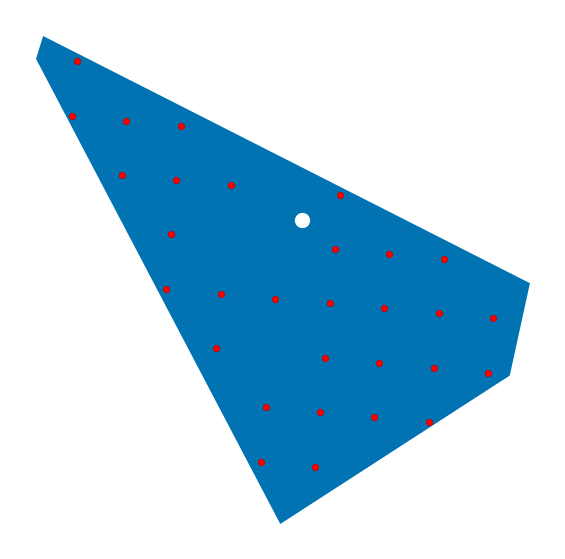

In [68]:
###############################################
#### buildout one new wind gen
####

## take one gen
gen_idx = 2

gen_cap = wind_gen_df.loc[gen_idx, "GenMWMax"]

vor_idx = wind_gen_df.loc[gen_idx, "vor_idx"]
connect_bus = vor_gdf.loc[vor_idx, "connect_bus"]
bus_lat = bus_gdf.loc[connect_bus, "Latitude"]
bus_lon = bus_gdf.loc[connect_bus, "Longitude"]

print(
    f"\n building out gen_idx={gen_idx} in polygon vor_idx={vor_idx} to {gen_cap} MW capacity"
)
print(f"\n connect_bus = {connect_bus}")

## sites within the polygon
# high_gdf.within(vor_gdf.loc[bus_num, "geometry"])
s = high_gdf.within(vor_gdf.loc[vor_idx:vor_idx, "geometry"].values[0])

gids_in_polygon = s[s].index
# print("\ngids of sites that are within the polygon:")
# gids_in_polygon

print(f"\nhigh_df sites within the polygon, vor_idx={vor_idx}, sites_in_polygon_df:")
sites_in_polygon_df = high_gdf.loc[gids_in_polygon].copy()
sites_in_polygon_df

print("\ntotal incl capacity in the polygon:")
sites_in_polygon_df["incl_capacity_mw"].sum()


#### compute site distances to connect bus
for gid in sites_in_polygon_df.index[:]:
    site_lat = sites_in_polygon_df.loc[gid, "latitude"]
    site_lon = sites_in_polygon_df.loc[gid, "longitude"]
    # print("\nsite lat/lon: {}, {}".format(site_lat, site_lon))
    d = distance(bus_lat, bus_lon, site_lat, site_lon)
    # print("\ndistance: {}".format(d))
    sites_in_polygon_df.loc[gid, "dist_to_connect_bus"] = d


dist_s = sites_in_polygon_df["dist_to_connect_bus"]
dist_s = dist_s.sort_values()
print("\n dist_s:")
dist_s

#### select neareast sites up to gen cap
selected_sites_gids = []
selected_cap = 0
for gid in dist_s.index:
    selected_sites_gids.append(gid)
    cap = sites_in_polygon_df.loc[gid, "incl_capacity_mw"]
    selected_cap += cap
    if selected_cap > gen_cap:
        break

selected_sites_gdf = sites_in_polygon_df.loc[selected_sites_gids].copy()
selected_sites_gdf["gen_idx"] = gen_idx
print(f"\n selected_sites_gdf")
selected_sites_gdf


############################################
################# quick plot
fig = plt.figure(figsize=(9, 7))
ax = fig.add_subplot(111)

## polygon
vor_gdf.loc[vor_idx:vor_idx].plot(ax=ax)

## first_bus
# points_gdf.loc[vor_idx:vor_idx].plot(ax=ax, color="white", markersize=100, zorder=3)
bus_gdf.loc[connect_bus:connect_bus].plot(
    ax=ax, color="white", markersize=100, zorder=3
)
# wind_gen_location_gdf.loc[wind_gen_location_gdf["FirstBus"]==first_bus].plot(ax=ax, color="red", markersize=100, zorder=3)

# ## sites whithin the polygon
high_gdf.loc[gids_in_polygon].plot(ax=ax, markersize=15, color="black")
# high_gdf.loc[gids_in_polygon].plot(
#     ax=ax,
#     column="cf_mean",
#     cmap="viridis",
#     legend=True,
#     markersize=15,
#     # color="black",
# )

### selected sites
selected_sites_gdf.plot(ax=ax, markersize=15, color="red")


ax.set_axis_off()
# change color bar
fig = ax.figure
# # 0'th is for the map, 1st is for colorbar
# cb_ax = fig.axes[1]
# cb_ax.tick_params(labelsize=15)

# cb_ax.set_ylim((350.0, 500))
# cb_ax.set_ybound((350.0, 500))

## buildout all gens
* should work for options all options of wind_gen_df creation above
* all gens in new_wind_gen_df
* capture magic tag suppresses the printing statement

In [69]:
# %%capture

all_selected_sites_gdf = gpd.GeoDataFrame()

for gen_idx in wind_gen_df.index[:]:
    gen_uid = wind_gen_df.loc[gen_idx, "GenUID"]
    gen_cap = wind_gen_df.loc[gen_idx, "GenMWMax"]
    vor_idx = wind_gen_df.loc[gen_idx, "vor_idx"]
    connect_bus = vor_gdf.loc[vor_idx, "connect_bus"]
    bus_lat = bus_gdf.loc[connect_bus, "Latitude"]
    bus_lon = bus_gdf.loc[connect_bus, "Longitude"]

    print(
        f"\n building out gen_idx={gen_idx} in polygon vor_idx={vor_idx} to {gen_cap} MW capacity"
    )
    print(f"\n connect_bus = {connect_bus}")

    ## sites within the polygon
    # high_gdf.within(vor_gdf.loc[bus_num, "geometry"])
    s = high_gdf.within(vor_gdf.loc[vor_idx:vor_idx, "geometry"].values[0])

    gids_in_polygon = s[s].index
    # print("\ngids of sites that are within the polygon:")
    # gids_in_polygon

    print(
        f"\nhigh_df sites within the polygon, vor_idx={vor_idx}, sites_in_polygon_df:"
    )
    sites_in_polygon_df = high_gdf.loc[gids_in_polygon].copy()
    sites_in_polygon_df

    print("\ntotal incl capacity in the polygon:")
    sites_in_polygon_df["incl_capacity_mw"].sum()

    #### compute site distances to connect bus
    for gid in sites_in_polygon_df.index[:]:
        site_lat = sites_in_polygon_df.loc[gid, "latitude"]
        site_lon = sites_in_polygon_df.loc[gid, "longitude"]
        # print("\nsite lat/lon: {}, {}".format(site_lat, site_lon))
        d = distance(bus_lat, bus_lon, site_lat, site_lon)
        # print("\ndistance: {}".format(d))
        sites_in_polygon_df.loc[gid, "dist_to_connect_bus"] = d

    dist_s = sites_in_polygon_df["dist_to_connect_bus"]
    dist_s = dist_s.sort_values()
    print("\n dist_s:")
    dist_s

    #### select neareast sites up to gen cap
    selected_sites_gids = []
    selected_cap = 0
    for gid in dist_s.index:
        selected_sites_gids.append(gid)
        cap = sites_in_polygon_df.loc[gid, "incl_capacity_mw"]
        selected_cap += cap
        if selected_cap >= gen_cap:
            break

    selected_sites_gdf = sites_in_polygon_df.loc[selected_sites_gids].copy()
    selected_sites_gdf["gen_idx"] = gen_idx
    selected_sites_gdf["gen_uid"] = gen_uid
    print(f"\n selected_sites_gdf")
    selected_sites_gdf

    #### concat to all_gdf
    all_selected_sites_gdf = pd.concat([all_selected_sites_gdf, selected_sites_gdf])

selected_gdf = all_selected_sites_gdf
print(f"\n selected_gdf:")
selected_gdf


 building out gen_idx=0 in polygon vor_idx=43 to 246.6940105688263 MW capacity

 connect_bus = 88

high_df sites within the polygon, vor_idx=43, sites_in_polygon_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1651973,0.447804,40.020810,-88.93335,43150.440,POINT (-9900015.237 4868966.793),0.469008,20237.912975,5.159091
1651974,0.450868,40.039290,-88.93121,43445.676,POINT (-9899777.013 4871653.439),0.582645,25313.389736,6.409091
1651975,0.451712,40.057750,-88.92908,43526.965,POINT (-9899539.902 4874337.904),0.365702,15917.919019,4.022727
1651976,0.452253,40.076230,-88.92694,43579.100,POINT (-9899301.679 4877026.007),0.535124,23320.220868,5.886364
...,...,...,...,...,...,...,...,...
1650753,0.445854,40.114800,-88.94684,42962.523,POINT (-9901516.936 4882638.753),0.499649,21466.171358,5.496136
1650754,0.449380,40.133274,-88.94470,43302.280,POINT (-9901278.713 4885328.236),0.246198,10660.949762,2.708182
1650756,0.450525,40.170216,-88.94043,43412.613,POINT (-9900803.379 4890708.523),0.700413,30406.768196,7.704545
1650757,0.449274,40.188698,-88.93829,43292.020,POINT (-9900565.155 4893401.367),0.638340,27635.024625,7.021739



total incl capacity in the polygon:


246.6940105688263


 dist_s:


gid
1650753     1.387023
1650754     1.965448
1650752     2.914457
1648303     3.225812
             ...    
1649522    12.960353
1650747    12.999293
1648296    13.248000
1649521    15.019726
Name: dist_to_connect_bus, Length: 54, dtype: float64


 selected_sites_gdf


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,gen_uid
gid,,,,,,,,,,,
1650753,0.445854,40.114800,-88.946840,42962.523,POINT (-9901516.936 4882638.753),0.499649,21466.171358,5.496136,1.387023,0,195_Wind_1
1650754,0.449380,40.133274,-88.944700,43302.280,POINT (-9901278.713 4885328.236),0.246198,10660.949762,2.708182,1.965448,0,195_Wind_1
1650752,0.448898,40.096330,-88.948975,43255.836,POINT (-9901754.604 4879950.583),0.368933,15958.496965,4.058261,2.914457,0,195_Wind_1
1648303,0.447230,40.136524,-88.993010,43095.074,POINT (-9906656.557 4885801.454),0.397233,17118.794217,4.369565,3.225812,0,195_Wind_1
...,...,...,...,...,...,...,...,...,...,...,...
1649522,0.449594,40.005604,-88.983700,43322.870,POINT (-9905620.173 4866756.671),0.373518,16181.862510,4.108696,12.960353,0,195_Wind_1
1650747,0.447194,40.003970,-88.959595,43091.650,POINT (-9902936.817 4866519.206),0.510269,21988.315704,5.612955,12.999293,0,195_Wind_1
1648296,0.451649,40.007217,-89.007810,43520.887,POINT (-9908304.086 4866991.090),0.407025,17714.080039,4.477273,13.248000,0,195_Wind_1
1649521,0.449059,39.987133,-88.985840,43271.330,POINT (-9905858.397 4864072.658),0.452479,19579.382789,4.977273,15.019726,0,195_Wind_1



 building out gen_idx=1 in polygon vor_idx=98 to 393.68220484619354 MW capacity

 connect_bus = 178

high_df sites within the polygon, vor_idx=98, sites_in_polygon_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1678785,0.442725,39.891243,-88.414550,42661.004,POINT (-9842262.685 4850150.572),0.216942,9254.969876,2.386364
1678786,0.442934,39.909695,-88.412260,42681.125,POINT (-9842007.763 4852828.068),0.462810,19753.247934,5.090909
1678787,0.443240,39.928154,-88.409970,42710.560,POINT (-9841752.841 4855507.301),0.508507,21718.602344,5.593573
1678788,0.442236,39.946610,-88.407684,42613.848,POINT (-9841498.365 4858186.821),0.505929,21559.575273,5.565217
...,...,...,...,...,...,...,...,...
1677575,0.439804,39.966816,-88.429474,42379.510,POINT (-9843924.017 4861121.242),0.547431,23199.850336,6.021739
1677576,0.439418,39.985270,-88.427185,42342.320,POINT (-9843669.206 4863801.987),0.535124,22658.390248,5.886364
1677577,0.439465,40.003730,-88.424930,42346.883,POINT (-9843418.181 4866484.328),0.469008,19861.038101,5.159091
1677578,0.439277,40.022182,-88.422610,42328.740,POINT (-9843159.920 4869166.231),0.570248,24137.876529,6.272727



total incl capacity in the polygon:


393.68220484619354


 dist_s:


gid
1677575     0.803196
1677574     1.408777
1676361     1.821001
1676360     2.158961
             ...    
1669062    15.084645
1671493    15.317605
1670277    15.361379
1672708    15.821507
Name: dist_to_connect_bus, Length: 79, dtype: float64


 selected_sites_gdf


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,gen_uid
gid,,,,,,,,,,,
1677575,0.439804,39.966816,-88.429474,42379.510,POINT (-9843924.017 4861121.242),0.547431,23199.850336,6.021739,0.803196,1,196_Wind_1
1677574,0.440221,39.948360,-88.431760,42419.684,POINT (-9844178.493 4858440.931),0.378099,16038.847463,4.159091,1.408777,1,196_Wind_1
1676361,0.438540,39.968555,-88.453550,42257.758,POINT (-9846604.145 4861373.829),0.409091,17287.264636,4.500000,1.821001,1,196_Wind_1
1676360,0.438879,39.950108,-88.455840,42290.355,POINT (-9846859.066 4858694.757),0.278926,11795.863481,3.068182,2.158961,1,196_Wind_1
...,...,...,...,...,...,...,...,...,...,...,...
1669062,0.447488,39.923553,-88.604800,43119.977,POINT (-9863441.218 4854839.421),0.415289,17907.263176,4.568182,15.084645,1,196_Wind_1
1671493,0.441715,39.864746,-88.563354,42563.656,POINT (-9858827.470 4846306.959),0.454545,19347.116364,5.000000,15.317605,1,196_Wind_1
1670277,0.442053,39.884926,-88.585175,42596.203,POINT (-9861256.573 4849234.103),0.472332,20119.550429,5.195652,15.361379,1,196_Wind_1
1672708,0.440883,39.844566,-88.541565,42483.445,POINT (-9856401.930 4843380.676),0.702479,29843.742355,7.727273,15.821507,1,196_Wind_1



 building out gen_idx=2 in polygon vor_idx=101 to 137.26836913559032 MW capacity

 connect_bus = 182

high_df sites within the polygon, vor_idx=101, sites_in_polygon_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1651982,0.450897,40.187054,-88.914090,43448.465,POINT (-9897871.223 4893161.805),0.421488,18312.989380,4.636364
1651983,0.450744,40.205536,-88.911960,43433.645,POINT (-9897634.113 4895855.318),0.595041,25844.813554,6.545455
1653204,0.450548,40.148470,-88.894226,43414.812,POINT (-9895659.973 4887541.050),0.307851,13365.303694,3.386364
1653205,0.451372,40.166943,-88.892060,43494.210,POINT (-9895418.855 4890231.720),0.386364,16804.581136,4.250000
...,...,...,...,...,...,...,...,...
1659318,0.446430,40.140182,-88.773410,43017.950,POINT (-9882210.797 4886334.105),0.371901,15998.411157,4.090909
1659319,0.445336,40.158653,-88.771210,42912.586,POINT (-9881965.894 4889024.156),0.277883,11924.669456,3.056711
1660539,0.446516,40.120045,-88.751434,43026.324,POINT (-9879764.440 4883402.257),0.206694,8893.292258,2.273636
1660540,0.447651,40.138508,-88.749240,43135.680,POINT (-9879520.205 4886090.346),0.533597,23017.062451,5.869565



total incl capacity in the polygon:


137.26836913559032


 dist_s:


gid
1656875     1.644532
1656876     1.696007
1654430     3.008823
1655651     3.142400
             ...    
1655648     9.270747
1656871     9.332548
1650758     9.533387
1650759    10.394408
Name: dist_to_connect_bus, Length: 30, dtype: float64


 selected_sites_gdf


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,gen_uid
gid,,,,,,,,,,,
1656875,0.442937,40.161983,-88.81955,42681.360,POINT (-9887347.078 4889509.203),0.270751,11556.020395,2.978261,1.644532,2,197_Wind_1
1656876,0.447075,40.180454,-88.81738,43080.137,POINT (-9887105.515 4892200.118),0.334711,14419.384698,3.681818,1.696007,2,197_Wind_1
1654430,0.450403,40.183760,-88.86572,43400.840,POINT (-9892486.699 4892681.824),0.516529,22417.789256,5.681818,3.008823,2,197_Wind_1
1655651,0.444384,40.145176,-88.84589,42820.840,POINT (-9890279.234 4887061.341),0.292490,12524.672569,3.217391,3.142400,2,197_Wind_1
...,...,...,...,...,...,...,...,...,...,...,...
1655648,0.447709,40.089760,-88.85239,43141.200,POINT (-9891002.811 4878994.544),0.221074,9537.414050,2.431818,9.270747,2,197_Wind_1
1656871,0.445717,40.088108,-88.82825,42949.320,POINT (-9888315.558 4878754.167),0.475207,20409.800826,5.227273,9.332548,2,197_Wind_1
1650758,0.449690,40.207165,-88.93616,43332.152,POINT (-9900328.044 4896092.759),0.580579,25157.716347,6.386364,9.533387,2,197_Wind_1
1650759,0.449746,40.225643,-88.93399,43337.543,POINT (-9900086.481 4898786.488),0.632231,27399.355698,6.954545,10.394408,2,197_Wind_1



 building out gen_idx=3 in polygon vor_idx=76 to 96.66983158618318 MW capacity

 connect_bus = 138

high_df sites within the polygon, vor_idx=76, sites_in_polygon_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1684862,0.450039,40.159237,-88.25934,43365.785,POINT (-9824984.787 4889109.220),0.254132,11020.643709,2.795455
1684863,0.449905,40.177690,-88.25699,43352.880,POINT (-9824723.186 4891797.403),0.258893,11223.769328,2.847826
1684864,0.449953,40.196148,-88.25464,43357.473,POINT (-9824461.585 4894487.047),0.483471,20962.084054,5.318182
1684865,0.451388,40.214607,-88.25232,43495.742,POINT (-9824203.324 4897177.568),0.504132,21927.605471,5.545455
...,...,...,...,...,...,...,...,...
1683650,0.458357,40.161020,-88.28351,44167.254,POINT (-9827675.379 4889368.931),0.204545,9034.211045,2.250000
1683651,0.457434,40.179470,-88.28116,44078.350,POINT (-9827413.778 4892056.748),0.418972,18467.609091,4.608696
1683652,0.455276,40.197933,-88.27881,43870.375,POINT (-9827152.177 4894747.190),0.496047,21761.786808,5.456522
1683653,0.454703,40.216396,-88.27649,43815.160,POINT (-9826893.916 4897438.365),0.555336,24332.134308,6.108696



total incl capacity in the polygon:


96.66983158618318


 dist_s:


gid
1682437     0.959876
1681225     2.673614
1681224     2.822642
1683650     3.299147
             ...    
1686075     9.049417
1683653     9.220140
1684865     9.787451
1686076    10.727959
Name: dist_to_connect_bus, Length: 25, dtype: float64


 selected_sites_gdf


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,gen_uid
gid,,,,,,,,,,,
1682437,0.453915,40.144340,-88.309970,43739.285,POINT (-9830620.892 4886939.598),0.247934,10844.450826,2.727273,0.959876,3,198_Wind_1
1681225,0.448049,40.146122,-88.334110,43173.992,POINT (-9833308.145 4887199.106),0.260331,11239.510314,2.863636,2.673614,3,198_Wind_1
1681224,0.444734,40.127655,-88.336426,42854.594,POINT (-9833565.961 4884510.133),0.258264,11067.818698,2.840909,2.822642,3,198_Wind_1
1683650,0.458357,40.161020,-88.283510,44167.254,POINT (-9827675.379 4889368.931),0.204545,9034.211045,2.250000,3.299147,3,198_Wind_1
...,...,...,...,...,...,...,...,...,...,...,...
1686075,0.444739,40.194347,-88.230470,42855.074,POINT (-9821770.993 4894224.578),0.202479,8677.267050,2.227273,9.049417,3,198_Wind_1
1683653,0.454703,40.216396,-88.276490,43815.160,POINT (-9826893.916 4897438.365),0.555336,24332.134308,6.108696,9.220140,3,198_Wind_1
1684865,0.451388,40.214607,-88.252320,43495.742,POINT (-9824203.324 4897177.568),0.504132,21927.605471,5.545455,9.787451,3,198_Wind_1
1686076,0.446477,40.212814,-88.228150,43022.490,POINT (-9821512.732 4896916.194),0.395257,17004.936759,4.347826,10.727959,3,198_Wind_1



 building out gen_idx=4 in polygon vor_idx=13 to 105.39674127857019 MW capacity

 connect_bus = 34

high_df sites within the polygon, vor_idx=13, sites_in_polygon_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1644603,0.435100,39.753506,-89.109314,41926.223,POINT (-9919603.459 4830186.831),0.463617,19437.692991,5.099783
1644604,0.434419,39.771960,-89.107240,41860.590,POINT (-9919372.583 4832859.253),0.471074,19719.451488,5.181818
1644605,0.434033,39.790430,-89.105160,41823.457,POINT (-9919141.038 4835534.710),0.252066,10542.276351,2.772727
1644606,0.432445,39.808890,-89.103090,41670.360,POINT (-9918910.607 4838209.435),0.210744,8781.770083,2.318182
...,...,...,...,...,...,...,...,...
1648290,0.445948,39.896410,-89.020480,42971.527,POINT (-9909714.504 4850900.262),0.216942,9322.335403,2.386364
1643375,0.437699,39.736626,-89.135376,42176.695,POINT (-9922504.668 4827742.976),0.338843,14291.276818,3.727273
1643376,0.436693,39.755085,-89.133300,42079.766,POINT (-9922273.569 4830415.467),0.315475,13275.122873,3.470227
1643377,0.434868,39.773552,-89.131256,41903.895,POINT (-9922046.032 4833089.833),0.471074,19739.851364,5.181818



total incl capacity in the polygon:


105.39674127857019


 dist_s:


gid
1647059     2.510143
1645833     3.495252
1647062     3.727842
1645836     4.450220
             ...    
1643376    10.882343
1647066    11.960802
1643375    12.585476
1647067    14.021254
Name: dist_to_connect_bus, Length: 25, dtype: float64


 selected_sites_gdf


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,gen_uid
gid,,,,,,,,,,,
1647059,0.434825,39.805702,-89.054990,41899.734,POINT (-9913556.139 4837747.465),0.235537,9868.945612,2.590909,2.510143,4,199_Wind_1
1645833,0.434372,39.807293,-89.079040,41856.035,POINT (-9916233.373 4837978.013),0.278656,11663.440583,3.065217,3.495252,4,199_Wind_1
1647062,0.446412,39.861090,-89.048740,43016.312,POINT (-9912860.393 4845776.742),0.351779,15132.220427,3.869565,3.727842,4,199_Wind_1
1645836,0.449058,39.862694,-89.072784,43271.215,POINT (-9915536.958 4846009.361),0.241107,10432.980692,2.652174,4.450220,4,199_Wind_1
...,...,...,...,...,...,...,...,...,...,...,...
1643376,0.436693,39.755085,-89.133300,42079.766,POINT (-9922273.569 4830415.467),0.315475,13275.122873,3.470227,10.882343,4,199_Wind_1
1647066,0.451426,39.934963,-89.040344,43499.420,POINT (-9911925.754 4856495.776),0.367769,15997.720579,4.045455,11.960802,4,199_Wind_1
1643375,0.437699,39.736626,-89.135376,42176.695,POINT (-9922504.668 4827742.976),0.338843,14291.276818,3.727273,12.585476,4,199_Wind_1
1647067,0.447441,39.953426,-89.038240,43115.426,POINT (-9911691.538 4859176.579),0.320248,13807.626095,3.522727,14.021254,4,199_Wind_1



 building out gen_idx=5 in polygon vor_idx=11 to 38.55138339920948 MW capacity

 connect_bus = 29

high_df sites within the polygon, vor_idx=11, sites_in_polygon_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1613846,0.416222,40.512585,-89.635376,40107.156,POINT (-9978164.413 4940711.727),0.214190,8590.540647,2.356087
1615076,0.421099,40.474113,-89.614960,40577.080,POINT (-9975891.715 4935080.184),0.200413,8132.183388,2.204545
1615077,0.426619,40.492615,-89.613010,41109.023,POINT (-9975674.642 4937788.110),0.252964,10399.120443,2.782609
1615078,0.433839,40.511110,-89.611084,41804.770,POINT (-9975460.240 4940495.757),0.280992,11746.794876,3.090909
...,...,...,...,...,...,...,...,...
1617543,0.453418,40.508137,-89.562410,43691.350,POINT (-9970041.875 4940060.463),0.258264,11283.923037,2.840909
1617544,0.457940,40.526638,-89.560455,44127.062,POINT (-9969824.246 4942769.615),0.258264,11396.451963,2.840909
1617546,0.463236,40.563625,-89.556520,44637.473,POINT (-9969386.204 4948187.968),0.319407,14257.526455,3.513478
1617547,0.460443,40.582123,-89.554565,44368.266,POINT (-9969168.574 4950898.926),0.311983,13842.165632,3.431818



total incl capacity in the polygon:


38.55138339920948


 dist_s:


gid
1615078    3.199390
1613846    3.307228
1616310    4.249819
1617544    5.091838
             ...   
1617542    7.167681
1617547    7.188022
1615076    7.261084
1616308    7.780974
Name: dist_to_connect_bus, Length: 12, dtype: float64


 selected_sites_gdf


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,gen_uid
gid,,,,,,,,,,,
1615078,0.433839,40.511110,-89.611084,41804.770,POINT (-9975460.240 4940495.757),0.280992,11746.794876,3.090909,3.199390,5,200_Wind_1
1613846,0.416222,40.512585,-89.635376,40107.156,POINT (-9978164.413 4940711.727),0.214190,8590.540647,2.356087,3.307228,5,200_Wind_1
1616310,0.449621,40.509624,-89.586730,43325.500,POINT (-9972749.165 4940278.181),0.206612,8951.549587,2.272727,4.249819,5,200_Wind_1
1617544,0.457940,40.526638,-89.560455,44127.062,POINT (-9969824.246 4942769.615),0.258264,11396.451963,2.840909,5.091838,5,200_Wind_1
...,...,...,...,...,...,...,...,...,...,...,...
1617542,0.445578,40.489647,-89.564360,42935.906,POINT (-9970258.948 4937353.667),0.434783,18667.785217,4.782609,7.167681,5,200_Wind_1
1617547,0.460443,40.582123,-89.554565,44368.266,POINT (-9969168.574 4950898.926),0.311983,13842.165632,3.431818,7.188022,5,200_Wind_1
1615076,0.421099,40.474113,-89.614960,40577.080,POINT (-9975891.715 4935080.184),0.200413,8132.183388,2.204545,7.261084,5,200_Wind_1
1616308,0.431087,40.472630,-89.590640,41539.547,POINT (-9973184.425 4934863.167),0.501976,20851.867466,5.521739,7.780974,5,200_Wind_1



 building out gen_idx=6 in polygon vor_idx=52 to 116.80095076473621 MW capacity

 connect_bus = 103

high_df sites within the polygon, vor_idx=52, sites_in_polygon_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1650776,0.463167,40.539787,-88.897400,44630.773,POINT (-9896013.301 4944695.515),0.456612,20378.927341,5.022727
1650779,0.455036,40.595238,-88.890930,43847.312,POINT (-9895293.064 4952821.438),0.223140,9784.110942,2.454545
1650780,0.455286,40.613720,-88.888760,43871.320,POINT (-9895051.500 4955531.332),0.371542,16300.016126,4.086957
1650781,0.454950,40.632210,-88.886600,43838.938,POINT (-9894811.050 4958243.149),0.811983,35596.493045,8.931818
...,...,...,...,...,...,...,...,...
1649552,0.462316,40.559906,-88.919586,44548.773,POINT (-9898483.035 4947643.023),0.396694,17672.240529,4.363636
1649553,0.458455,40.578396,-88.917420,44176.766,POINT (-9898241.917 4950352.658),0.487713,21545.568295,5.364839
1649554,0.455886,40.596878,-88.915280,43929.180,POINT (-9898003.693 4953061.870),0.401186,17623.761937,4.413043
1649555,0.454314,40.615360,-88.913120,43777.710,POINT (-9897763.243 4955771.830),0.471074,20622.557603,5.181818



total incl capacity in the polygon:


116.80095076473621


 dist_s:


gid
1652003    1.071928
1652002    1.141009
1653227    2.655212
1653226    2.684732
             ...   
1653224    5.750525
1649555    6.337423
1655673    6.676954
1650781    7.378360
Name: dist_to_connect_bus, Length: 23, dtype: float64


 selected_sites_gdf


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,gen_uid
gid,,,,,,,,,,,
1652003,0.457245,40.575108,-88.868744,44060.098,POINT (-9892823.330 4949870.761),0.349174,15384.620996,3.840909,1.071928,6,201_Wind_1
1652002,0.459389,40.556625,-88.870910,44266.727,POINT (-9893064.448 4947162.284),0.473140,20944.381163,5.204545,1.141009,6,201_Wind_1
1653227,0.458503,40.573452,-88.844420,44181.324,POINT (-9890115.594 4949628.062),0.611570,27019.983273,6.727273,2.655212,6,201_Wind_1
1653226,0.460174,40.554970,-88.846590,44342.400,POINT (-9890357.158 4946919.799),0.620553,27516.825296,6.826087,2.684732,6,201_Wind_1
...,...,...,...,...,...,...,...,...,...,...,...
1653224,0.467094,40.518010,-88.850950,45009.152,POINT (-9890842.510 4941506.100),0.487955,21962.420305,5.367500,5.750525,6,201_Wind_1
1649555,0.454314,40.615360,-88.913120,43777.710,POINT (-9897763.243 4955771.830),0.471074,20622.557603,5.181818,6.337423,6,201_Wind_1
1655673,0.459288,40.551647,-88.797940,44256.973,POINT (-9884941.464 4946432.942),0.393195,17401.607531,4.325142,6.676954,6,201_Wind_1
1650781,0.454950,40.632210,-88.886600,43838.938,POINT (-9894811.050 4958243.149),0.811983,35596.493045,8.931818,7.378360,6,201_Wind_1



 building out gen_idx=7 in polygon vor_idx=69 to 26.51877470355731 MW capacity

 connect_bus = 128

high_df sites within the polygon, vor_idx=69, sites_in_polygon_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1608921,0.405748,40.481430,-89.736540,39097.895,POINT (-9989425.938 4936151.000),0.383399,14990.102036,4.217391
1608922,0.402022,40.499935,-89.734620,38738.812,POINT (-9989212.205 4938859.660),0.291322,11285.480355,3.204545
1610151,0.409733,40.479980,-89.712220,39481.867,POINT (-9986718.648 4935938.789),0.223140,8810.003380,2.454545
1611382,0.414695,40.478527,-89.687900,39959.965,POINT (-9984011.358 4935726.143),0.371901,14861.144008,4.090909
1611383,0.416232,40.497017,-89.685974,40108.098,POINT (-9983796.957 4938432.490),0.473140,18976.765376,5.204545
1611384,0.411035,40.515514,-89.684050,39607.348,POINT (-9983582.778 4941140.608),0.452479,17921.506636,4.977273
1612614,0.414089,40.495556,-89.661650,39901.574,POINT (-9981089.222 4938218.619),0.215415,8595.398352,2.369565



total incl capacity in the polygon:


26.51877470355731


 dist_s:


gid
1611384    2.850050
1611383    4.909729
1612614    5.232596
1608922    6.564851
1611382    6.971123
1610151    7.338161
1608921    8.222927
Name: dist_to_connect_bus, dtype: float64


 selected_sites_gdf


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,gen_uid
gid,,,,,,,,,,,
1611384,0.411035,40.515514,-89.684050,39607.348,POINT (-9983582.778 4941140.608),0.452479,17921.506636,4.977273,2.850050,7,202_Wind_1
1611383,0.416232,40.497017,-89.685974,40108.098,POINT (-9983796.957 4938432.490),0.473140,18976.765376,5.204545,4.909729,7,202_Wind_1
1612614,0.414089,40.495556,-89.661650,39901.574,POINT (-9981089.222 4938218.619),0.215415,8595.398352,2.369565,5.232596,7,202_Wind_1
1608922,0.402022,40.499935,-89.734620,38738.812,POINT (-9989212.205 4938859.660),0.291322,11285.480355,3.204545,6.564851,7,202_Wind_1
1611382,0.414695,40.478527,-89.687900,39959.965,POINT (-9984011.358 4935726.143),0.371901,14861.144008,4.090909,6.971123,7,202_Wind_1
1610151,0.409733,40.479980,-89.712220,39481.867,POINT (-9986718.648 4935938.789),0.223140,8810.003380,2.454545,7.338161,7,202_Wind_1
1608921,0.405748,40.481430,-89.736540,39097.895,POINT (-9989425.938 4936151.000),0.383399,14990.102036,4.217391,8.222927,7,202_Wind_1



 building out gen_idx=8 in polygon vor_idx=107 to 180.14688949991407 MW capacity

 connect_bus = 189

high_df sites within the polygon, vor_idx=107, sites_in_polygon_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1670307,0.467856,40.438877,-88.517550,45082.617,POINT (-9853728.592 4929925.158),0.553719,24963.101975,6.090909
1670308,0.472003,40.457344,-88.515290,45482.246,POINT (-9853477.010 4932626.542),0.357708,16269.340960,3.934783
1671523,0.458439,40.418670,-88.495575,44175.227,POINT (-9851282.346 4926970.093),0.475207,20992.359938,5.227273
1671524,0.467696,40.437134,-88.493286,45067.176,POINT (-9851027.536 4929670.227),0.654150,29480.702087,7.195652
...,...,...,...,...,...,...,...,...
1676390,0.459108,40.504030,-88.386960,44239.600,POINT (-9839191.380 4939459.165),0.440454,19485.494896,4.844991
1676391,0.465268,40.522500,-88.384640,44833.273,POINT (-9838933.119 4942163.612),0.365613,16391.611670,4.021739
1676392,0.470473,40.540970,-88.382324,45334.797,POINT (-9838675.303 4944868.804),0.583004,26430.365840,6.413043
1676393,0.471821,40.559444,-88.380005,45464.640,POINT (-9838417.153 4947575.329),0.401186,18239.766640,4.413043



total incl capacity in the polygon:


180.14688949991407


 dist_s:


gid
1675173     1.463738
1676389     1.855059
1675174     2.254376
1675172     2.780506
             ...    
1676393    10.018736
1671523    10.024113
1670307    10.656346
1676383    10.657557
Name: dist_to_connect_bus, Length: 38, dtype: float64


 selected_sites_gdf


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,gen_uid
gid,,,,,,,,,,,
1675173,0.454913,40.468840,-88.415860,43835.406,POINT (-9842408.513 4934308.572),0.413989,18147.360896,4.553875,1.463738,8,203_Wind_1
1676389,0.453680,40.485560,-88.389280,43716.633,POINT (-9839449.641 4936755.462),0.520661,22761.552719,5.727273,1.855059,8,203_Wind_1
1675174,0.458846,40.487316,-88.413574,44214.440,POINT (-9842154.037 4937012.479),0.483471,21376.402810,5.318182,2.254376,8,203_Wind_1
1675172,0.450488,40.450370,-88.418180,43409.008,POINT (-9842666.774 4931606.286),0.357708,15527.728158,3.934783,2.780506,8,203_Wind_1
...,...,...,...,...,...,...,...,...,...,...,...
1676393,0.471821,40.559444,-88.380005,45464.640,POINT (-9838417.153 4947575.329),0.401186,18239.766640,4.413043,10.018736,8,203_Wind_1
1671523,0.458439,40.418670,-88.495575,44175.227,POINT (-9851282.346 4926970.093),0.475207,20992.359938,5.227273,10.024113,8,203_Wind_1
1670307,0.467856,40.438877,-88.517550,45082.617,POINT (-9853728.592 4929925.158),0.553719,24963.101975,6.090909,10.656346,8,203_Wind_1
1676383,0.444856,40.374744,-88.403140,42866.355,POINT (-9840992.529 4920549.430),0.444664,19061.126235,4.891304,10.657557,8,203_Wind_1



 building out gen_idx=9 in polygon vor_idx=25 to 280.67245231139367 MW capacity

 connect_bus = 57

high_df sites within the polygon, vor_idx=25, sites_in_polygon_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1627388,0.438367,40.070866,-89.413940,42241.023,POINT (-9953514.271 4876245.684),0.221074,9338.407977,2.431818
1628620,0.441461,40.032383,-89.393800,42539.200,POINT (-9951272.296 4870649.205),0.719008,30586.036364,7.909091
1628621,0.437994,40.050865,-89.391785,42205.066,POINT (-9951047.987 4873336.598),0.421488,17788.912116,4.636364
1628622,0.435958,40.069347,-89.389800,42008.870,POINT (-9950827.018 4876024.720),0.418972,17600.554229,4.608696
...,...,...,...,...,...,...,...,...
1637244,0.439612,39.984604,-89.228970,42361.027,POINT (-9932923.504 4863705.227),0.458678,19430.057839,5.045455
1637245,0.441481,40.003075,-89.226930,42541.098,POINT (-9932696.413 4866389.140),0.483471,20567.390355,5.318182
1637246,0.441832,40.021553,-89.224884,42574.945,POINT (-9932468.653 4869074.797),0.473140,20143.930589,5.204545
1637247,0.439645,40.040020,-89.222840,42364.168,POINT (-9932241.116 4871759.582),0.262397,11116.217636,2.886364



total incl capacity in the polygon:


280.67245231139367


 dist_s:


gid
1634783     0.898853
1634782     1.385522
1633551     1.759366
1633550     2.049529
             ...    
1628622    13.339016
1629858    13.528898
1628623    14.811239
1627388    14.923582
Name: dist_to_connect_bus, Length: 66, dtype: float64


 selected_sites_gdf


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,gen_uid
gid,,,,,,,,,,,
1634783,0.446191,39.987724,-89.277220,42994.984,POINT (-9938294.670 4864158.525),0.280992,12081.235174,3.090909,0.898853,9,204_Wind_1
1634782,0.443665,39.969242,-89.279236,42751.600,POINT (-9938519.090 4861473.617),0.418972,17911.737549,4.608696,1.385522,9,204_Wind_1
1633551,0.445028,39.989277,-89.301330,42882.895,POINT (-9940978.583 4864384.165),0.258264,11075.127841,2.840909,1.759366,9,204_Wind_1
1633550,0.445245,39.970806,-89.303345,42903.848,POINT (-9941202.892 4861700.793),0.258264,11080.539256,2.840909,2.049529,9,204_Wind_1
...,...,...,...,...,...,...,...,...,...,...,...
1628622,0.435958,40.069347,-89.389800,42008.870,POINT (-9950827.018 4876024.720),0.418972,17600.554229,4.608696,13.339016,9,204_Wind_1
1629858,0.435694,40.086285,-89.363650,41983.516,POINT (-9947916.013 4878488.914),0.384298,16134.161107,4.227273,13.528898,9,204_Wind_1
1628623,0.433914,40.087820,-89.387820,41812.000,POINT (-9950606.606 4878712.261),0.235537,9848.280992,2.590909,14.811239,9,204_Wind_1
1627388,0.438367,40.070866,-89.413940,42241.023,POINT (-9953514.271 4876245.684),0.221074,9338.407977,2.431818,14.923582,9,204_Wind_1



 building out gen_idx=10 in polygon vor_idx=94 to 345.7686050008592 MW capacity

 connect_bus = 171

high_df sites within the polygon, vor_idx=94, sites_in_polygon_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1629879,0.436466,40.474470,-89.321230,42057.844,POINT (-9943193.841 4935132.427),0.321002,13500.647428,3.531021
1629880,0.439160,40.492958,-89.319214,42317.450,POINT (-9942969.421 4937838.318),0.551653,23344.543698,6.068182
1637263,0.437804,40.335700,-89.189940,42186.836,POINT (-9928578.705 4914845.881),0.535124,22575.187033,5.886364
1637264,0.436333,40.354170,-89.187870,42045.010,POINT (-9928348.273 4917543.567),0.735537,30925.668512,8.090909
...,...,...,...,...,...,...,...,...
1636040,0.439985,40.466663,-89.199740,42396.960,POINT (-9929669.636 4933990.024),0.390496,16555.837686,4.295455
1636041,0.442614,40.485153,-89.197660,42650.300,POINT (-9929438.091 4936695.892),0.398760,17007.247727,4.386364
1636042,0.450672,40.503640,-89.195590,43426.754,POINT (-9929207.660 4939402.067),0.685950,29788.599851,7.545455
1636043,0.460001,40.522133,-89.193510,44325.664,POINT (-9928976.115 4942109.867),0.495083,21944.866958,5.445909



total incl capacity in the polygon:


345.7686050008592


 dist_s:


gid
1636038     0.110019
1636039     1.955132
1634807     2.050368
1637268     2.083681
             ...    
1633580    11.007152
1629879    11.057663
1631114    11.586399
1629880    11.964527
Name: dist_to_connect_bus, Length: 63, dtype: float64


 selected_sites_gdf


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,gen_uid
gid,,,,,,,,,,,
1636038,0.435310,40.429690,-89.203860,41946.434,POINT (-9930128.272 4928581.544),0.431550,18101.987557,4.747051,0.110019,10,205_Wind_1
1636039,0.437406,40.448177,-89.201780,42148.460,POINT (-9929896.727 4931285.485),0.400826,16894.217438,4.409091,1.955132,10,205_Wind_1
1634807,0.435643,40.431255,-89.228150,41978.530,POINT (-9932832.222 4928810.415),0.302996,12719.321125,3.332955,2.050368,10,205_Wind_1
1637268,0.437051,40.428123,-89.179565,42114.240,POINT (-9927423.765 4928352.386),0.455227,19171.550618,5.007500,2.083681,10,205_Wind_1
...,...,...,...,...,...,...,...,...,...,...,...
1633580,0.457716,40.525270,-89.242160,44105.550,POINT (-9934391.808 4942569.270),0.444215,19592.341426,4.886364,11.007152,10,205_Wind_1
1629879,0.436466,40.474470,-89.321230,42057.844,POINT (-9943193.841 4935132.427),0.321002,13500.647428,3.531021,11.057663,10,205_Wind_1
1631114,0.446819,40.509900,-89.292850,43055.470,POINT (-9940034.593 4940318.591),0.432806,18634.679704,4.760870,11.586399,10,205_Wind_1
1629880,0.439160,40.492958,-89.319214,42317.450,POINT (-9942969.421 4937838.318),0.551653,23344.543698,6.068182,11.964527,10,205_Wind_1



 selected_gdf:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,gen_uid
gid,,,,,,,,,,,
1650753,0.445854,40.114800,-88.946840,42962.523,POINT (-9901516.936 4882638.753),0.499649,21466.171358,5.496136,1.387023,0,195_Wind_1
1650754,0.449380,40.133274,-88.944700,43302.280,POINT (-9901278.713 4885328.236),0.246198,10660.949762,2.708182,1.965448,0,195_Wind_1
1650752,0.448898,40.096330,-88.948975,43255.836,POINT (-9901754.604 4879950.583),0.368933,15958.496965,4.058261,2.914457,0,195_Wind_1
1648303,0.447230,40.136524,-88.993010,43095.074,POINT (-9906656.557 4885801.454),0.397233,17118.794217,4.369565,3.225812,0,195_Wind_1
...,...,...,...,...,...,...,...,...,...,...,...
1633580,0.457716,40.525270,-89.242160,44105.550,POINT (-9934391.808 4942569.270),0.444215,19592.341426,4.886364,11.007152,10,205_Wind_1
1629879,0.436466,40.474470,-89.321230,42057.844,POINT (-9943193.841 4935132.427),0.321002,13500.647428,3.531021,11.057663,10,205_Wind_1
1631114,0.446819,40.509900,-89.292850,43055.470,POINT (-9940034.593 4940318.591),0.432806,18634.679704,4.760870,11.586399,10,205_Wind_1
1629880,0.439160,40.492958,-89.319214,42317.450,POINT (-9942969.421 4937838.318),0.551653,23344.543698,6.068182,11.964527,10,205_Wind_1


In [70]:
##############################################################################
#### selected capacities/generation
#### target and resulting penetration
#### because sites are discrete, we can go overboard for each gen by upto 11MW
#### so resulting penetration goes over target penetration
#### overshoot will be smaller the smaler the number of wind gens

# print(f"\n selected_gdf:")
# selected_gdf
#### save selected_gdf
filename = "selected_gdf.csv"
selected_gdf.to_csv(os.path.join(work_dir, filename))

df = selected_gdf[["gen_uid", "incl_capacity_mw"]].groupby("gen_uid").sum()
df.rename(columns={"incl_capacity_mw": "selected_capacity_mw"}, inplace=True)
df2 = wind_gen_df[["GenMWMax", "GenUID"]].set_index("GenUID")
df["desired_capacity_mw"] = df2["GenMWMax"]
df
df.sum()

total_load_mwh = loadP_df.sum().sum() / 12
print(f"\n total {grid_name} loadP (year 2017): {round(total_load_mwh):,} MWh")

### for option 1 only
# print(f"\n target penetration level: {round(penetration_level,4)}")
# target_generation = total_load_mwh * penetration_level
# print(f"\n target generation: {round(target_generation):,} MWh")


selected_generation = selected_gdf["incl_generation_mwh"].sum()
print(f"\n selected generation: {round(selected_generation):,} MWh")
resulting_penetration_level = selected_generation / total_load_mwh
print(f"\n resulting penetration level: {round(resulting_penetration_level,4)}")

,selected_capacity_mw,desired_capacity_mw
gen_uid,,
195_Wind_1,246.694011,246.694011
196_Wind_1,393.682205,393.682205
197_Wind_1,137.268369,137.268369
198_Wind_1,96.669832,96.669832
...,...,...
202_Wind_1,26.518775,26.518775
203_Wind_1,180.146889,180.146889
204_Wind_1,280.672452,280.672452
205_Wind_1,345.768605,345.768605


selected_capacity_mw    1968.170213
desired_capacity_mw     1968.170213
dtype: float64


 total ACTIVSg200 loadP (year 2017): 8,949,170 MWh

 selected generation: 7,687,334 MWh

 resulting penetration level: 0.859


## save_dir

In [71]:
level_int = int(round(resulting_penetration_level, 2) * 100)

if buildout_option == 2:
    save_dir = f"option{buildout_option}_seed{random_seed}-ngens{len(wind_gen_df)}-pen{level_int}"
else:
    save_dir = f"ngens{len(wind_gen_df)}-pen{level_int}"

save_dir = os.path.join(work_dir, save_dir)

if not os.path.exists(save_dir):
    os.makedirs(save_dir)
print(f"\n saving to:\n {save_dir}/")


 saving to:
 /projects/exasgd/isatkaus/buildout/wind/wind_gen_tamu5/buildouts/work-dir/option2_seed2-ngens11-pen86/


## save buildout params
* for reproducability

In [72]:
params_dict = {
    "min_build_cap": min_build_cap,
    "max_build_cap": max_build_cap,
    "buildout_option": buildout_option,
    "random_seed": random_seed,
    "n_gens_max": n_gens_max,
    "n_gens_min": n_gens_min,
    "target_wind_cap": target_wind_cap,
    "delta_wind_cap": delta_wind_cap,
}

print("\n parameters dict:")
params_dict

import yaml

filename = os.path.join(save_dir, "parameters.yaml")
print("\n dumping parameters to:")
filename
with open(filename, "w+") as file:
    yaml.dump(params_dict, file, allow_unicode=True)


 parameters dict:


{'min_build_cap': 20,
 'max_build_cap': 600,
 'buildout_option': 2,
 'random_seed': 2,
 'n_gens_max': 20,
 'n_gens_min': 10,
 'target_wind_cap': 2000,
 'delta_wind_cap': 100}


 dumping parameters to:


'/projects/exasgd/isatkaus/buildout/wind/wind_gen_tamu5/buildouts/work-dir/option2_seed2-ngens11-pen86/parameters.yaml'

In [73]:
import datetime

### also can write readme describing the configuration
now = datetime.datetime.now().strftime("%Y-%m-%d %H:%M:%S")

### string for buildout_option = 2
msg = f"""
experiment date: {now}
{grid_name} grid

first, fiter possible buildout polygons by:
min_build_cap={min_build_cap} MW and max_build_cap={max_build_cap} MW

buildout_option=2:
random number of generators between n_gens_min={n_gens_min} and n_gens_max={n_gens_max}
achieving total wind capacity of target_wind_cap={target_wind_cap} MW +/- delta_wind_cap={delta_wind_cap} MW
NOTE: all available sites in randomly chosen polygons are selected, i.e.,
when randomly selecting gens, taking into account generation of all sites in 
the corresponding polygon (see figures)
use random_seed={random_seed}

all parameters are recorded in parameters.yml

connection procedure:
when multiple buses are available in one voronoi polygon new wind generators are connected
to a bus with most transmission lines comming/leaving to/from it

"""
print("\n readme.txt message:")
print(msg)

# quick readme to know what experiment we're running

filename = os.path.join(save_dir, "readme.txt")
with open(filename, "w") as f:
    f.write(msg)


 readme.txt message:

experiment date: 2023-09-12 14:28:11
ACTIVSg200 grid

first, fiter possible buildout polygons by:
min_build_cap=20 MW and max_build_cap=600 MW

buildout_option=2:
random number of generators between n_gens_min=10 and n_gens_max=20
achieving total wind capacity of target_wind_cap=2000 MW +/- delta_wind_cap=100 MW
NOTE: all available sites in randomly chosen polygons are selected, i.e.,
when randomly selecting gens, taking into account generation of all sites in 
the corresponding polygon (see figures)
use random_seed=2

all parameters are recorded in parameters.yml

connection procedure:
when multiple buses are available in one voronoi polygon new wind generators are connected
to a bus with most transmission lines comming/leaving to/from it




752

# modify grid files
* add new buses to bus_df
* add new wind generators to gen_df
* add new branches (trafos) branch_df
* helpfull notebook for gens and their original connections:
* /user/isatkaus/notebooks/projects/ecp/powerscenarios/notebooks/eagle_dev/tamu200_generator_connections.ipynb

In [74]:
df = wind_gen_df[["BusNum", "BusName", "Latitude", "Longitude", "Zone"]]
final_bus_df = pd.concat([bus_df, df]).reset_index(drop=True)
###
print("\n final_bus_df:")
final_bus_df


 final_bus_df:


,BusNum,BusName,Latitude,Longitude,Zone
0,1,CREVECOEUR0,40.642116,-89.599560,2
1,2,CREVECOEUR1,40.642116,-89.599560,2
2,3,ILLIOPOLIS0,39.866030,-89.251291,4
3,4,ILLIOPOLIS1,39.866030,-89.251291,4
...,...,...,...,...,...
201,202,NEWWIND202,40.540800,-89.678600,2
202,203,NEWWIND203,40.470500,-88.398700,6
203,204,NEWWIND204,39.981254,-89.283539,4
204,205,NEWWIND205,40.430677,-89.203945,7


In [75]:
df = wind_gen_df.drop(["vor_idx", "incl_generation_mwh"], axis=1)
final_gen_df = pd.concat([gen_df, df]).reset_index(drop=True)
print("\n final_gen_df:")
final_gen_df


 final_gen_df:


,BusNum,GenID,GenMWMax,GenMWMin,GenWindPowerFactor,GenFuelType,GenUID,BusName,Latitude,Longitude,Zone
0,49,1,4.530000,1.36,1.0,Coal,49_Coal_1,RANTOUL21,40.312222,-88.159444,6
1,50,1,4.530000,1.36,1.0,Coal,50_Coal_1,RANTOUL22,40.312222,-88.159444,6
2,51,1,4.530000,1.36,1.0,Coal,51_Coal_1,RANTOUL23,40.312222,-88.159444,6
3,52,1,4.530000,1.36,1.0,Coal,52_Coal_1,RANTOUL24,40.312222,-88.159444,6
...,...,...,...,...,...,...,...,...,...,...,...
50,202,1,26.518775,0.00,1.0,Wind,202_Wind_1,NEWWIND202,40.540800,-89.678600,2
51,203,1,180.146889,0.00,1.0,Wind,203_Wind_1,NEWWIND203,40.470500,-88.398700,6
52,204,1,280.672452,0.00,1.0,Wind,204_Wind_1,NEWWIND204,39.981254,-89.283539,4
53,205,1,345.768605,0.00,1.0,Wind,205_Wind_1,NEWWIND205,40.430677,-89.203945,7


In [76]:
#####################################################
#### modify branch_df connect new generators
#### see below for gen connecting branch rateA analysis
#### all gen buses are "FromBuses" (not that it matters)

uid = len(branch_df)
df = branch_df.copy()
rateA_min = 20
### rateA = rateA_factor * GenMWMax (we'll draw U random from possible range, see below)
rateA_factor = 1.3
for gen_idx in wind_gen_df.index[:]:
    uid += 1
    ### corresponding vor polygon
    vor_idx = wind_gen_df.loc[gen_idx, "vor_idx"]
    ### new_bus will be FromBus (where wind gen is located)
    new_bus = wind_gen_df.loc[gen_idx, "BusNum"]
    ### connect_bus will be ToBus
    connect_bus = vor_gdf.loc[vor_idx, "connect_bus"]
    df.loc[uid, "FromBus"] = new_bus
    df.loc[uid, "ToBus"] = connect_bus
    ########################################################
    ##### for these params see generator_connection notebook
    ### wind gen ratio=rateA/GenMWMax interval: [1.2995,1.3333]
    rateA_factor = np.random.uniform(low=1.2995, high=1.3333, size=1)[0]
    df.loc[uid, "rateA"] = max(
        rateA_min, rateA_factor * wind_gen_df.loc[gen_idx, "GenMWMax"]
    )

    ### wind gen ratio r/GenMWMax interval: [4.9e-06,2.488e-05]
    r_factor = np.random.uniform(low=4.9e-06, high=2.488e-05, size=1)[0]
    df.loc[uid, "r"] = r_factor * wind_gen_df.loc[gen_idx, "GenMWMax"]

    ### wind gen ratio x/GenMWMax interval: [0.0003001,0.00101303]
    x_factor = np.random.uniform(low=0.0003001, high=0.00101303, size=1)[0]
    df.loc[uid, "r"] = x_factor * wind_gen_df.loc[gen_idx, "GenMWMax"]

    ### all parameters "b" are equal to 0 for all gen branches (not only wind gens)

    ### ratio=1 for all original wind generator lines (generator_connection ipynb)
    df.loc[uid, "ratio"] = 1
    df.loc[uid, "status"] = 1

    ### below are not really needed
    lat = wind_gen_df.loc[gen_idx, "Latitude"]
    lon = wind_gen_df.loc[gen_idx, "Longitude"]
    df.loc[uid, "distance"] = 0.0
    df.loc[uid, ["from_latitude", "to_latitude"]] = lat
    df.loc[uid, ["from_longitude", "to_longitude"]] = lon
    df.loc[uid, "trafo"] = True
    ### fill the rest (nan's) with 0
    df.loc[uid] = df.loc[uid].fillna(0)


df["FromBus"] = df["FromBus"].astype("int")
df["ToBus"] = df["ToBus"].astype("int")
df["status"] = df["status"].astype("int")
df["ratio"] = df["ratio"].astype("int")


final_branch_df = df
print("\n final_branch_df:")
final_branch_df


 final_branch_df:


,FromBus,ToBus,r,x,b,rateA,rateB,rateC,ratio,angle,status,angmin,angmax,Pf,Qf,Pt,Qt,mu_Sf,mu_St,mu_angmin,mu_angmax,distance,from_latitude,from_longitude,to_latitude,to_longitude,trafo
UID,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,2,1,0.000673,0.003339,0.00000,100.000000,0.0,0.0,0,0.0,1,0.0,0.0,-7.39,-2.10,7.39,2.11,0.0,0.0,0.0,0.0,0.000000,40.642116,-89.599560,40.642116,-89.599560,True
1,1,114,0.018542,0.119758,0.02285,221.100000,0.0,0.0,0,0.0,1,0.0,0.0,12.25,-0.57,-12.22,-1.63,0.0,0.0,0.0,0.0,32.807597,40.642116,-89.599560,40.870710,-89.353494,False
2,119,1,0.005615,0.036268,0.00692,221.100000,0.0,0.0,0,0.0,1,0.0,0.0,40.13,7.94,-40.04,-8.08,0.0,0.0,0.0,0.0,7.437729,40.595800,-89.663100,40.642116,-89.599560,False
3,187,1,0.004258,0.027501,0.00525,221.100000,0.0,0.0,0,0.0,1,0.0,0.0,-20.39,-6.96,20.41,6.54,0.0,0.0,0.0,0.0,4.773789,40.676541,-89.633346,40.642116,-89.599560,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
247,202,128,0.011342,0.000000,0.00000,34.876694,0.0,0.0,1,0.0,1,0.0,0.0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.000000,40.540800,-89.678600,40.540800,-89.678600,True
248,203,189,0.105563,0.000000,0.00000,236.072511,0.0,0.0,1,0.0,1,0.0,0.0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.000000,40.470500,-88.398700,40.470500,-88.398700,True
249,204,57,0.262575,0.000000,0.00000,365.916860,0.0,0.0,1,0.0,1,0.0,0.0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.000000,39.981254,-89.283539,39.981254,-89.283539,True
250,205,171,0.342987,0.000000,0.00000,453.701510,0.0,0.0,1,0.0,1,0.0,0.0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.000000,40.430677,-89.203945,40.430677,-89.203945,True


## save final bus, gen, branch dfs to save_dir

In [77]:
filename = "bus_df.csv"
print(f"\n {filename}")
final_bus_df.to_csv(os.path.join(save_dir, filename))
final_bus_df

filename = "gen_df.csv"
print(f"\n {filename}")
final_gen_df.to_csv(os.path.join(save_dir, filename))
final_gen_df

filename = "branch_df.csv"
print(f"\n {filename}")
final_branch_df.to_csv(os.path.join(save_dir, filename))
final_branch_df


 bus_df.csv


,BusNum,BusName,Latitude,Longitude,Zone
0,1,CREVECOEUR0,40.642116,-89.599560,2
1,2,CREVECOEUR1,40.642116,-89.599560,2
2,3,ILLIOPOLIS0,39.866030,-89.251291,4
3,4,ILLIOPOLIS1,39.866030,-89.251291,4
...,...,...,...,...,...
201,202,NEWWIND202,40.540800,-89.678600,2
202,203,NEWWIND203,40.470500,-88.398700,6
203,204,NEWWIND204,39.981254,-89.283539,4
204,205,NEWWIND205,40.430677,-89.203945,7



 gen_df.csv


,BusNum,GenID,GenMWMax,GenMWMin,GenWindPowerFactor,GenFuelType,GenUID,BusName,Latitude,Longitude,Zone
0,49,1,4.530000,1.36,1.0,Coal,49_Coal_1,RANTOUL21,40.312222,-88.159444,6
1,50,1,4.530000,1.36,1.0,Coal,50_Coal_1,RANTOUL22,40.312222,-88.159444,6
2,51,1,4.530000,1.36,1.0,Coal,51_Coal_1,RANTOUL23,40.312222,-88.159444,6
3,52,1,4.530000,1.36,1.0,Coal,52_Coal_1,RANTOUL24,40.312222,-88.159444,6
...,...,...,...,...,...,...,...,...,...,...,...
50,202,1,26.518775,0.00,1.0,Wind,202_Wind_1,NEWWIND202,40.540800,-89.678600,2
51,203,1,180.146889,0.00,1.0,Wind,203_Wind_1,NEWWIND203,40.470500,-88.398700,6
52,204,1,280.672452,0.00,1.0,Wind,204_Wind_1,NEWWIND204,39.981254,-89.283539,4
53,205,1,345.768605,0.00,1.0,Wind,205_Wind_1,NEWWIND205,40.430677,-89.203945,7



 branch_df.csv


,FromBus,ToBus,r,x,b,rateA,rateB,rateC,ratio,angle,status,angmin,angmax,Pf,Qf,Pt,Qt,mu_Sf,mu_St,mu_angmin,mu_angmax,distance,from_latitude,from_longitude,to_latitude,to_longitude,trafo
UID,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,2,1,0.000673,0.003339,0.00000,100.000000,0.0,0.0,0,0.0,1,0.0,0.0,-7.39,-2.10,7.39,2.11,0.0,0.0,0.0,0.0,0.000000,40.642116,-89.599560,40.642116,-89.599560,True
1,1,114,0.018542,0.119758,0.02285,221.100000,0.0,0.0,0,0.0,1,0.0,0.0,12.25,-0.57,-12.22,-1.63,0.0,0.0,0.0,0.0,32.807597,40.642116,-89.599560,40.870710,-89.353494,False
2,119,1,0.005615,0.036268,0.00692,221.100000,0.0,0.0,0,0.0,1,0.0,0.0,40.13,7.94,-40.04,-8.08,0.0,0.0,0.0,0.0,7.437729,40.595800,-89.663100,40.642116,-89.599560,False
3,187,1,0.004258,0.027501,0.00525,221.100000,0.0,0.0,0,0.0,1,0.0,0.0,-20.39,-6.96,20.41,6.54,0.0,0.0,0.0,0.0,4.773789,40.676541,-89.633346,40.642116,-89.599560,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
247,202,128,0.011342,0.000000,0.00000,34.876694,0.0,0.0,1,0.0,1,0.0,0.0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.000000,40.540800,-89.678600,40.540800,-89.678600,True
248,203,189,0.105563,0.000000,0.00000,236.072511,0.0,0.0,1,0.0,1,0.0,0.0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.000000,40.470500,-88.398700,40.470500,-88.398700,True
249,204,57,0.262575,0.000000,0.00000,365.916860,0.0,0.0,1,0.0,1,0.0,0.0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.000000,39.981254,-89.283539,39.981254,-89.283539,True
250,205,171,0.342987,0.000000,0.00000,453.701510,0.0,0.0,1,0.0,1,0.0,0.0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.000000,40.430677,-89.203945,40.430677,-89.203945,True


## also save:
* wind_gen_df
* points_gdf
* vor_gdf
* selected_gdf

In [78]:
filename = "wind_gen_df.csv"
print(f"\n {filename}")
wind_gen_df.to_csv(os.path.join(save_dir, filename))
wind_gen_df

filename = "points_gdf.csv"
print(f"\n {filename}")
points_gdf.to_csv(os.path.join(save_dir, filename))
points_gdf

filename = "vor_gdf.csv"
print(f"\n {filename}")
vor_gdf.to_csv(os.path.join(save_dir, filename))
vor_gdf

filename = "selected_gdf.csv"
print(f"\n {filename}")
selected_gdf.to_csv(os.path.join(save_dir, filename))
selected_gdf

#### and other stuff (for plotting)
filename = "cf_df.csv"
high_df.to_csv(os.path.join(save_dir, filename))
filename = "high_cf_df.csv"
high_df.to_csv(os.path.join(save_dir, filename))
filename = "low_cf_df.csv"
low_df.to_csv(os.path.join(save_dir, filename))
filename = "high_cf_incl_df.csv"
high_gdf.to_csv(os.path.join(save_dir, filename))


 wind_gen_df.csv


,vor_idx,BusNum,GenID,GenMWMax,GenMWMin,GenWindPowerFactor,GenFuelType,GenUID,BusName,Latitude,Longitude,Zone,incl_generation_mwh
0,43,195,1,246.694011,0.0,1.0,Wind,195_Wind_1,NEWWIND195,40.120833,-88.961111,7,9.734043e+05
1,98,196,1,393.682205,0.0,1.0,Wind,196_Wind_1,NEWWIND196,39.960820,-88.434724,5,1.523061e+06
2,101,197,1,137.268369,0.0,1.0,Wind,197_Wind_1,NEWWIND197,40.171900,-88.833900,7,5.385635e+05
3,76,198,1,96.669832,0.0,1.0,Wind,198_Wind_1,NEWWIND198,40.136481,-88.305307,5,3.822558e+05
...,...,...,...,...,...,...,...,...,...,...,...,...,...
7,69,202,1,26.518775,0.0,1.0,Wind,202_Wind_1,NEWWIND202,40.540800,-89.678600,2,9.544040e+04
8,107,203,1,180.146889,0.0,1.0,Wind,203_Wind_1,NEWWIND203,40.470500,-88.398700,6,7.289372e+05
9,25,204,1,280.672452,0.0,1.0,Wind,204_Wind_1,NEWWIND204,39.981254,-89.283539,4,1.082313e+06
10,94,205,1,345.768605,0.0,1.0,Wind,205_Wind_1,NEWWIND205,40.430677,-89.203945,7,1.335488e+06



 points_gdf.csv


,first_bus,Latitude,Longitude,geometry,size
pt_idx,,,,,
0,1,40.642116,-89.599560,POINT (-9974177.395 4959696.311),20
1,3,39.866030,-89.251291,POINT (-9935408.267 4846493.180),20
2,5,40.378337,-88.105151,POINT (-9807820.546 4921074.461),20
3,7,40.712882,-89.576722,POINT (-9971635.080 4970083.622),20
...,...,...,...,...,...
107,189,40.470500,-88.398700,POINT (-9840498.271 4934551.478),30
108,192,40.556403,-89.762073,POINT (-9992268.259 4947129.757),10
109,193,40.306027,-87.958606,POINT (-9791507.231 4910513.455),10
110,194,40.169931,-89.986537,POINT (-10017255.477 4890667.004),10



 vor_gdf.csv


,geometry,first_bus,Latitude,Longitude,bus_num_list,incl_capacity_mw,incl_generation_mwh,connect_bus
vor_idx,,,,,,,,
0,"POLYGON ((-9968402.192 4963402.038, -9961604.3...",1,40.642116,-89.599560,"[1, 2]",25.363458,1.007582e+05,1
1,"POLYGON ((-9928617.310 4856698.678, -9941824.7...",3,39.866030,-89.251291,"[3, 4]",273.345169,1.055696e+06,3
2,"POLYGON ((-9816850.173 4937506.501, -9795753.0...",5,40.378337,-88.105151,"[5, 6]",189.714763,7.575597e+05,5
3,"POLYGON ((-9969296.246 4964677.761, -9969383.7...",7,40.712882,-89.576722,"[7, 8]",0.000000,0.000000e+00,7
...,...,...,...,...,...,...,...,...
107,"POLYGON ((-9836619.139 4951507.862, -9856670.9...",189,40.470500,-88.398700,"[189, 190, 191]",180.146889,7.289372e+05,189
108,"POLYGON ((-9987946.507 4952281.846, -9993611.0...",192,40.556403,-89.762073,[192],140.137352,5.196559e+05,192
109,"POLYGON ((-9795753.077 4921834.887, -9793568.9...",193,40.306027,-87.958606,[193],454.489589,1.793157e+06,193
110,"POLYGON ((-9997300.799 4898942.853, -10006110....",194,40.169931,-89.986537,[194],561.304219,2.068735e+06,194



 selected_gdf.csv


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,gen_uid
gid,,,,,,,,,,,
1650753,0.445854,40.114800,-88.946840,42962.523,POINT (-9901516.936 4882638.753),0.499649,21466.171358,5.496136,1.387023,0,195_Wind_1
1650754,0.449380,40.133274,-88.944700,43302.280,POINT (-9901278.713 4885328.236),0.246198,10660.949762,2.708182,1.965448,0,195_Wind_1
1650752,0.448898,40.096330,-88.948975,43255.836,POINT (-9901754.604 4879950.583),0.368933,15958.496965,4.058261,2.914457,0,195_Wind_1
1648303,0.447230,40.136524,-88.993010,43095.074,POINT (-9906656.557 4885801.454),0.397233,17118.794217,4.369565,3.225812,0,195_Wind_1
...,...,...,...,...,...,...,...,...,...,...,...
1633580,0.457716,40.525270,-89.242160,44105.550,POINT (-9934391.808 4942569.270),0.444215,19592.341426,4.886364,11.007152,10,205_Wind_1
1629879,0.436466,40.474470,-89.321230,42057.844,POINT (-9943193.841 4935132.427),0.321002,13500.647428,3.531021,11.057663,10,205_Wind_1
1631114,0.446819,40.509900,-89.292850,43055.470,POINT (-9940034.593 4940318.591),0.432806,18634.679704,4.760870,11.586399,10,205_Wind_1
1629880,0.439160,40.492958,-89.319214,42317.450,POINT (-9942969.421 4937838.318),0.551653,23344.543698,6.068182,11.964527,10,205_Wind_1


## also save:
* for later comparisons
* old_bus_df
* old_gen_df
* old_wind_gen_df
* old_branch_df

In [79]:
# %%time
# #### first, need to add lat/lon info to old_old_branch_df
# # calculate line distances
# # add to/from lat/lon to the branch df
# # def distance(lat1, lon1, lat2, lon2):

# df = old_bus_df.set_index("BusNum")
# for line_uid in old_branch_df.index:
#     from_latitude = df.loc[old_branch_df.loc[line_uid, "FromBus"], "Latitude"]
#     from_longitude = df.loc[old_branch_df.loc[line_uid, "FromBus"], "Longitude"]
#     to_latitude = df.loc[old_branch_df.loc[line_uid, "ToBus"], "Latitude"]
#     to_longitude = df.loc[old_branch_df.loc[line_uid, "ToBus"], "Longitude"]

#     old_branch_df.loc[line_uid, "distance"] = distance(
#         from_latitude, from_longitude, to_latitude, to_longitude
#     )

#     old_branch_df.loc[line_uid, "from_latitude"] = from_latitude
#     old_branch_df.loc[line_uid, "from_longitude"] = from_longitude
#     old_branch_df.loc[line_uid, "to_latitude"] = to_latitude
#     old_branch_df.loc[line_uid, "to_longitude"] = to_longitude

# ### add columns denoting transformer or not (i.e. distance=0)
# old_branch_df["trafo"] = old_branch_df["distance"] == 0


# save_dir = "original-grid-buildout"
# save_dir = os.path.join(work_dir, save_dir)

# if not os.path.exists(save_dir):
#     os.makedirs(save_dir)
# print(f"\n saving to:\n {save_dir}/")

# filename = "bus_df.csv"
# print(f"\n {filename}")
# old_bus_df.to_csv(os.path.join(save_dir, filename))
# old_bus_df

# filename = "gen_df.csv"
# print(f"\n {filename}")
# old_gen_df.to_csv(os.path.join(save_dir, filename))
# old_gen_df

# filename = "wind_gen_df.csv"
# print(f"\n {filename}")
# old_wind_gen_df.to_csv(os.path.join(save_dir, filename))
# old_wind_gen_df

# filename = "branch_df.csv"
# print(f"\n {filename}")
# old_branch_df.to_csv(os.path.join(save_dir, filename))
# old_branch_df

# Plot buildout

In [80]:
###############################
##### make gdf from created wind_gen_df

g_df = (
    wind_gen_df[["BusNum", "Latitude", "Longitude", "GenMWMax"]]
    .set_index("BusNum")
    .copy()
)
# “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
wind_gen_gdf = gpd.GeoDataFrame(
    g_df,
    geometry=gpd.points_from_xy(g_df["Longitude"], g_df["Latitude"]),
    crs="epsg:4326",
)

wind_gen_gdf = wind_gen_gdf.to_crs(epsg=3857)
wind_gen_gdf

,Latitude,Longitude,GenMWMax,geometry
BusNum,,,,
195,40.120833,-88.961111,246.694011,POINT (-9903105.577 4883516.970)
196,39.960820,-88.434724,393.682205,POINT (-9844508.444 4860250.381)
197,40.171900,-88.833900,137.268369,POINT (-9888944.513 4890953.853)
198,40.136481,-88.305307,96.669832,POINT (-9830101.810 4885795.193)
...,...,...,...,...
202,40.540800,-89.678600,26.518775,POINT (-9982976.087 4944843.902)
203,40.470500,-88.398700,180.146889,POINT (-9840498.271 4934551.478)
204,39.981254,-89.283539,280.672452,POINT (-9938998.098 4863218.536)
205,40.430677,-89.203945,345.768605,POINT (-9930137.734 4928725.885)


<Figure size 640x480 with 0 Axes>

<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

<Figure size 640x480 with 0 Axes>

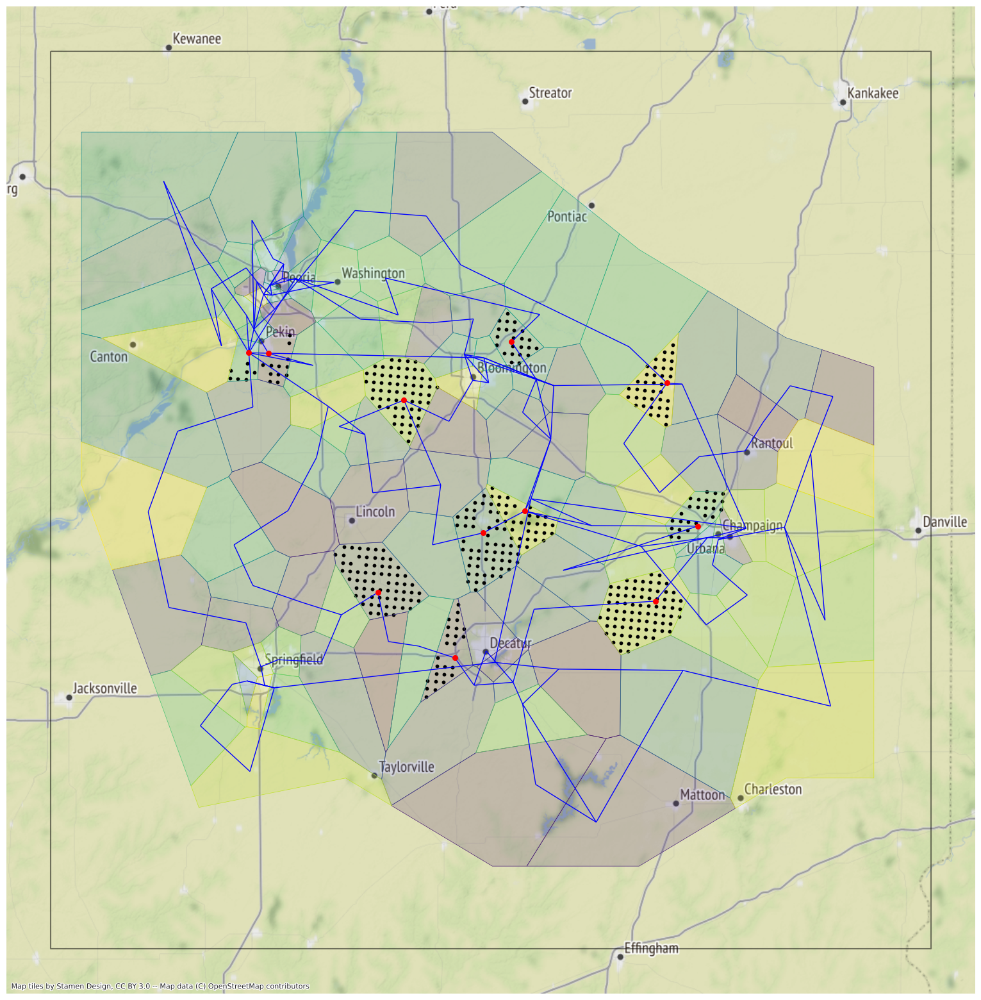

In [81]:
################################
##### plot vor_gdf (new way)
plt.figure()

ax = tamu_box_gdf.boundary.plot(figsize=(20, 20), alpha=0.5, edgecolor="k")

# ########## Voronoi polygons from vor_gdf
vor_gdf.plot(ax=ax, cmap="viridis", linewidth=0.5, alpha=0.2)
# ########## Voronoi polygons boundary only from vor_gdf
vor_gdf.boundary.plot(ax=ax, cmap="viridis", linewidth=0.5, alpha=1)

# # #bus_unique_gdf.plot(ax=ax, color="blue", markersize = 1)
# points_gdf.plot(ax=ax, color="blue", markersize = "size")

# bus_wind_unique_gdf.plot(ax=ax, color="red", markersize = 5)
br_gdf.plot(ax=ax, color="blue", linewidth=1)


############## selected sites
# selected_gdf.plot(ax=ax, color="white", markersize = 5)
selected_gdf.plot(ax=ax, color="black", markersize=10)

############## new wind gens
wind_gen_gdf.plot(ax=ax, color="red", markersize=30, zorder=4)

# ############# all wind gens (buses to which they are connected)
# s = vor_gdf["new_bus_num"] != 0
# connect_bus_nums = vor_gdf.loc[s[s].index,"connect_bus"].values
# bus_gdf.loc[connect_bus_nums].plot(ax=ax, color="red", markersize = 10)

# ################ verify vor_idx coresponds to pt_idx and
# ################ we match num_bus_list numbrs (also use bokeh plot for that)
# ### plot one specific polygon
# vor_idx=0
# vor_gdf.loc[vor_idx:vor_idx].plot(ax=ax, color="red", linewidth = 0.5, )
# ### plot one specific point location
# points_gdf.loc[vor_idx:vor_idx].plot(ax=ax, color="white", markersize = 50, zorder=5)


ctx.add_basemap(ax, source=ctx.providers.Stamen.Terrain)


### save figure
ax.set_axis_off()
filename = os.path.join(save_dir, "buildout_sites.png")
plt.savefig(filename, bbox_inches="tight", pad_inches=0)

[Voronoi](#voronoi)

* build
<a id='build'></a>

[end](#end)

<Figure size 640x480 with 0 Axes>

<AxesSubplot: >

<AxesSubplot: >

<Figure size 640x480 with 0 Axes>

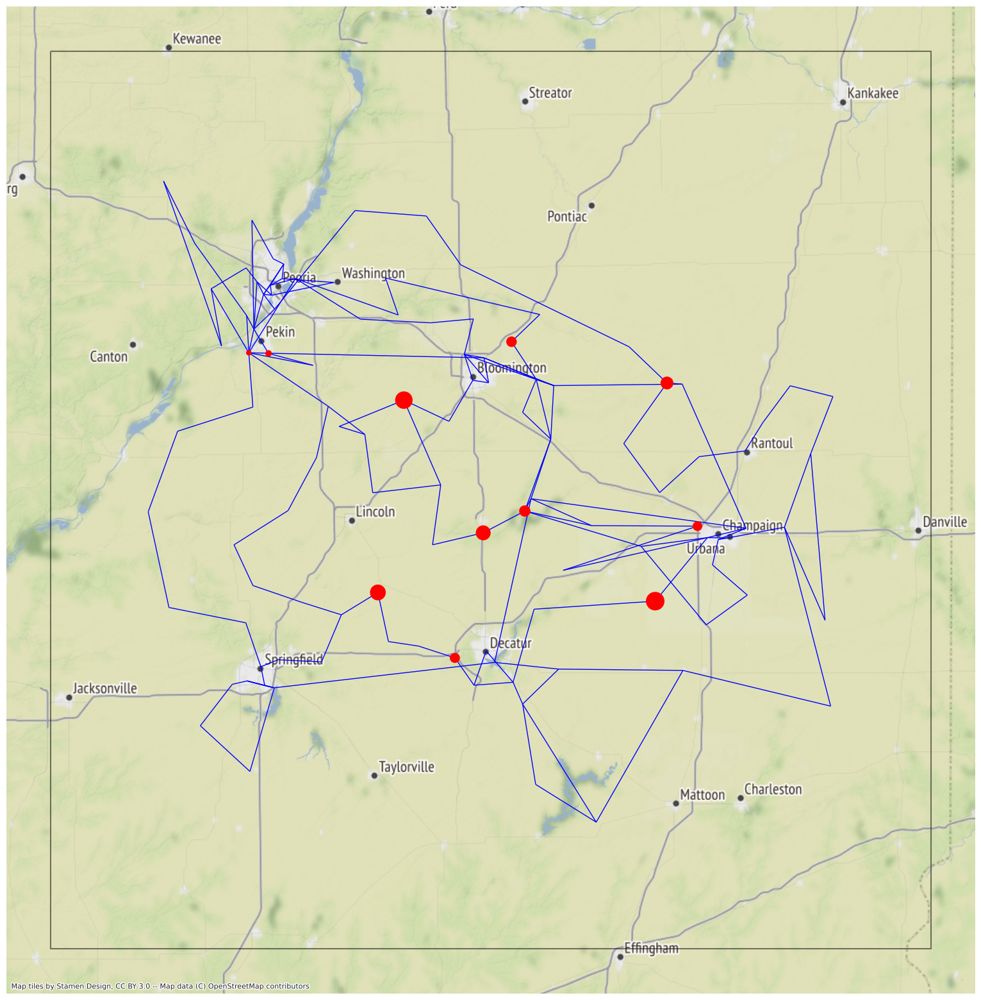

In [82]:
################################
##### plot vor_gdf (new way)
plt.figure()

ax = tamu_box_gdf.boundary.plot(figsize=(20, 20), alpha=0.5, edgecolor="k")

# # ########## Voronoi polygons from vor_gdf
# vor_gdf.plot(ax=ax, cmap="viridis", linewidth = 0.5, alpha = 0.2)
# # ########## Voronoi polygons boundary only from vor_gdf
# vor_gdf.boundary.plot(ax=ax, cmap="viridis", linewidth = 0.5, alpha = 1)

# # #bus_unique_gdf.plot(ax=ax, color="blue", markersize = 1)
# points_gdf.plot(ax=ax, color="blue", markersize = "size")

# bus_wind_unique_gdf.plot(ax=ax, color="red", markersize = 5)
br_gdf.plot(ax=ax, color="blue", linewidth=1)


# ############## selected sites
# selected_gdf.plot(ax=ax, color="white", markersize = 5)

############## new wind gens
wind_gen_gdf.plot(ax=ax, color="red", markersize="GenMWMax", zorder=4)


# ############# all wind gens (buses to which they are connected)
# s = vor_gdf["new_bus_num"] != 0
# connect_bus_nums = vor_gdf.loc[s[s].index,"connect_bus"].values
# bus_gdf.loc[connect_bus_nums].plot(ax=ax, color="red", markersize = 10)


# ################ verify vor_idx coresponds to pt_idx and
# ################ we match num_bus_list numbrs (also use bokeh plot for that)
# ### plot one specific polygon
# vor_idx=0
# vor_gdf.loc[vor_idx:vor_idx].plot(ax=ax, color="red", linewidth = 0.5, )
# ### plot one specific point location
# points_gdf.loc[vor_idx:vor_idx].plot(ax=ax, color="white", markersize = 50, zorder=5)


ctx.add_basemap(ax, source=ctx.providers.Stamen.Terrain)


### save figure
ax.set_axis_off()
filename = os.path.join(save_dir, "buildout_gens.png")
plt.savefig(filename, bbox_inches="tight", pad_inches=0)

In [83]:
#################################################
#### small example on removing and remapping

# branch_df
# brdf = branch_df.head().copy()
# brdf["FromBus"] = [2, 1, 3, 4, 4]
# brdf["ToBus"] = [1, 2, 1, 1, 3]
# brdf.drop(0, inplace=True)
# brdf.drop(1, inplace=True)
# brdf

# bdf = bus_df.head().copy()
# bdf.set_index("BusNum", inplace=True, drop=True)
# bdf
# bdf.drop(2, inplace=True)
# bdf["NewBusNum"] = range(1, len(bdf) + 1)
# # bdf.reset_index(inplace=True)
# # bdf.index = bdf.index + 1
# bdf

# ### old to new
# bmap = bdf["NewBusNum"]
# bmap
# ### reindex to new

# bdf.set_index("NewBusNum",inplace = True)
# bdf

In [84]:
# ################################################
# ### what are the transformers that connect gens?
# ### original wind gens are connected through a transformer
# ### with ration rateA/GenMWMax ~ 1.3
# ### so when connecting new wind gens, set rateA as ~1.3 of GenMWMax
# ### but have a min of rateA=20


# print("\n old wind generators")
# old_gen_df.loc[old_gen_df["GenFuelType"] == "Wind"]
# old_wind_gen_buses = old_gen_df.loc[old_gen_df["GenFuelType"] == "Wind"]["BusNum"]
# # print("\n wind generator buses:")
# # wind_gen_buses

# g_df = old_gen_df.loc[old_gen_df["GenFuelType"] == "Wind"]

# b_df = old_branch_df.loc[
#     (old_branch_df["FromBus"].isin(old_wind_gen_buses))
#     | (old_branch_df["ToBus"].isin(old_wind_gen_buses))
# ]
# print("\n old branches (transformers) connecting old wind generators:")
# b_df

# trans_df = b_df[["FromBus", "ToBus", "r", "x", "b", "rateA"]]
# trans_df["UID"] = trans_df.index
# df = trans_df.set_index("FromBus")
# df["GenMWMax"] = g_df.set_index("BusNum")["GenMWMax"]
# df["GenMWMin"] = g_df.set_index("BusNum")["GenMWMin"]
# trans_df = df
# trans_df["FromBus"] = trans_df.index
# trans_df = trans_df.set_index("UID")

# print("\n transformers connecting wind gens with gen min/max capacities:")
# # a = trans_df.columns[:-1].tolist()
# # b = trans_df.columns[-1:].tolist()
# # trans_df = trans_df[b + a]
# trans_df

# (trans_df["rateA"] / trans_df["GenMWMax"]).iplot(kind="bar", title="rateA/GenMWMax")

# aggregate reV time series: make actuals and scenarios datasets
* for scanario sampling with powerscenarios
* with sites selected can aggregate time series
* one year tamu200 run (tamu5 is 5-min) is 140 files x 424M each = 60.7G
* one year tamu2k run is 20 files x 7.1G = 140G (all sites)
* for reading one year of reV see tamu200_buildout_part1 notebook


In [85]:
selected_gdf

,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,gen_uid
gid,,,,,,,,,,,
1650753,0.445854,40.114800,-88.946840,42962.523,POINT (-9901516.936 4882638.753),0.499649,21466.171358,5.496136,1.387023,0,195_Wind_1
1650754,0.449380,40.133274,-88.944700,43302.280,POINT (-9901278.713 4885328.236),0.246198,10660.949762,2.708182,1.965448,0,195_Wind_1
1650752,0.448898,40.096330,-88.948975,43255.836,POINT (-9901754.604 4879950.583),0.368933,15958.496965,4.058261,2.914457,0,195_Wind_1
1648303,0.447230,40.136524,-88.993010,43095.074,POINT (-9906656.557 4885801.454),0.397233,17118.794217,4.369565,3.225812,0,195_Wind_1
...,...,...,...,...,...,...,...,...,...,...,...
1633580,0.457716,40.525270,-89.242160,44105.550,POINT (-9934391.808 4942569.270),0.444215,19592.341426,4.886364,11.007152,10,205_Wind_1
1629879,0.436466,40.474470,-89.321230,42057.844,POINT (-9943193.841 4935132.427),0.321002,13500.647428,3.531021,11.057663,10,205_Wind_1
1631114,0.446819,40.509900,-89.292850,43055.470,POINT (-9940034.593 4940318.591),0.432806,18634.679704,4.760870,11.586399,10,205_Wind_1
1629880,0.439160,40.492958,-89.319214,42317.450,POINT (-9942969.421 4937838.318),0.551653,23344.543698,6.068182,11.964527,10,205_Wind_1


In [ ]:
years = [2007, 2008, 2009, 2010, 2011, 2012, 2013]

base_dir = run_dir


field_name = "gen_profile"

all_years_df = pd.DataFrame()

for year in years:
    all_df = pd.DataFrame()
    # ## one year
    h5_file_list = glob.glob(os.path.join(base_dir, "*" + str(year) + "*.h5"))[:]

    for k, filename in enumerate(h5_file_list):
        print("\nk = {} of {} in year {}".format(k, len(h5_file_list), year))
        print("reading file:")
        filename
        #     if k==1:
        #         break
        with h5py.File(filename, "r") as f:
            meta = f.get("meta")
            meta_df = pd.DataFrame(meta[()])
            columns = meta_df["gid"]
            ### check if this file has any gids that are needed
            ### if not, continue onto next file
            if np.intersect1d(columns.values, selected_gdf.index.values).size == 0:
                print("\nno wanted gids in this file, continuing...")
                continue

            time_index = f.get("time_index")
            time_df = pd.DataFrame(time_index[()])
            time_index = pd.to_datetime(time_df[0].map(lambda x: str(x)[2:-1]))

            dataset = f.get(field_name)
            df = pd.DataFrame(dataset[()])

            df.columns = columns
            df.index = time_index

            # drop not used gids: gids that are not in selected_gdf
            drop_list = [x for x in columns if x not in selected_gdf.index]
            df.drop(drop_list, axis=1, inplace=True)

            ## concat on gids (columns)
            all_df = pd.concat([all_df, df], axis=1)

    ## concat on timestamp (index)
    all_years_df = pd.concat([all_years_df, all_df], axis=0)

all_years_df

In [87]:
print("\n all_years_df:")
all_years_df
# ### for tamu200 all_years_df is 1G (2.2G in csv format)
# ### might cause memory problems below
# ### save temporarily, delete after creating of the tables
# all_years_df.info()
# filename = "all_years_df.csv"
# print(f"\n {filename}")
# all_years_df.to_csv(os.path.join(save_dir, filename))


 all_years_df:


gid,1671493,1671494,1671495,1671496,1671497,1671498,1671499,1671500,1671523,1671524,1671525,1671526,1672708,1672709,1672710,...,1643375,1643376,1643377,1610151,1611382,1611383,1611384,1612614,1613846,1615076,1615077,1615078,1616308,1616309,1616310
0,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2007-01-01 00:00:00+00:00,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.0,9702.0,9702.0,9702.0,9702.000000,9702.000000,9702.000000,...,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000
2007-01-01 00:05:00+00:00,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.0,9702.0,9702.0,9702.0,9702.000000,9702.000000,9702.000000,...,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000
2007-01-01 00:10:00+00:00,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.0,9702.0,9702.0,9702.0,9702.000000,9702.000000,9702.000000,...,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000
2007-01-01 00:15:00+00:00,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.0,9702.0,9702.0,9702.0,9702.000000,9702.000000,9702.000000,...,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2013-12-31 23:40:00+00:00,695.924133,689.738342,605.885681,438.658325,309.825409,247.942307,201.026978,155.622421,0.0,0.0,0.0,0.0,648.630127,660.215515,660.537476,...,2423.411621,2301.561279,2182.126465,930.835205,957.268250,744.300964,609.325195,681.700928,492.528137,747.932007,600.099548,519.524475,696.618774,598.708923,538.554382
2013-12-31 23:45:00+00:00,682.581848,695.962708,660.256409,526.245667,376.717987,302.687592,265.873505,240.343124,0.0,0.0,0.0,0.0,676.345032,654.134155,665.299316,...,2513.007080,2422.409424,2290.911377,1015.989868,978.006958,788.151733,669.521606,681.700928,496.925842,747.186707,594.636536,519.524475,714.568848,604.168701,543.428650
2013-12-31 23:50:00+00:00,676.359741,676.351013,671.130554,583.907776,448.260284,363.742035,321.641693,287.777069,0.0,0.0,0.0,0.0,732.342651,665.005005,654.427063,...,2562.684814,2472.872559,2387.608887,1039.113770,957.268250,793.672424,713.002136,663.179626,487.143890,778.469543,589.173279,509.179962,764.596313,615.088074,543.428650
2013-12-31 23:55:00+00:00,719.913696,676.351013,664.928223,611.090149,496.260223,423.559662,389.178955,342.760468,0.0,0.0,0.0,0.0,839.415466,726.202026,665.299316,...,2640.759033,2498.901367,2397.050781,1007.030701,914.569336,762.358765,719.266479,641.298340,457.218781,828.829102,588.376160,494.525787,814.623474,625.336182,543.428650


In [88]:
all_df = all_years_df
all_df = all_df.reindex(sorted(all_df.columns), axis=1)
# multiply each gen timeseries by inclusion factor
all_df = all_df * selected_gdf["inclusion"]

# aggregate by bus
all_df = all_df.groupby(by=selected_gdf["gen_uid"], axis=1).sum()
all_df.index.name = "timestamp"
# to magawatts
all_df = all_df * 1e-3
wind_df = all_df
wind_df

gen_uid,195_Wind_1,196_Wind_1,197_Wind_1,198_Wind_1,199_Wind_1,200_Wind_1,201_Wind_1,202_Wind_1,203_Wind_1,204_Wind_1,205_Wind_1
timestamp,,,,,,,,,,,
2007-01-01 00:00:00+00:00,217.584117,347.227705,121.070702,85.262791,92.959926,34.002320,103.018439,23.389559,158.889557,247.553103,304.967910
2007-01-01 00:05:00+00:00,217.584117,347.227705,121.070702,85.262791,92.959926,34.002320,103.018439,23.389559,158.889557,247.553103,304.967910
2007-01-01 00:10:00+00:00,217.584117,347.227705,121.070702,85.262791,92.959926,34.002320,103.018439,23.389559,158.889557,247.553103,304.967910
2007-01-01 00:15:00+00:00,217.584117,347.227705,121.070702,85.262791,92.959926,34.002320,103.018439,23.389559,158.889557,247.553103,304.967910
...,...,...,...,...,...,...,...,...,...,...,...
2013-12-31 23:40:00+00:00,10.165572,11.397428,4.497230,0.000000,17.977260,1.898777,0.000000,1.878910,0.000000,23.498138,3.947061
2013-12-31 23:45:00+00:00,10.684261,12.780515,4.767644,0.000000,18.898106,1.936852,0.000000,2.017227,0.000000,25.969666,4.849560
2013-12-31 23:50:00+00:00,11.306690,13.889408,5.007056,0.000000,19.654217,1.994879,0.000000,2.085517,0.000000,28.599093,5.575910
2013-12-31 23:55:00+00:00,11.950812,15.099643,5.274732,0.000000,20.230763,2.049842,0.000000,2.068762,0.000000,31.704980,6.162342


In [89]:
print("\nany na's in wind_df?")
wind_df.isna().any().any()
print("\nmin value of wind_df:")
wind_df.min().min()
print("\nmax value of wind_df:")
wind_df.max().max()


any na's in wind_df?


False


min value of wind_df:


0.0


max value of wind_df:


347.22770467434265

## save/load
* aggregated wind timeseries
* just need to be split into actuals and scenarios df

In [ ]:
#### save
filename = "wind_df.csv"
wind_df.to_csv(os.path.join(save_dir, filename))

#### remember to delete all_years_df as it is not needed and takes a lot of place

### continue ...
* start with wind_df, and create .h5 tables to use in powerscenarios

In [91]:
save_dir

'/projects/exasgd/isatkaus/buildout/wind/wind_gen_tamu5/buildouts/work-dir/option2_seed2-ngens11-pen86'

In [92]:
buildout_dir = save_dir
buildout_dir

'/projects/exasgd/isatkaus/buildout/wind/wind_gen_tamu5/buildouts/work-dir/option2_seed2-ngens11-pen86'

In [ ]:
# ###################################################################
# #### uncomment if started with continue 4
# #### read saved files

# filename = "gen_df.csv"
# gen_df = pd.read_csv(os.path.join(buildout_dir, filename), index_col=0)
# print("\ngen_df:")
# gen_df

# filename = "wind_gen_df.csv"
# wind_gen_df = pd.read_csv(os.path.join(buildout_dir, filename), index_col=0)
# print("\nwind_gen_df:")
# wind_gen_df

# print("\n total wind capacity for buildout {}".format(nameplate_factor))
# wind_gen_df["GenMWMax"].sum()


# ###
# filename = "wind_df.csv"
# wind_df = pd.read_csv(os.path.join(buildout_dir, filename), index_col=0, parse_dates=True)

# print("\nwind_df:")
# wind_df

# #### load wind_gen_location_gdf (similar to vor_gdf, except geometry contains points)
# filename = "selected_gdf.csv"
# selected_df = pd.read_csv(os.path.join(buildout_dir, filename), index_col=0)
# # vor_df

# selected_gdf = gpd.GeoDataFrame(
#     selected_df,
#     crs="epsg:3857",
#     geometry=[
#         shapely.wkt.loads(selected_df.loc[location_idx, "geometry"])
#         for location_idx in selected_df.index
#     ],
# )

# print("\nselected_gdf:")
# selected_gdf

## sanity check

In [ ]:
### wind_df
start = pd.Timestamp("2007-07-01 00:00:00+00:00")
end = pd.Timestamp("2007-07-03 00:00:00+00:00")
wind_df.loc[start:end].sum(axis=1).iplot(
    title="Total wind power on the grid", yTitle="MW"
)

In [95]:
# ###### print("\n\nEXACTLY MAX POWER:")
# ### exactly maxes
# for wind_farm in wind_df.max().index:
#     print(wind_farm)
#     maxes_s = wind_df.loc[wind_df[wind_farm] == wind_df.max().loc[wind_farm]]

#     print(
#         "wind farm {} run at its max power {} fraction of the time ".format(
#             wind_farm, round(len(maxes_s) / len(wind_df), 4)
#         )
#     )

# print("\n\nALMOST MAX POWER:")
# ### almost maxes

# ### tolerance in MW
# tol = 1
# ### tolerance in % of nameplate
# nameplate = wind_gen_df.loc[wind_gen_df["GenUID"] == wind_gen, "GenMWMax"].values[0]
# tol = nameplate * 0.05

# for wind_farm in wind_df.max().index:
#     print(wind_farm)
#     almost_maxes_s = wind_df[wind_farm].loc[
#         abs(wind_df[wind_farm] - wind_df.max().loc[wind_farm]) < tol
#     ]

#     print(
#         "wind farm {} run at its almost (within {}MW) max power {} fraction of the time ".format(
#             wind_farm, round(tol, 2), round(len(almost_maxes_s) / len(wind_df), 4)
#         )
#     )

# create .h5 tables for use in scenario sampling

* create tbales needed to instantiate Grid in powerscenarios:
* wind_sites_df, actuals_df, scenarios_df
* selected_gdf -> wind_sites_df
* wind_df -> actuals_df and scenarios_df
* NOTE: grid.wind_sites is not necessarily needed if we already have grid.actuals and grid.scenarios

In [96]:
save_dir

'/projects/exasgd/isatkaus/buildout/wind/wind_gen_tamu5/buildouts/work-dir/option2_seed2-ngens11-pen86'

In [97]:
### save_tables_dir == buildout_dir

#### save tables
save_tables_dir = os.path.join(save_dir, "tables-data")

if not os.path.exists(save_tables_dir):
    os.makedirs(save_tables_dir)

In [98]:
# # ## save after retrieve_wind_sites and make_tables
# save_dir = "/Users/isatkaus/projects/ecp/public-github/powerscenarios/data/tables-data/m-file-Pmax/"

# filename = "{}_wind_sites_df.h5".format(grid_name)
# grid.wind_sites.to_hdf(os.path.join(save_dir,filename),'MW',  mode='w')
# filename = "{}_actuals_df.h5".format(grid_name)
# grid.actuals.to_hdf(os.path.join(save_dir,filename),'MW',  mode='w')
# filename = "{}_scenarios_df.h5".format(grid_name)
# grid.scenarios.to_hdf(os.path.join(save_dir,filename),'MW',  mode='w')

In [99]:
gen_df

,BusNum,GenID,GenMWMax,GenMWMin,GenWindPowerFactor,GenFuelType,GenUID,BusName,Latitude,Longitude,Zone
0,49,1,4.530000,1.360000,1.0,Coal,49_Coal_1,RANTOUL21,40.312222,-88.159444,6
1,50,1,4.530000,1.360000,1.0,Coal,50_Coal_1,RANTOUL22,40.312222,-88.159444,6
2,51,1,4.530000,1.360000,1.0,Coal,51_Coal_1,RANTOUL23,40.312222,-88.159444,6
3,52,1,4.530000,1.360000,1.0,Coal,52_Coal_1,RANTOUL24,40.312222,-88.159444,6
...,...,...,...,...,...,...,...,...,...,...,...
39,177,1,26.600000,7.980000,1.0,Coal,183_Coal_1,SPRINGFIELD22,39.806868,-89.641653,4
40,183,1,569.150019,170.749998,1.0,Nuclear,189_Nuclear_1,CLINTON12,40.171900,-88.833900,7
41,190,1,67.500001,20.250000,1.0,NaturalGas,196_NaturalGas_1,GIBSONCITY11,40.470500,-88.398700,6
42,191,1,67.500001,20.250000,1.0,NaturalGas,197_NaturalGas_1,GIBSONCITY12,40.470500,-88.398700,6


# ACTIVSg200_m_gen.csv (can skip next few cells)
* next 4 commented out cells are not needed
* for Julia use create: ACTIVSg200_m_gen.csv from original case_ACTIVSg200.m (parsed by Grid.Parser). i.e. modify existing gen capacities
* TODO: for buildouts with creation of new gens: this step should include adding gens
* TODO: for Exago use create: case_ACTIVSg200.m 

In [100]:
# ### first parse case_ACTIVSg200.m
# parser = Parser()

# filename = "/home/isatkaus/projects/ecp/powerscenarios/data/grid-data/ACTIVSg200/case_ACTIVSg200.m"

# # read gen table from case_m_file
# table_name = "mpc.gen"
# column_names = [
#     "bus",
#     "Pg",
#     "Qg",
#     "Qmax",
#     "Qmin",
#     "Vg",
#     "mBase",
#     "status",
#     "Pmax",
#     "Pmin",
#     "Pc1",
#     "Pc2",
#     "Qc1min",
#     "Qc1max",
#     "Qc2min",
#     "Qc2max",
#     "ramp_agc",
#     "ramp_10",
#     "ramp_30",
#     "ramp_q",
#     "apf",
#     "mu_Pmax",
#     "mu_Pmin",
#     "mu_Qmax",
#     "mu_Qmin",
# ]
# # this table is entirely numeric
# numeric_columns = column_names

# m_gen_df = parser.read_m_table(
#     filename,
#     table_name=table_name,
#     column_names=column_names,
#     numeric_columns=numeric_columns,
# )


# # read gentype and genfuel series and add it to m_gen_df
# gentype_s = parser.read_m_series(filename, series_name="mpc.gentype")
# genfuel_s = parser.read_m_series(filename, series_name="mpc.genfuel")
# m_gen_df["type"] = gentype_s
# m_gen_df["fuel"] = genfuel_s

# m_gen_df

# # read gencost table and add cost coeficients to gen table
# # contains only quadratic polynomial cost coefficients, and no startup or shutdown costs
# table_name = "mpc.gencost"
# column_names = [
#     "model",
#     "startup",
#     "shutdown",
#     "ncost",
#     "c2",
#     "c1",
#     "c0",
# ]

# # this table is entirely numeric
# numeric_columns = column_names

# gencost_df = parser.read_m_table(
#     filename,
#     table_name=table_name,
#     column_names=column_names,
#     numeric_columns=numeric_columns,
# )
# gencost_df

# # add cost coefficients to gen table
# m_gen_df["ncost"] = gencost_df["ncost"]  # degree of polynomial
# m_gen_df["cost_c0"] = gencost_df["c0"]
# m_gen_df["cost_c1"] = gencost_df["c1"]
# m_gen_df["cost_c2"] = gencost_df["c2"]

# m_gen_df

In [101]:
# ### modify for testing purposes (will need that in tamu2k)
# wind_gen_df.loc[6] = wind_gen_df.loc[5]
# wind_gen_df.loc[6, "GenID"] = 2
# wind_gen_df.loc[6, "GenMWMax"] = 500
# wind_gen_df

# m_gen_df.loc[m_gen_df["bus"] == 147]
# m_gen_df.loc[30]
# m_gen_df.loc[49] = m_gen_df.loc[30]
# m_gen_df

In [ ]:
# ### modify m_gen_df according to gen_df (or wind_gen_df)

# for idx in wind_gen_df.index[:]:
#     bus_num = wind_gen_df.loc[idx,"BusNum"]
#     #bus_num = 147
#     print("\n bus_num = {}".format(bus_num))
#     #gen_id = wind_gen_df.loc[idx,"GenID"]
#     ### at one bus_num there might be more than one wind gen
#     modified_gens_at_bus_df = wind_gen_df.loc[wind_gen_df["BusNum"]==bus_num].copy()
#     existing_gens_at_bus_df = m_gen_df.loc[m_gen_df["bus"]==bus_num]
#     print("\n modified_gens_at_bus_df")
#     modified_gens_at_bus_df
#     print("\n existing_gens_at_bus_df")
#     existing_gens_at_bus_df
#     ### sanity check:
#     if len(modified_gens_at_bus_df) != len(existing_gens_at_bus_df):
#         raise ValueError("len(modified_gens_at_bus_df) != len(existing_gens_at_bus_df) at bus {}. Investigate!!".format(bus_num))

#     for i in range(len(modified_gens_at_bus_df)):
#         modified_cap = modified_gens_at_bus_df.iloc[i]["GenMWMax"]
#         modified_cap
#         print("\n  modified_cap = {}".format(modified_cap))
#         existing_gen_idx = existing_gens_at_bus_df.iloc[i].name
#         existing_gen_idx
#         print("\n  existing_gen_idx = {}".format(existing_gen_idx))
#         ## modify existing gen capacity
#         print("\n modifying gen cap at bus {} with new value {}".format(bus_num,modified_cap))
#         m_gen_df.loc[existing_gen_idx,"Pmax"] = modified_cap
#         m_gen_df.loc[existing_gen_idx:existing_gen_idx]

## check and save

In [ ]:
# ################
# ### sanity check
# ################
# m_gen_df.loc[m_gen_df["fuel"] == "wind"]
# wind_gen_df
# m_gen_df.set_index("bus").loc[m_gen_df.set_index("bus")["fuel"] == "wind","Pmax"]
# wind_gen_df.set_index("BusNum")["GenMWMax"]
# print("\n all capacities modified correctly?")
# ((m_gen_df.set_index("bus").loc[m_gen_df.set_index("bus")["fuel"] == "wind","Pmax"] - wind_gen_df.set_index("BusNum")["GenMWMax"])
# ==0).all()

# ################
# ### save as csv
# ################
# filename = "{}_m_gen.csv".format(grid_name)
# print("\nsaving m_gen_df to: {}".format(os.path.join(buildout_dir, filename)))
# m_gen_df.to_csv(os.path.join(buildout_dir, filename))

## wind_sites_df
* create and save in .csv and .h5 formats

In [104]:
grid.wind_sites

,SiteID,Capacity,Point,Latitude,Longitude,BusNum,GenUID
0,54007,16.0,POINT (-88.02514600000001 40.458515),40.458515,-88.025146,65,65_Wind_1
1,54196,16.0,POINT (-88.02273599999999 40.476978),40.476978,-88.022736,65,65_Wind_1
2,54008,16.0,POINT (-88.000885 40.456665),40.456665,-88.000885,65,65_Wind_1
3,53833,16.0,POINT (-88.02758799999999 40.440052),40.440052,-88.027588,65,65_Wind_1
...,...,...,...,...,...,...,...
46,51597,16.0,POINT (-89.412201 40.312679),40.312679,-89.412201,147,147_Wind_1
47,51598,16.0,POINT (-89.38797 40.311146),40.311146,-89.387970,147,147_Wind_1
48,51599,16.0,POINT (-89.363708 40.30962),40.309620,-89.363708,147,147_Wind_1
49,51429,16.0,POINT (-89.414215 40.294193),40.294193,-89.414215,147,147_Wind_1


In [105]:
gdf = selected_gdf.copy()

## turn to lat/lon crs
gdf = gdf.to_crs(epsg=4326)

## turn to pd.DataFrame first, GeoDataFrame causes problems with saving as .h5
## change geometry type to object type (i.e. string)
df = pd.DataFrame(gdf)
df["geometry"] = df["geometry"].astype("str")


df["BusNum"] = df["gen_uid"].str.split("_", expand=True)[0]

df.reset_index(inplace=True)

## rename columns to be similar to grid.wind_sites convention
## NOTE it will be different: SiteID only works for TE data set; and GID is for full toolkit only
df.rename(
    columns={
        "gid": "GID",
        "cf_mean": "CF",
        "latitude": "Latitude",
        "longitude": "Longitude",
        "generation_mwh": "GenerationMWh",
        "geometry": "Point",
        "inclusion": "Inclusion",
        "capacity_mw": "CapacityMW",
        "gen_uid": "GenUID",
    },
    inplace=True,
)


## save as csv
filename = "{}_wind_sites_df.csv".format(grid_name)
print("\nsaving wind_sites_df to: {}".format(os.path.join(save_tables_dir, filename)))
pd.DataFrame(df).to_csv(os.path.join(save_tables_dir, filename))

### save as .h5 (turn to pd.DataFrame first, GeoDataFrame causes problems)
filename = "{}_wind_sites_df.h5".format(grid_name)
print("\nsaving wind_sites_df to: {}".format(os.path.join(save_tables_dir, filename)))
pd.DataFrame(df).to_hdf(os.path.join(save_tables_dir, filename), "MW", mode="w")

df


saving wind_sites_df to: /projects/exasgd/isatkaus/buildout/wind/wind_gen_tamu5/buildouts/work-dir/option2_seed2-ngens11-pen86/tables-data/ACTIVSg200_wind_sites_df.csv

saving wind_sites_df to: /projects/exasgd/isatkaus/buildout/wind/wind_gen_tamu5/buildouts/work-dir/option2_seed2-ngens11-pen86/tables-data/ACTIVSg200_wind_sites_df.h5


,GID,CF,Latitude,Longitude,GenerationMWh,Point,Inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,GenUID,BusNum
0,1650753,0.445854,40.114800,-88.946840,42962.523,POINT (-88.94684 40.1148),0.499649,21466.171358,5.496136,1.387023,0,195_Wind_1,195
1,1650754,0.449380,40.133274,-88.944700,43302.280,POINT (-88.9447 40.133274),0.246198,10660.949762,2.708182,1.965448,0,195_Wind_1,195
2,1650752,0.448898,40.096330,-88.948975,43255.836,POINT (-88.948975 40.09633),0.368933,15958.496965,4.058261,2.914457,0,195_Wind_1,195
3,1648303,0.447230,40.136524,-88.993010,43095.074,POINT (-88.99301 40.136524),0.397233,17118.794217,4.369565,3.225812,0,195_Wind_1,195
...,...,...,...,...,...,...,...,...,...,...,...,...,...
418,1633580,0.457716,40.525270,-89.242160,44105.550,POINT (-89.24216 40.52527),0.444215,19592.341426,4.886364,11.007152,10,205_Wind_1,205
419,1629879,0.436466,40.474470,-89.321230,42057.844,POINT (-89.32123 40.47447),0.321002,13500.647428,3.531021,11.057663,10,205_Wind_1,205
420,1631114,0.446819,40.509900,-89.292850,43055.470,POINT (-89.29285 40.5099),0.432806,18634.679704,4.760870,11.586399,10,205_Wind_1,205
421,1629880,0.439160,40.492958,-89.319214,42317.450,POINT (-89.319214 40.492958),0.551653,23344.543698,6.068182,11.964527,10,205_Wind_1,205


## actuals_df
* create and save in .csv and .h5 formats

In [106]:
### original actuals
grid.actuals

,65_Wind_1,104_Wind_1,105_Wind_1,114_Wind_1,115_Wind_1,147_Wind_1,TotalPower
IssueTime,,,,,,,
2020-01-01 00:00:00+00:00,142.094736,99.000001,198.000002,1.7,150.000000,100.500000,691.294739
2020-01-01 00:05:00+00:00,140.804726,99.000001,198.000002,1.7,150.000000,100.500000,690.004728
2020-01-01 00:10:00+00:00,142.361249,99.000001,198.000002,1.7,150.000000,100.500000,691.561251
2020-01-01 00:15:00+00:00,145.972502,99.000001,198.000002,1.7,150.000000,100.500000,695.172504
...,...,...,...,...,...,...,...
2020-12-31 23:40:00+00:00,0.060166,15.138214,24.662171,1.7,32.497064,21.473197,95.530814
2020-12-31 23:45:00+00:00,0.195194,15.827590,27.014071,1.7,32.212875,24.861496,101.811227
2020-12-31 23:50:00+00:00,0.397398,16.547275,29.256746,1.7,29.996480,27.771966,105.669866
2020-12-31 23:55:00+00:00,0.575895,17.458859,31.337020,1.7,25.093633,30.581562,106.746968


In [107]:
### create actuals df
df = wind_df.loc[wind_df.index.year == 2007].copy()

df.columns.name = None
df.index.name = "IssueTime"

max_gen_s = wind_gen_df[["GenMWMax", "GenUID"]].set_index("GenUID")["GenMWMax"]
print("\n max_gen_s:")
max_gen_s
## check for if actuals are always < GenMWMax, else replace with GenMWMax
print("\ncheck if actuals are always < GenMWMax, else replace with GenMWMax:")
df.where(df.lt(max_gen_s), other=max_gen_s, axis=1, inplace=True)

print("\nadding TotalPower column, since grid actuals require it")
df["TotalPower"] = df.sum(axis=1)


# ## save as .csv
filename = "{}_actuals_df.csv".format(grid_name)
print("\nsaving actuals_df to: {}".format(os.path.join(save_tables_dir, filename)))
df.to_csv(os.path.join(save_tables_dir, filename))


### save as .h5
filename = "{}_actuals_df.h5".format(grid_name)
df.to_hdf(os.path.join(save_tables_dir, filename), "MW", mode="w")

df


 max_gen_s:


GenUID
195_Wind_1    246.694011
196_Wind_1    393.682205
197_Wind_1    137.268369
198_Wind_1     96.669832
                 ...    
202_Wind_1     26.518775
203_Wind_1    180.146889
204_Wind_1    280.672452
205_Wind_1    345.768605
Name: GenMWMax, Length: 11, dtype: float64


check if actuals are always < GenMWMax, else replace with GenMWMax:

adding TotalPower column, since grid actuals require it

saving actuals_df to: /projects/exasgd/isatkaus/buildout/wind/wind_gen_tamu5/buildouts/work-dir/option2_seed2-ngens11-pen86/tables-data/ACTIVSg200_actuals_df.csv


,195_Wind_1,196_Wind_1,197_Wind_1,198_Wind_1,199_Wind_1,200_Wind_1,201_Wind_1,202_Wind_1,203_Wind_1,204_Wind_1,205_Wind_1,TotalPower
IssueTime,,,,,,,,,,,,
2007-01-01 00:00:00+00:00,217.584117,347.227705,121.070702,85.262791,92.959926,34.002320,103.018439,23.389559,158.889557,247.553103,304.967910,1735.926128
2007-01-01 00:05:00+00:00,217.584117,347.227705,121.070702,85.262791,92.959926,34.002320,103.018439,23.389559,158.889557,247.553103,304.967910,1735.926128
2007-01-01 00:10:00+00:00,217.584117,347.227705,121.070702,85.262791,92.959926,34.002320,103.018439,23.389559,158.889557,247.553103,304.967910,1735.926128
2007-01-01 00:15:00+00:00,217.584117,347.227705,121.070702,85.262791,92.959926,34.002320,103.018439,23.389559,158.889557,247.553103,304.967910,1735.926128
...,...,...,...,...,...,...,...,...,...,...,...,...
2007-12-31 23:40:00+00:00,68.978565,63.424521,20.765166,7.646245,54.713649,7.086372,20.191300,4.375933,2.906384,128.813130,80.517346,459.418612
2007-12-31 23:45:00+00:00,82.440442,70.622454,27.900638,8.195453,56.915432,7.824273,21.932586,5.510616,6.692918,133.416951,76.106500,497.558264
2007-12-31 23:50:00+00:00,95.593953,73.881558,34.923500,8.574542,62.627359,8.832487,23.923756,6.978934,10.666143,136.565217,75.099766,537.667216
2007-12-31 23:55:00+00:00,109.064920,75.099204,41.187043,8.947163,68.094348,10.010057,25.557890,8.823593,14.022194,140.869846,79.558950,581.235210


## scenarios_df
* create and save in .csv and .h5 formats
* NOTE: leap years are not right still 2008 and 2012 are missing entire day of Dec31


In [108]:
### check leap years missing timestamps
print("\n If Key errors - leap years are not fixed in reV runs:")
t1 = pd.Timestamp("2008-12-31 12:00:00+00:00")
try:
    all_df.loc[t1]
except KeyError as e:
    print(f"\n I got a KeyError - reason {str(e)}")


t2 = pd.Timestamp("2012-12-31 12:00:00+00:00")
try:
    all_df.loc[t2]
except KeyError as e:
    print(f"\n I got a KeyError - reason {str(e)}")


 If Key errors - leap years are not fixed in reV runs:

 I got a KeyError - reason Timestamp('2008-12-31 12:00:00+0000', tz='UTC')

 I got a KeyError - reason Timestamp('2012-12-31 12:00:00+0000', tz='UTC')


In [ ]:
### create scenarios df
df = wind_df.loc[wind_df.index.year != 2007].copy()

df.columns.name = None
df.index.name = "IssueTime"


### don't think we need to
# print("\ncheck if scenarios are always < GenMWMax, else replace with GenMWMax:")
# df.where(df.lt(max_gen_s), other=max_gen_s, axis=1, inplace=True)


# add total power column (accross all generators)
df["TotalPower"] = df.sum(axis=1).values

# compute deviations
# i.e. make error calculations (instead of full power at each bus, have deviations from persistence)

# deviations from persistence at generators
gen_deviations_array = df.iloc[1:, :-1].values - df.iloc[:-1, :-1].values
# total power deviations
total_power_deviations_array = (
    df["TotalPower"].values[1:] - df["TotalPower"].values[:-1]
)
# drop last row
df.drop(df.tail(1).index, inplace=True)

# record deviations
df.iloc[:, :-1] = gen_deviations_array
df["Deviation"] = total_power_deviations_array


## drop 2 timestamps in grid.scenarios deviations:
## 2008-12-30 23:55:00 and 2012-12-30 23:55:00
df.drop(pd.Timestamp("2008-12-30 23:55:00+0000", tz="UTC"), inplace=True)
df.drop(pd.Timestamp("2012-12-30 23:55:00+0000", tz="UTC"), inplace=True)


# ## save as .csv
filename = "{}_scenarios_df.csv".format(grid_name)
print("\nsaving scenarios_df to: {}".format(os.path.join(save_tables_dir, filename)))
df.to_csv(os.path.join(save_tables_dir, filename))


### save as .h5
filename = "{}_scenarios_df.h5".format(grid_name)
print("\nsaving scenarios_df to: {}".format(os.path.join(save_tables_dir, filename)))
df.to_hdf(os.path.join(save_tables_dir, filename), "MW", mode="w")

df

In [ ]:
#### large negative outlier -627 seems suspicious (prior to fixing for leap years)

print("\n sanity checks: look out for very large negative total deviations")

print("\n Total capacity:")
wind_gen_df["GenMWMax"].sum()

print("\n total wind capacity on the grid:")
wind_gen_df["GenMWMax"].sum()


print("\n 5 maximum total Deviation's")
df.nlargest(5, "Deviation")["Deviation"]

print("\n 5 minimum total Deviation's")
df.nsmallest(5, "Deviation")["Deviation"]

# Proceed to generate scenarios using generated tables:
* use buildout_scenarios_v2.ipynb
* other ipynbs: local notebook or notebook on Eagle
* MAC: ~/projects/ecp/public-github/powerscenarios/notebooks/dev/buildouts/buildout_scenarios_v2.ipynb
* Jhub: /home/isatkaus/projects/ecp/powerscenarios/notebooks/eagle_dev/buildout_scenarios_v2.ipynb

In [111]:
save_dir

'/projects/exasgd/isatkaus/buildout/wind/wind_gen_tamu5/buildouts/work-dir/option2_seed2-ngens11-pen86'

# Scratch

## dealing with leap years
* problem when running ReV for 2008, the last timestamp is 2008-12-30 23:55:00, i.e., because there was Feb 29th, the Dec 31st has been cut (ReV people's explanation: apparently SAM can't do 366 days, only 365)
* solution drop 2 timestamps in grid.scenarios deviations: 2008-12-30 23:55:00 and 2012-12-30 23:55:00, because 